## import

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import itertools
from copy import deepcopy

amplifyのインストール

In [ ]:
!pip install amplify

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 30.7 MB/s eta 0:00:00


In [ ]:
import amplify

In [ ]:
from amplify import BinaryPoly, gen_symbols,sum_poly, decode_solution
from amplify import Solver
from amplify.client import FixstarsClient

## 問題設定
粘性ありL字流路（壁側に粘性あり）

備忘録：有限要素法による流体シミュレーションのルーティン  
1.データ作成  
2.要素マトリックスを求める  
3.全体マトリックスの作成  
4.境界条件の付与  
5.連立方程式を解く  

In [ ]:
!ls

sample_data


In [ ]:
p_df = pd.read_csv('./sample_data/Lshape_mostsimple_p_mat_4.csv', header=None)
e_df = pd.read_csv('./sample_data/Lshape_mostsimple_e_mat_4.csv', header=None)
t_df = pd.read_csv('./sample_data/Lshape_mostsimple_t_mat_4.csv', header=None)

p_mat = p_df.to_numpy()
e_mat = e_df.to_numpy()
t_mat = t_df.to_numpy()

In [ ]:
t_bound1 = [ temp_e[:2] for temp_e in e_mat.T]
t_bound2 = [t for t in t_bound1 if (p_mat[0,int(t[0]-1)]!=0) or (p_mat[0,int(t[1]-1)]!=0) or (0<=min(p_mat[1,int(t[0]-1)],p_mat[1,int(t[1]-1)])) ]
boundary_label = [t for t in t_bound2 if (p_mat[1,int(t[0]-1)]!=0) or (p_mat[1,int(t[1]-1)]!=0) or (0>=max(p_mat[0,int(t[0]-1)],p_mat[0,int(t[1]-1)])) ]
print(len(boundary_label))
in_bound = [ t for t in t_bound1 if (p_mat[1,int(t[0]-1)] == 1) & (p_mat[1,int(t[1]-1)] == 1) ]
out_bound = [ t for t in t_bound1 if (p_mat[0,int(t[0]-1)] == -1) & (p_mat[0,int(t[1]-1)] == -1) ]
in_bound_label = np.unique(np.array(in_bound).reshape(-1,))
out_bound_label = np.unique(np.array(out_bound).reshape(-1,))

64


In [ ]:
boundary_up = [t for t in boundary_label if (p_mat[1,int(t[0]-1)]>=-0) and (p_mat[0,int(t[0]-1)]<=0) and (p_mat[1,int(t[1]-1)]>=-0) and (p_mat[0,int(t[1]-1)]<=0)]
boundary_down = [t for t in boundary_label if (p_mat[1,int(t[0]-1)]==-1 and p_mat[1,int(t[1]-1)]==-1) or (p_mat[0,int(t[0]-1)]==1 and p_mat[0,int(t[1]-1)]==1)]
bound_up_label = np.unique(np.array(boundary_up).reshape(-1,))
bound_down_label = np.unique(np.array(boundary_down).reshape(-1,))

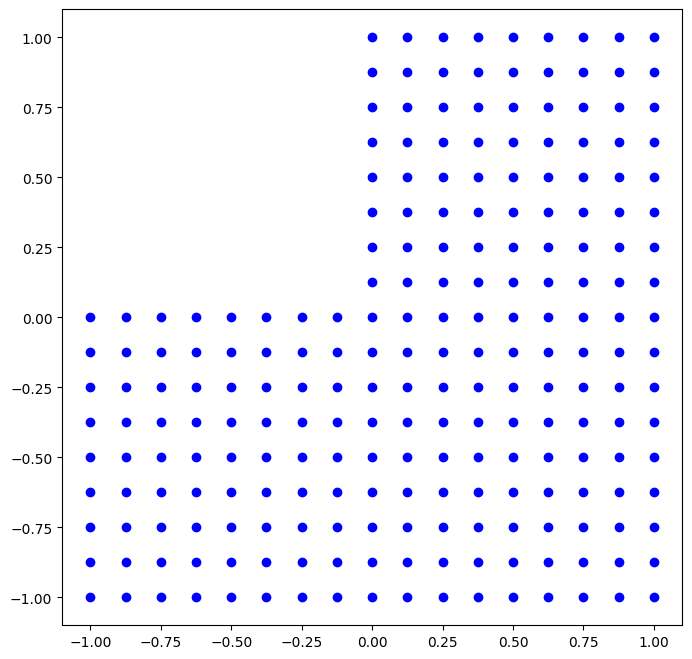

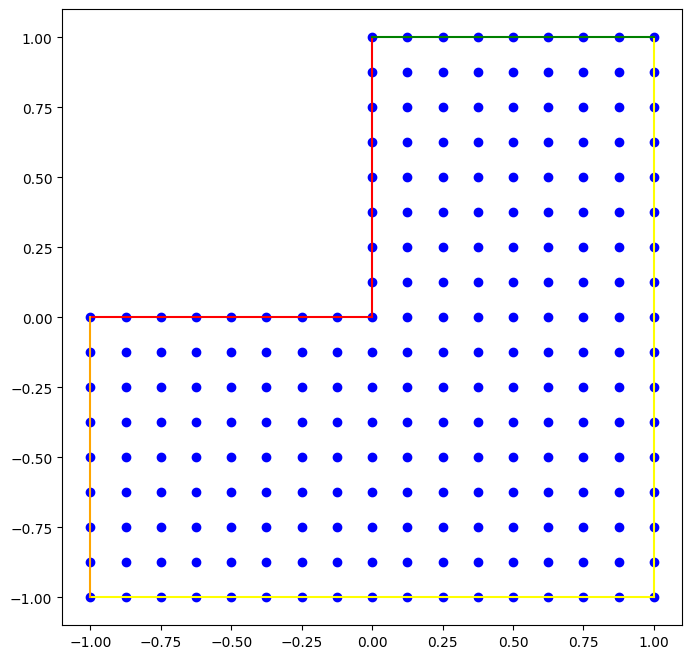

In [ ]:
plt.figure(figsize=(8,8))
for (tx,ty) in p_mat.T:
  plt.scatter(tx,ty,color='blue')
plt.show()

plt.figure(figsize=(8,8))
for (tx,ty) in p_mat.T:
  plt.scatter(tx,ty,color='blue')
### boundary up (red)
for temp_e in boundary_up:
  plt.plot([p_mat[0,int(temp_e[0]-1)],p_mat[0,int(temp_e[1]-1)]],[p_mat[1,int(temp_e[0]-1)],p_mat[1,int(temp_e[1]-1)]],color='red')
### boundary down (yellow)
for temp_e in boundary_down:
  plt.plot([p_mat[0,int(temp_e[0]-1)],p_mat[0,int(temp_e[1]-1)]],[p_mat[1,int(temp_e[0]-1)],p_mat[1,int(temp_e[1]-1)]],color='yellow')
### input boundary (green)
for temp_e in in_bound:
  plt.plot([p_mat[0,int(temp_e[0]-1)],p_mat[0,int(temp_e[1]-1)]],[p_mat[1,int(temp_e[0]-1)],p_mat[1,int(temp_e[1]-1)]],color='green')
### output boundary (orange)
for temp_e in out_bound:
  plt.plot([p_mat[0,int(temp_e[0]-1)],p_mat[0,int(temp_e[1]-1)]],[p_mat[1,int(temp_e[0]-1)],p_mat[1,int(temp_e[1]-1)]],color='orange')

plt.show()


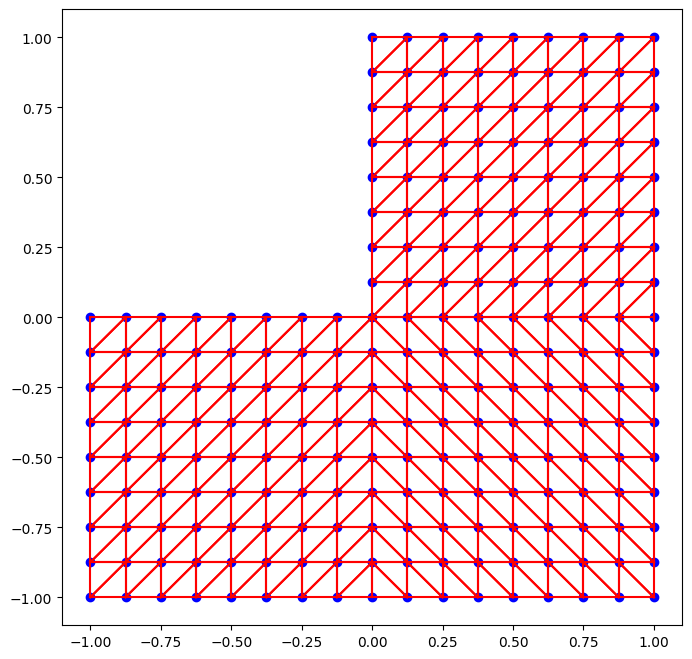

In [ ]:
plt.figure(figsize=(8,8))
for (tx,ty) in p_mat.T:
  plt.scatter(tx,ty,color='blue')
for temp_t in t_mat.T:
  plt.plot([p_mat[0,temp_t[0]-1],p_mat[0,temp_t[1]-1]],[p_mat[1,temp_t[0]-1],p_mat[1,temp_t[1]-1]],color='red')
  plt.plot([p_mat[0,temp_t[1]-1],p_mat[0,temp_t[2]-1]],[p_mat[1,temp_t[1]-1],p_mat[1,temp_t[2]-1]],color='red')
  plt.plot([p_mat[0,temp_t[2]-1],p_mat[0,temp_t[0]-1]],[p_mat[1,temp_t[2]-1],p_mat[1,temp_t[0]-1]],color='red')
plt.show()

## 古典計算

In [ ]:
xy = p_mat.T
node_label = t_mat.T[:,:3]

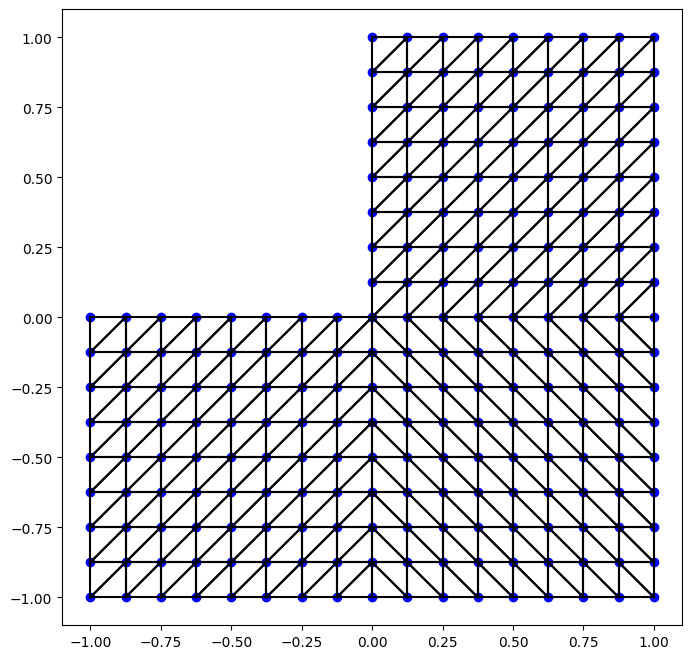

In [ ]:
plt.figure(figsize=(8,8))
for (tx,ty) in xy:
  plt.scatter(tx,ty,color='blue')
for temp_t in t_mat.T:
  plt.plot([p_mat[0,temp_t[0]-1],p_mat[0,temp_t[1]-1]],[p_mat[1,temp_t[0]-1],p_mat[1,temp_t[1]-1]],color='black')
  plt.plot([p_mat[0,temp_t[1]-1],p_mat[0,temp_t[2]-1]],[p_mat[1,temp_t[1]-1],p_mat[1,temp_t[2]-1]],color='black')
  plt.plot([p_mat[0,temp_t[2]-1],p_mat[0,temp_t[0]-1]],[p_mat[1,temp_t[2]-1],p_mat[1,temp_t[0]-1]],color='black')
plt.show()

$\omega_b$（境界条件にあるノードの渦度）の計算に用いるノード番号対応辞書

In [ ]:
bound_up_label_mod = [ t for t in list(bound_up_label) if (xy[int(t)-1][0]!=0) or (xy[int(t)-1][1]!=0)]
print(bound_up_label_mod)
bound_up_label_corner = [ t for t in list(bound_up_label) if (xy[int(t)-1][0]==0) and (xy[int(t)-1][1]==0)]
print(bound_up_label_corner)
bound_down_label_mod = [ t for t in list(bound_down_label) if (xy[int(t)-1][0]!=1.0) or (xy[int(t)-1][1]!=-1.0)]
print(bound_down_label_mod)
bound_down_label_corner = [ t for t in list(bound_down_label) if (xy[int(t)-1][0]==1.0) and (xy[int(t)-1][1]==-1.0)]
print(bound_down_label_corner)
bound_label_corner = [ int(t) for t in bound_up_label_corner+bound_down_label_corner]

BE_bound_label = list(bound_up_label_mod)+list(bound_down_label_mod)
print(BE_bound_label)
nvec_bound_label_up = [ [t_id+1 for t_id in range(len(xy)) if (xy[t_id][0]==xy[int(t)-1][0]) and (xy[t_id][1]==-0.25)][0] if xy[int(t)-1][1]==0 else [t_id+1 for t_id in range(len(xy)) if (xy[t_id][0]==0.25) and (xy[t_id][1]==xy[int(t)-1][1])][0] for t in list(bound_up_label_mod) ]
print(nvec_bound_label_up)
nvec_bound_label_up = [ [t_id+1 for t_id in range(len(xy)) if (xy[t_id][0]==0.25) and (xy[t_id][1]==-0.25)][0] if (xy[int(t_b)-1][0]==0) and (xy[int(t_b)-1][1]==0) else t for t_b,t in zip(list(bound_up_label_mod) ,nvec_bound_label_up)  ]
print(nvec_bound_label_up)
n_vec_bound_length_up = [ 0.25*np.sqrt(2) if (xy[t-1][0]==0.25) and (xy[t-1][1]==-0.25) else 0.25 for t in nvec_bound_label_up]
print(n_vec_bound_length_up)

nvec_bound_label_down = [ [t_id+1 for t_id in range(len(xy)) if (xy[t_id][0]==xy[int(t)-1][0]) and (xy[t_id][1]==-0.75)][0] if xy[int(t)-1][1]==-1.0 else [t_id+1 for t_id in range(len(xy)) if (xy[t_id][0]==0.75) and (xy[t_id][1]==xy[int(t)-1][1])][0] for t in list(bound_down_label_mod) ]
print(nvec_bound_label_down)
nvec_bound_label_down = [ [t_id+1 for t_id in range(len(xy)) if (xy[t_id][0]==0.75) and (xy[t_id][1]==-0.75)][0] if (xy[int(t_b)-1][0]==1.0) and (xy[int(t_b)-1][1]==-1.0) else t for t_b,t in zip(list(bound_down_label_mod) ,nvec_bound_label_down)  ]
print(nvec_bound_label_down)
n_vec_bound_length_down = [ 0.25*np.sqrt(2) if (xy[int(t_b)-1][0]==1.0) and (xy[int(t_b)-1][1]==-1.0) else 0.25 for t,t_b in zip(nvec_bound_label_down,list(bound_down_label_mod))]
print(n_vec_bound_length_down)

### omega dict all
nvec_bound_label = nvec_bound_label_up + nvec_bound_label_down
nvec_bound_length = n_vec_bound_length_up + n_vec_bound_length_down
keys = []
values = []
for t_l, t_nvec_l, t_length in zip(BE_bound_label,nvec_bound_label,nvec_bound_length):
  keys.append(int(t_l))
  values.append([t_nvec_l, t_length])
omega_n_dict = dict(zip(keys,values))
print(omega_n_dict)

### omega dict for up boundary
keys = []; values = []
for t_l, t_nvec_l, t_length in zip(bound_up_label_mod, nvec_bound_label_up, n_vec_bound_length_up):
  keys.append(int(t_l))
  values.append([t_nvec_l, t_length])
omega_n_dict_up = dict(zip(keys,values))

### omega dict for down boundary
keys = []; values = []
for t_l, t_nvec_l, t_length in zip(bound_down_label_mod, nvec_bound_label_down, n_vec_bound_length_down):
  keys.append(int(t_l))
  values.append([t_nvec_l, t_length])
omega_n_dict_down = dict(zip(keys,values))


[1.0, 3.0, 15.0, 18.0, 28.0, 31.0, 38.0, 41.0, 72.0, 75.0, 82.0, 85.0, 92.0, 95.0, 102.0, 105.0]
[8.0]
[2.0, 4.0, 5.0, 7.0, 11.0, 12.0, 13.0, 14.0, 24.0, 25.0, 26.0, 27.0, 34.0, 35.0, 36.0, 37.0, 68.0, 69.0, 70.0, 71.0, 78.0, 79.0, 80.0, 81.0, 88.0, 89.0, 90.0, 91.0, 98.0, 99.0, 100.0, 101.0]
[6.0]
[1.0, 3.0, 15.0, 18.0, 28.0, 31.0, 38.0, 41.0, 72.0, 75.0, 82.0, 85.0, 92.0, 95.0, 102.0, 105.0, 2.0, 4.0, 5.0, 7.0, 11.0, 12.0, 13.0, 14.0, 24.0, 25.0, 26.0, 27.0, 34.0, 35.0, 36.0, 37.0, 68.0, 69.0, 70.0, 71.0, 78.0, 79.0, 80.0, 81.0, 88.0, 89.0, 90.0, 91.0, 98.0, 99.0, 100.0, 101.0]
[22, 23, 52, 59, 42, 55, 49, 47, 114, 172, 158, 193, 157, 194, 143, 134]
[22, 23, 52, 59, 42, 55, 49, 47, 114, 172, 158, 193, 157, 194, 143, 134]
[0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25]
[32, 33, 30, 39, 51, 62, 63, 57, 48, 46, 60, 44, 45, 60, 43, 54, 139, 131, 199, 123, 152, 208, 212, 183, 153, 207, 213, 182, 126, 198, 119, 168]
[32, 33, 30, 39, 51, 62, 

In [ ]:
#omega_n_dict[[tid+1 for tid, [tx,ty] in enumerate(xy) if (ty==0) and (tx==2000)][0]] = [[tid+1 for tid, [tx,ty] in enumerate(xy) if (ty==125) and (tx==2000)][0],1.25]
#omega_n_dict[[tid+1 for tid, [tx,ty] in enumerate(xy) if (ty==0) and (tx==0)][0]] = [[tid+1 for tid, [tx,ty] in enumerate(xy) if (ty==83) and (tx==0)][0],0.83]
omega_n_dict

{1: [22, 0.25],
 3: [23, 0.25],
 15: [52, 0.25],
 18: [59, 0.25],
 28: [42, 0.25],
 31: [55, 0.25],
 38: [49, 0.25],
 41: [47, 0.25],
 72: [114, 0.25],
 75: [172, 0.25],
 82: [158, 0.25],
 85: [193, 0.25],
 92: [157, 0.25],
 95: [194, 0.25],
 102: [143, 0.25],
 105: [134, 0.25],
 2: [32, 0.25],
 4: [33, 0.25],
 5: [30, 0.25],
 7: [39, 0.25],
 11: [51, 0.25],
 12: [62, 0.25],
 13: [63, 0.25],
 14: [57, 0.25],
 24: [48, 0.25],
 25: [46, 0.25],
 26: [60, 0.25],
 27: [44, 0.25],
 34: [45, 0.25],
 35: [60, 0.25],
 36: [43, 0.25],
 37: [54, 0.25],
 68: [139, 0.25],
 69: [131, 0.25],
 70: [199, 0.25],
 71: [123, 0.25],
 78: [152, 0.25],
 79: [208, 0.25],
 80: [212, 0.25],
 81: [183, 0.25],
 88: [153, 0.25],
 89: [207, 0.25],
 90: [213, 0.25],
 91: [182, 0.25],
 98: [126, 0.25],
 99: [198, 0.25],
 100: [119, 0.25],
 101: [168, 0.25]}

要素マトリックスを求める

二次元1次補完関数の定義

In [ ]:
def compfunc(xy,node_label,pos):
  ## return area of triangle and each function
  x1 = xy[node_label[pos][0]-1][0]/100; y1 = xy[node_label[pos][0]-1][1]/100
  x2 = xy[node_label[pos][1]-1][0]/100; y2 = xy[node_label[pos][1]-1][1]/100
  x3 = xy[node_label[pos][2]-1][0]/100; y3 = xy[node_label[pos][2]-1][1]/100

  area_t = 1/2*((x2*y3+x1*y2+x3*y1)-(x3*y2+x1*y3+x2*y1))
  b1 = y2-y3; c1 = x3-x2
  b2 = y3-y1; c2 = x1-x3
  b3 = y1-y2; c3 = x2-x1

  return area_t, b1,b2,b3,c1,c2,c3

def D_e(area_t, b1,b2,b3,c1,c2,c3):
  temp_mat = 1/4/area_t * np.array([b1**2+c1**2,b1*b2+c1*c2,b1*b3+c1*c3,
                                    b1*b2+c1*c2,b2**2+c2**2,b3*b2+c3*c2,
                                    b1*b3+c1*c3,b2*b3+c2*c3,b3**2+c3**2])
  return temp_mat.reshape(3,3)

def Dnu_e(area_t, b1,b2,b3,c1,c2,c3,nuU,nuV):
  temp_mat = 1/4/area_t * np.array([nuU*b1**2+nuV*c1**2,nuU*b1*b2+nuV*c1*c2,nuU*b1*b3+nuV*c1*c3,
                                    nuU*b1*b2+nuV*c1*c2,nuU*b2**2+nuV*c2**2,nuU*b3*b2+nuV*c3*c2,
                                    nuU*b1*b3+nuV*c1*c3,nuU*b2*b3+nuV*c2*c3,nuU*b3**2+nuV*c3**2])
  return temp_mat.reshape(3,3)

def tildeM_e(area_t):
  temp_mat = 1/3*np.diag([area_t,area_t,area_t])
  return temp_mat

def M_e(area_t):
  temp_mat = 1/12*area_t*np.array([2 if i==j else 1 for i in range(3) for j in range(3)]).reshape(3,3)
  return temp_mat


def A_e(psi_list):
  psi1 = psi_list[0]
  psi2 = psi_list[1]
  psi3 = psi_list[2]
  temp_mat = 1/6*np.array([psi2-psi3,psi3-psi1,psi1-psi2,psi2-psi3,psi3-psi1,psi1-psi2,psi2-psi3,psi3-psi1,psi1-psi2]).reshape(3,3)

  return temp_mat

境界条件による力の計算(流れ関数について) ※ ループ内で計算のため下記関数は無視

In [ ]:
'''
def rightF(xy,node_label,bound_label,corner4,corner_ind,pos):
  if node_label[0] in bound_label:
    if node_label[1] in bound_label:
      if node_label[0] in bound_label[corner_ind[0]:corner_ind[1]+1]
      vec_temp =
    elif node_label[2] in bound_label:
      pass
    else:
      vec_temp = np.array([0,0,0])
  elif node_label[0] not in bound_label:
    if node_label[1] in bound_label:
      if node_label[2] in bound_label:
        pass
      else:
        vec_temp = np.array([0,0,0])
    else:
      vec_temp = np.array([0,0,0])

    return vec_temp
'''
def rightF(xy,node_label,bound_label,corner4,corner_ind,pos):
  return np.array([0,0,0])

有限要素の重心

In [ ]:
def centroid(xy,node_label,pos):
  ## return area of triangle and each function
  x1 = xy[node_label[pos][0]-1][0]; y1 = xy[node_label[pos][0]-1][1]
  x2 = xy[node_label[pos][1]-1][0]; y2 = xy[node_label[pos][1]-1][1]
  x3 = xy[node_label[pos][2]-1][0]; y3 = xy[node_label[pos][2]-1][1]

  centr = [(x1+x2+x3)/3,(y1+y2+y3)/3]

  return centr

二次元1次補完関数の定義

In [ ]:
def compfunc(xy,node_label,pos):
  ## return area of triangle and each function
  x1 = xy[int(node_label[pos][0]-1)][0]; y1 = xy[int(node_label[pos][0]-1)][1]
  x2 = xy[int(node_label[pos][1]-1)][0]; y2 = xy[int(node_label[pos][1]-1)][1]
  x3 = xy[int(node_label[pos][2]-1)][0]; y3 = xy[int(node_label[pos][2]-1)][1]

  area_t = 1/2*((x2*y3+x1*y2+x3*y1)-(x3*y2+x1*y3+x2*y1))
  b1 = y2-y3; c1 = x3-x2
  b2 = y3-y1; c2 = x1-x3
  b3 = y1-y2; c3 = x2-x1

  return area_t, b1,b2,b3,c1,c2,c3

def D_e(area_t, b1,b2,b3,c1,c2,c3):
  temp_mat = 1/4/area_t * np.array([b1**2+c1**2,b1*b2+c1*c2,b1*b3+c1*c3,
                                    b1*b2+c1*c2,b2**2+c2**2,b3*b2+c3*c2,
                                    b1*b3+c1*c3,b2*b3+c2*c3,b3**2+c3**2])
  return temp_mat.reshape(3,3)


### 条件設定・計算: （入力口は一様に流れ込んでいる：妥当な条件ではないはず）

In [ ]:
## def of time increment & viscosity conditions
dt = 0.05#0.2
epsilon = 0.01
nu0 = 0.05
mu0 = nu0*997 #water

## def of normal and natural conditions
Vs = 0 # for green and orange boundary
psi_b_up = 0
v_uni = 0.1 # 0.1
psi_b_down = v_uni
psi_in = lambda x: v_uni*x

### conditions for pmega N.B. boundary for
omega_corner = 0
omega_init = 0
omega_in = 0



[0.     0.1    0.     0.1    0.1    0.1    0.1    0.     0.     0.05
 0.1    0.1    0.1    0.1    0.     0.     0.     0.     0.     0.
 0.     0.     0.025  0.1    0.1    0.1    0.1    0.     0.     0.
 0.     0.     0.075  0.1    0.1    0.1    0.1    0.     0.     0.
 0.     0.     0.     0.     0.     0.     0.     0.     0.     0.
 0.     0.     0.     0.     0.     0.     0.     0.     0.     0.
 0.     0.     0.     0.     0.     0.     0.0125 0.1    0.1    0.1
 0.1    0.     0.     0.     0.     0.     0.0625 0.1    0.1    0.1
 0.1    0.     0.     0.     0.     0.     0.0375 0.1    0.1    0.1
 0.1    0.     0.     0.     0.     0.     0.0875 0.1    0.1    0.1
 0.1    0.     0.     0.     0.     0.     0.     0.     0.     0.
 0.     0.     0.     0.     0.     0.     0.     0.     0.     0.
 0.     0.     0.     0.     0.     0.     0.     0.     0.     0.
 0.     0.     0.     0.     0.     0.     0.     0.     0.     0.
 0.     0.     0.     0.     0.     0.     0.     0.    

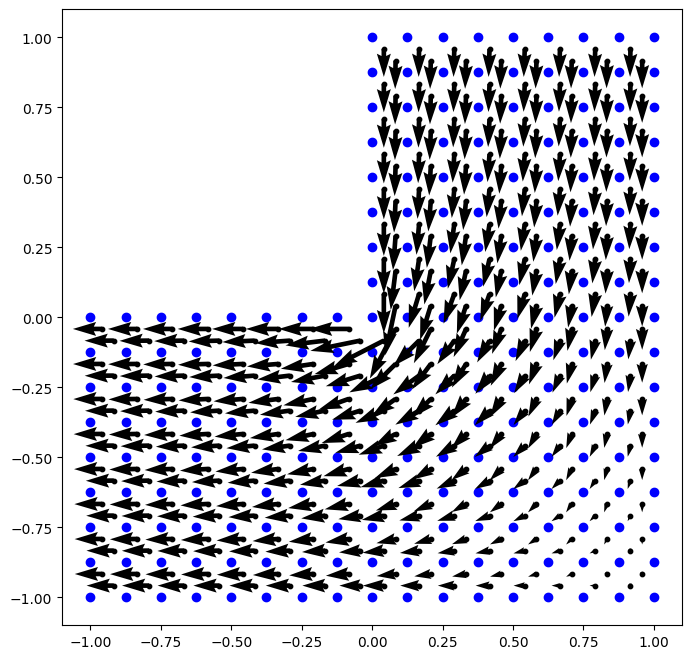

[1.57068818e+10]
[ 0.          0.1         0.          0.1         0.1         0.1
  0.1         0.          0.          0.05        0.1         0.1
  0.1         0.1         0.          0.          0.          0.
  0.          0.          0.          0.          0.025       0.1
  0.1         0.1         0.1         0.          0.          0.
  0.          0.          0.075       0.1         0.1         0.1
  0.1         0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.         -0.00242252
  0.0125      0.1         0.1         0.1         0.1         0.
  0.          0.00349811  0.          0.          0.0625      0.1
  0.1         0.1         0.1         0.          0.          0.
  0.          0.          0.0375      0.1         0.1       

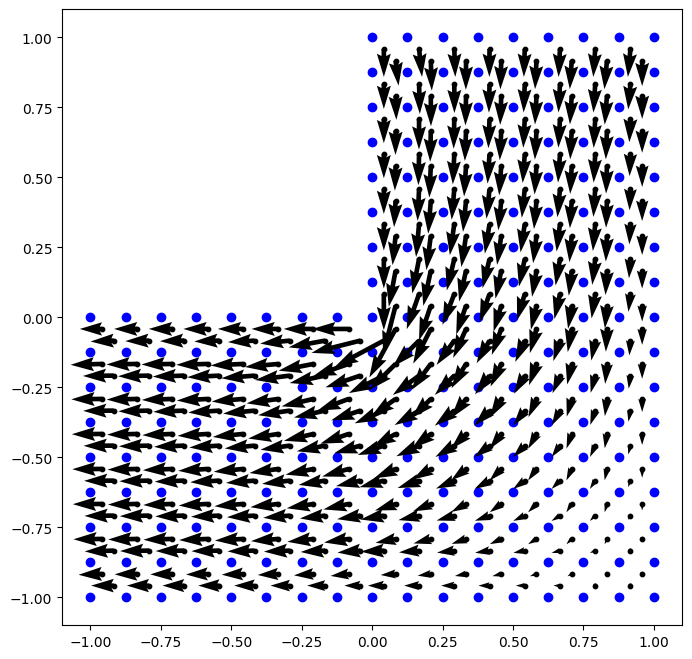

[5.08763392e+09]
[ 0.          0.1         0.          0.1         0.1         0.1
  0.1         0.          0.          0.05        0.1         0.1
  0.1         0.1         0.          0.          0.          0.
  0.          0.          0.         -0.00086092  0.025       0.1
  0.1         0.1         0.1         0.          0.          0.00122989
  0.          0.000184    0.075       0.1         0.1         0.1
  0.1         0.          0.00124072  0.          0.         -0.00107908
  0.00053079  0.0009161   0.00090796  0.00052583 -0.00106585  0.00098426
 -0.00111401  0.          0.0009613  -0.00114671  0.          0.0008677
 -0.0011289   0.          0.00097325  0.         -0.00113357  0.0002531
  0.          0.00032819  0.00033138  0.          0.         -0.00475994
  0.0125      0.1         0.1         0.1         0.1         0.
 -0.00051132  0.0068403   0.          0.          0.0625      0.1
  0.1         0.1         0.1         0.          0.          0.
  0.          0.      

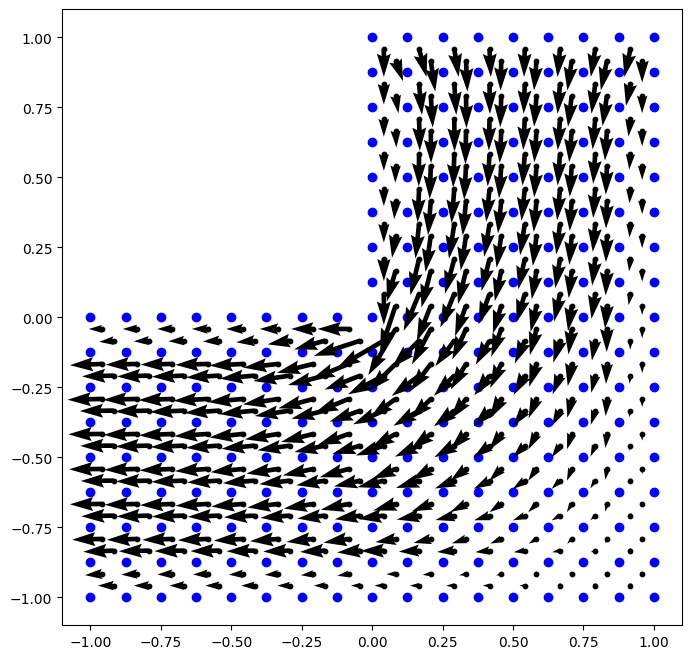

[1.90509861e+09]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
  0.00000000e+00  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -2.01325719e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -2.59586941e-04  2.86179688e-03  0.00000000e+00  6.90326998e-04
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  2.90919140e-03 -2.26972303e-04
  0.00000000e+00 -2.79379266e-03  1.39807502e-03  2.36276980e-03
  2.32643411e-03  1.37087592e-03 -2.77367708e-03  2.51342107e-03
 -2.81821677e-03  0.00000000e+00  2.48078021e-03 -2.98454109e-03
  0.00000000e+00  2.21205664e-03 -2.81525321e-03  0.00000000e+00
  2.52826449e-03  0.00000000e+00 -2.93276408e-03  6.99249530e-04
  0.0000

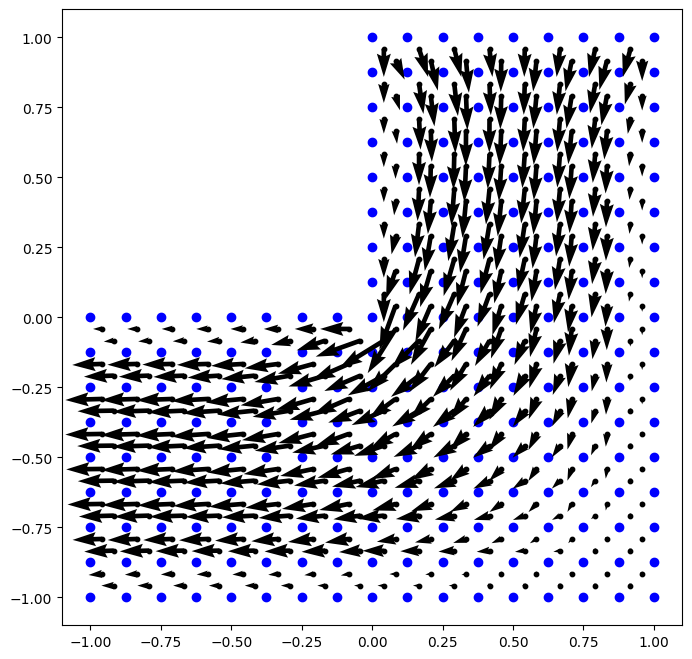

[6.775204e+08]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -9.03290299e-05  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.47200689e-04
  1.40091037e-04  0.00000000e+00 -2.47918605e-05 -1.63733716e-05
  5.93521947e-05 -2.55901982e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.54506148e-04  3.60468599e-03  0.00000000e+00  1.16619551e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.67743154e-03 -6.56609191e-04
  0.00000000e+00 -3.91983724e-03  1.95128173e-03  3.30034984e-03
  3.23542568e-03  1.89856168e-03 -3.80370248e-03  3.48863635e-03
 -3.78486866e-03 -2.13319421e-05  3.45163922e-03 -4.18046479e-03
  1.16499551e-05  2.96726616e-03 -3.81420958e-03 -4.99542729e-05
  3.53307226e-03  1.33052340e-05 -4.10751850e-03  8.97765704e-04
 -8.072063

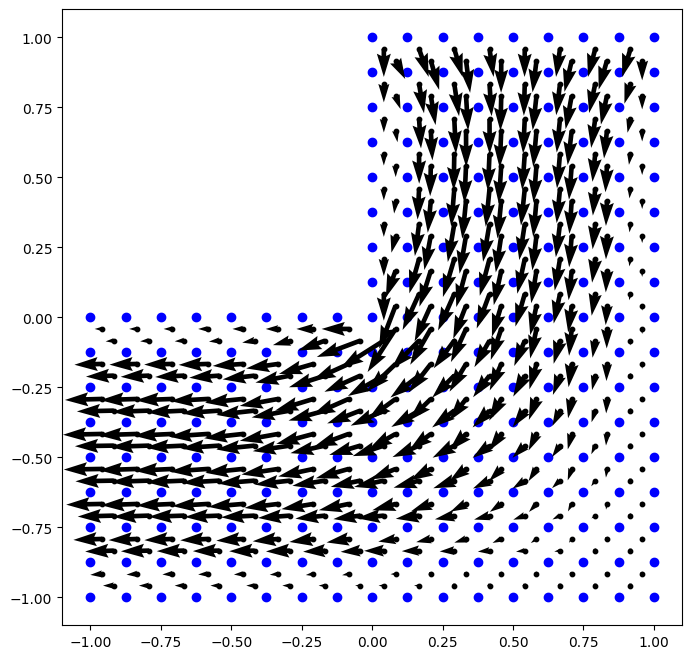

[1.9334201e+08]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -2.49364492e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  4.28286674e-04
  4.01400621e-04  0.00000000e+00 -7.72661420e-05 -5.29342391e-05
  1.98679439e-04 -2.85114088e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.04736828e-03  3.97641661e-03  0.00000000e+00  1.45983445e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  4.06643809e-03 -9.14557286e-04
  0.00000000e+00 -4.60178467e-03  2.27618508e-03  3.86025616e-03
  3.77607869e-03  2.19695947e-03 -4.26619014e-03  4.06981595e-03
 -4.40613363e-03 -7.63612081e-05  4.01860299e-03 -4.87458855e-03
  3.51641565e-05  3.43797123e-03 -4.45335574e-03 -1.70680064e-04
  4.12480334e-03  4.72765507e-05 -4.81236327e-03  9.31758445e-04
 -2.01039

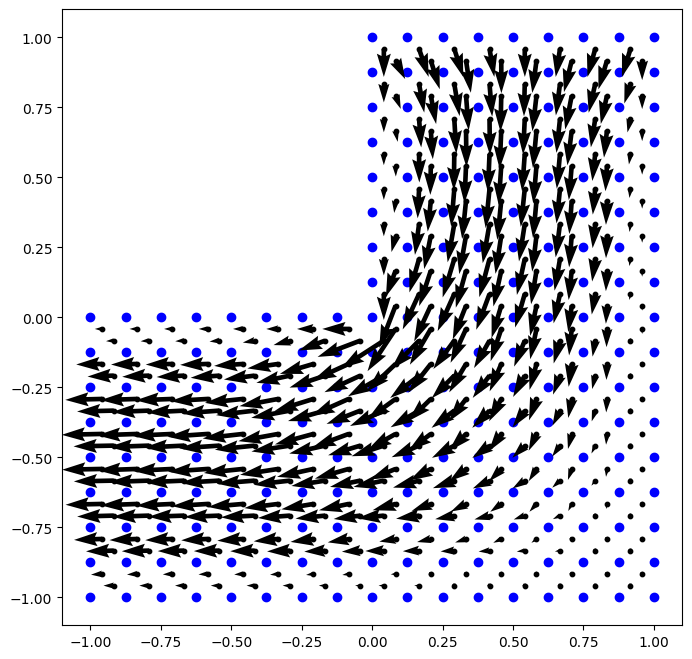

[23545005.87510948]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -3.74454721e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  6.62411311e-04
  6.15099072e-04  0.00000000e+00 -1.30912956e-04 -9.94637868e-05
  3.54245905e-04 -2.87749264e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.38174696e-03  3.98132506e-03  0.00000000e+00  1.68255805e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  4.07614072e-03 -1.21149213e-03
  0.00000000e+00 -4.89960899e-03  2.39384419e-03  4.10463055e-03
  4.00460112e-03  2.29998428e-03 -4.47452516e-03  4.37756857e-03
 -4.73384841e-03 -1.53865871e-04  4.28411181e-03 -5.19972144e-03
  8.12172373e-05  3.66762845e-03 -4.81654813e-03 -3.08007062e-04
  4.40783287e-03  1.01928237e-04 -5.15706929e-03  8.96039534e-04
 -3.4

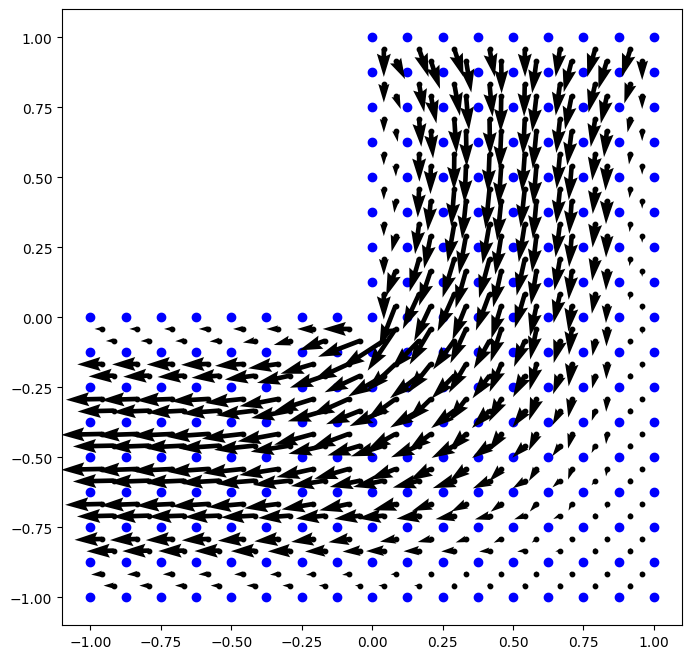

[1.15117714]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -4.90670414e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  8.76835429e-04
  8.07544109e-04  0.00000000e+00 -1.76468999e-04 -1.51827742e-04
  4.91324313e-04 -2.88105587e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.52604854e-03  3.96620903e-03  0.00000000e+00  1.77070556e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  4.06179480e-03 -1.33854388e-03
  0.00000000e+00 -5.03224122e-03  2.44875559e-03  4.21375218e-03
  4.10621451e-03  2.34271253e-03 -4.48386995e-03  4.50853454e-03
 -4.90838939e-03 -2.36603360e-04  4.39436960e-03 -5.34235153e-03
  1.22069683e-04  3.77953785e-03 -5.00795465e-03 -4.04648058e-04
  4.53438963e-03  1.50447956e-04 -5.30526206e-03  8.68072988e-04
 -4.32084698

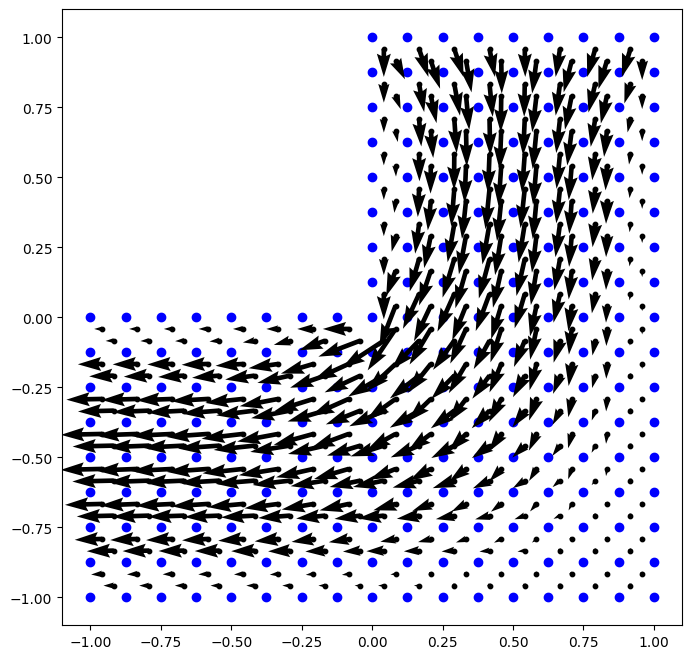

[0.7811326]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -5.52169701e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  9.98103771e-04
  9.12394691e-04  0.00000000e+00 -2.13881262e-04 -1.98917117e-04
  5.99089429e-04 -2.82504628e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.68433560e-03  3.88384279e-03  0.00000000e+00  1.83784101e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.97619671e-03 -1.48652264e-03
  0.00000000e+00 -5.04677103e-03  2.44262868e-03  4.23336874e-03
  4.11921551e-03  2.33383155e-03 -4.49744011e-03  4.57154719e-03
 -4.99991137e-03 -2.99963094e-04  4.42950006e-03 -5.39018305e-03
  1.51141737e-04  3.81618550e-03 -5.12040909e-03 -4.91132595e-04
  4.57912528e-03  1.82519896e-04 -5.36381909e-03  8.50766702e-04
 -5.24335729e

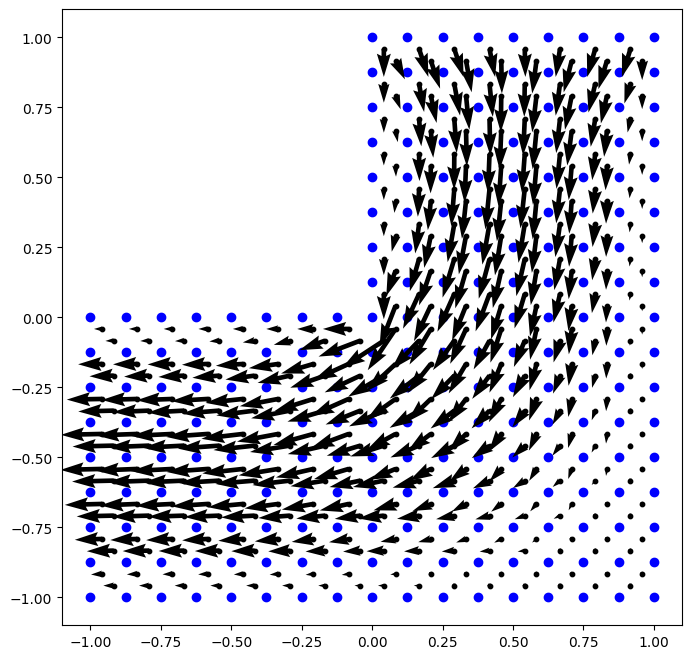

[0.39554619]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -6.08385827e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.09979781e-03
  9.99554052e-04  0.00000000e+00 -2.42977835e-04 -2.36382043e-04
  6.81027362e-04 -2.81115825e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.72385535e-03  3.86653737e-03  0.00000000e+00  1.84196943e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.95639984e-03 -1.52465869e-03
  0.00000000e+00 -5.05751586e-03  2.45271430e-03  4.24855962e-03
  4.13263457e-03  2.33984579e-03 -4.46059990e-03  4.57771750e-03
 -5.03651713e-03 -3.59877736e-04  4.43825912e-03 -5.40683441e-03
  1.72808390e-04  3.82774850e-03 -5.16222200e-03 -5.32680534e-04
  4.59356039e-03  2.04867198e-04 -5.37480141e-03  8.49560138e-04
 -5.54599546

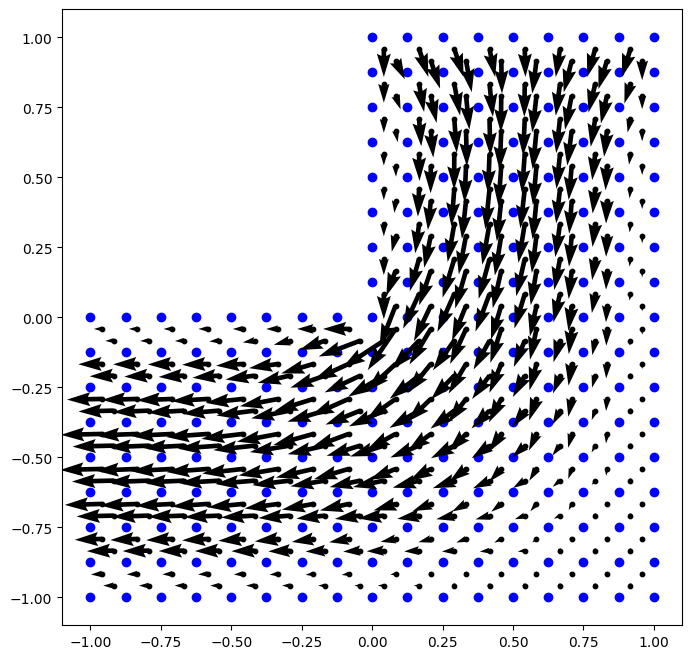

[0.62956428]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -6.28518197e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.13960936e-03
  1.02993065e-03  0.00000000e+00 -2.65994137e-04 -2.69427917e-04
  7.41664280e-04 -2.77766631e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.79044271e-03  3.82772592e-03  0.00000000e+00  1.85644847e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.91443651e-03 -1.59432459e-03
  0.00000000e+00 -5.03533743e-03  2.44027634e-03  4.24014890e-03
  4.12241613e-03  2.32841863e-03 -4.46406694e-03  4.58592311e-03
 -5.06177856e-03 -3.94429464e-04  4.43669417e-03 -5.40493137e-03
  1.78493702e-04  3.82061000e-03 -5.19588434e-03 -5.75434834e-04
  4.59129285e-03  2.09052651e-04 -5.38161863e-03  8.48740076e-04
 -5.98254529

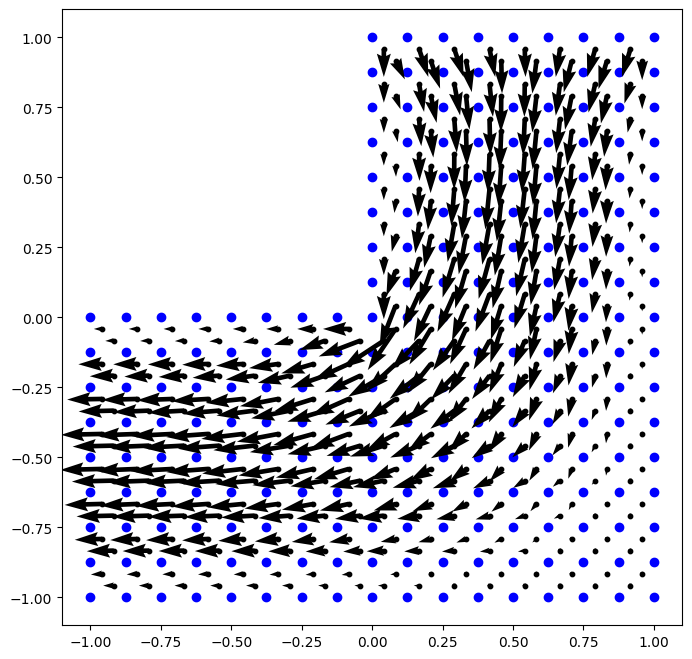

[0.27728238]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -6.56508164e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.18528859e-03
  1.06764234e-03  0.00000000e+00 -2.84106452e-04 -2.89875957e-04
  7.90484281e-04 -2.77846733e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78778464e-03  3.83391326e-03  0.00000000e+00  1.84243187e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.91906837e-03 -1.59552457e-03
  0.00000000e+00 -5.03975729e-03  2.45037845e-03  4.24872493e-03
  4.13232088e-03  2.33664757e-03 -4.44387510e-03  4.57369519e-03
 -5.06475359e-03 -4.32873889e-04  4.43673407e-03 -5.40560621e-03
  1.86622837e-04  3.81618090e-03 -5.19806062e-03 -5.90174495e-04
  4.59028121e-03  2.16108654e-04 -5.37550314e-03  8.51985435e-04
 -5.93593705

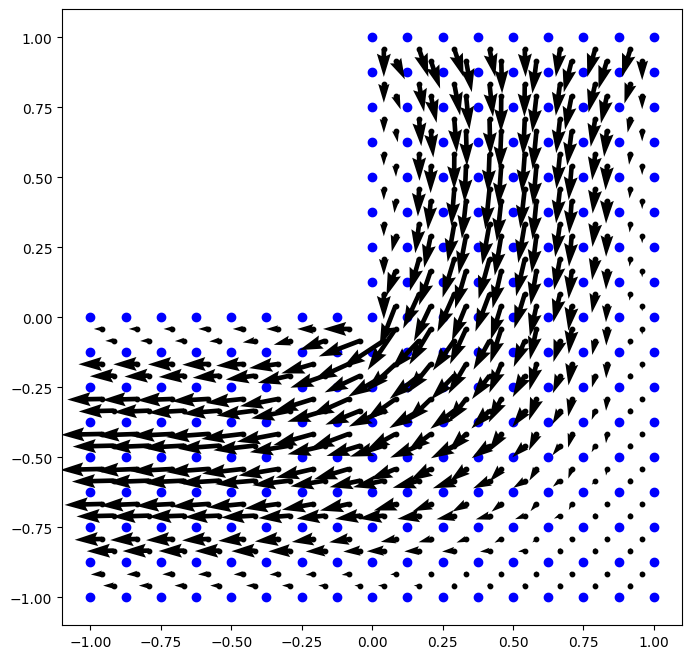

[1.51204543]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -6.61843939e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.19381317e-03
  1.07121200e-03  0.00000000e+00 -2.98069448e-04 -3.11635377e-04
  8.25699180e-04 -2.76177421e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.81758549e-03  3.81649300e-03  0.00000000e+00  1.84629675e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.89981720e-03 -1.63103531e-03
  0.00000000e+00 -5.02427533e-03  2.44180785e-03  4.24224095e-03
  4.12658637e-03  2.32944341e-03 -4.45204684e-03  4.57744845e-03
 -5.07604848e-03 -4.49911889e-04  4.43573129e-03 -5.40143489e-03
  1.82492070e-04  3.80628008e-03 -5.21305605e-03 -6.13275013e-04
  4.58378253e-03  2.09691418e-04 -5.38072441e-03  8.51563326e-04
 -6.12249242

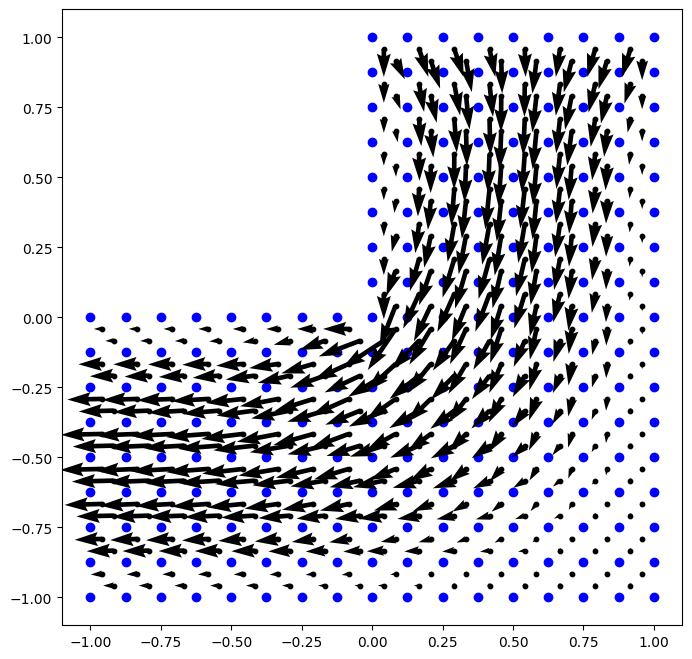

[0.73659657]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -6.79526085e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.21910076e-03
  1.09240445e-03  0.00000000e+00 -3.09361456e-04 -3.21466818e-04
  8.57308591e-04 -2.76758227e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.80357048e-03  3.82601700e-03  0.00000000e+00  1.83373448e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.90871553e-03 -1.62021694e-03
  0.00000000e+00 -5.03259582e-03  2.45046485e-03  4.25059062e-03
  4.13684655e-03  2.33684145e-03 -4.44203340e-03  4.56812749e-03
 -5.07323740e-03 -4.75916524e-04  4.43790401e-03 -5.40322397e-03
  1.86792395e-04  3.80333955e-03 -5.20845754e-03 -6.18579598e-04
  4.58383472e-03  2.13431595e-04 -5.37634791e-03  8.53326913e-04
 -5.94786153

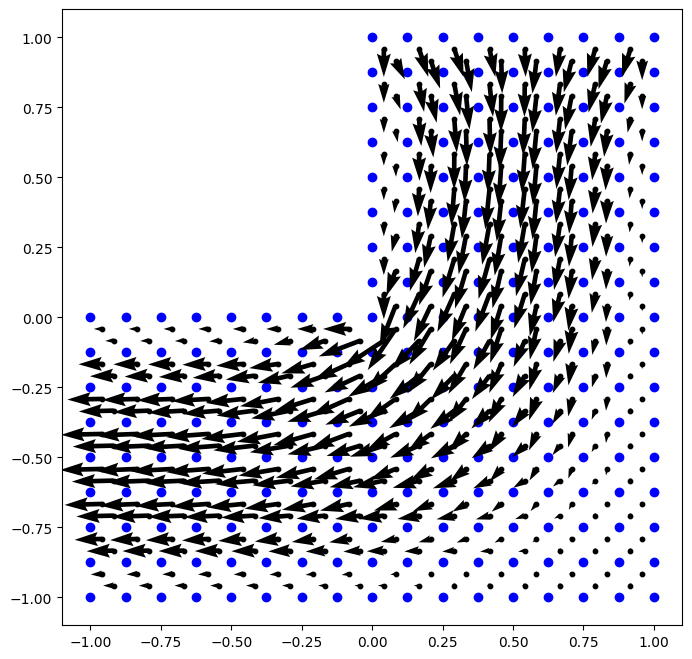

[10.71178722]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -6.80378450e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.21806975e-03
  1.08882327e-03  0.00000000e+00 -3.17772481e-04 -3.36555899e-04
  8.78014503e-04 -2.75711160e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.81953835e-03  3.81374058e-03  0.00000000e+00  1.83705025e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.89544067e-03 -1.64057516e-03
  0.00000000e+00 -5.02258495e-03  2.44259499e-03  4.24507618e-03
  4.13264879e-03  2.33014421e-03 -4.44996089e-03  4.57368251e-03
 -5.08194951e-03 -4.83868209e-04  4.43867892e-03 -5.40154463e-03
  1.80787569e-04  3.79652257e-03 -5.21975799e-03 -6.33047389e-04
  4.57856624e-03  2.05154817e-04 -5.38341895e-03  8.52101287e-04
 -6.0307768

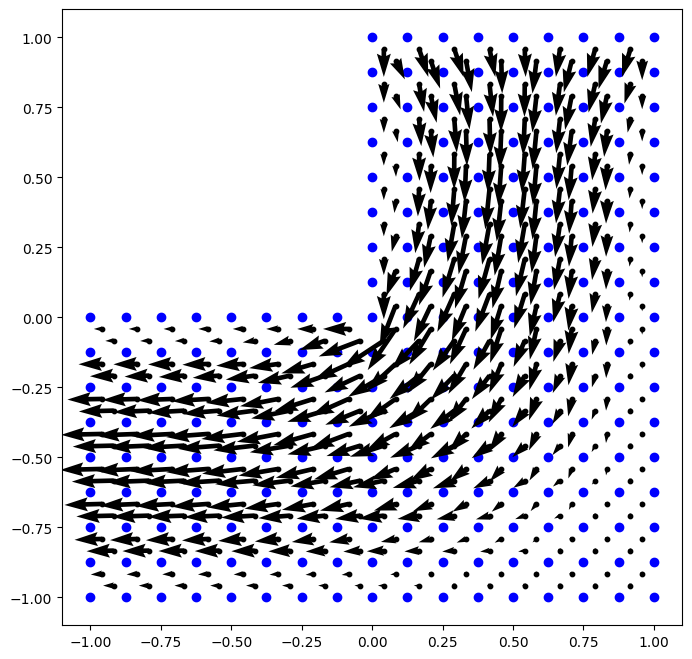

[11.61950314]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -6.93318421e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.23532054e-03
  1.10419625e-03  0.00000000e+00 -3.24879977e-04 -3.40678449e-04
  8.99503659e-04 -2.76295709e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.80447377e-03  3.82094471e-03  0.00000000e+00  1.82815338e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.90252801e-03 -1.62681158e-03
  0.00000000e+00 -5.03141023e-03  2.44881252e-03  4.25191949e-03
  4.14059886e-03  2.33552275e-03 -4.44379801e-03  4.56750160e-03
 -5.07846228e-03 -5.02399110e-04  4.44114046e-03 -5.40429622e-03
  1.84740207e-04  3.79586441e-03 -5.21481718e-03 -6.34885941e-04
  4.58019466e-03  2.09117665e-04 -5.38034995e-03  8.53169495e-04
 -5.8302372

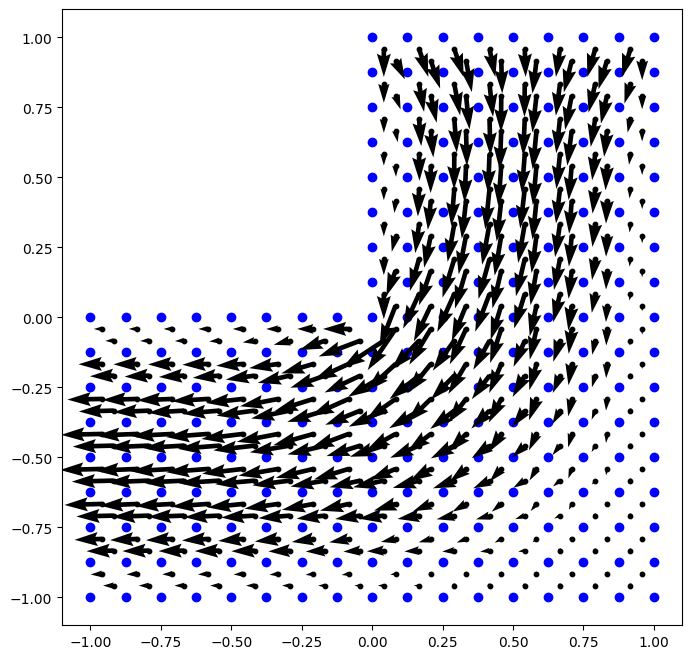

[2.67513709]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -6.92385864e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.23127838e-03
  1.09896729e-03  0.00000000e+00 -3.29956259e-04 -3.51823618e-04
  9.11344624e-04 -2.75507735e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.81469817e-03  3.81062998e-03  0.00000000e+00  1.83171699e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.89166422e-03 -1.63968727e-03
  0.00000000e+00 -5.02380100e-03  2.44142452e-03  4.24647761e-03
  4.13634500e-03  2.32911648e-03 -4.44987348e-03  4.57334515e-03
 -5.08592913e-03 -5.05383532e-04  4.44198549e-03 -5.40384647e-03
  1.79135884e-04  3.79128049e-03 -5.22452588e-03 -6.44711975e-04
  4.57583725e-03  2.01215452e-04 -5.38728481e-03  8.51748314e-04
 -5.87388134

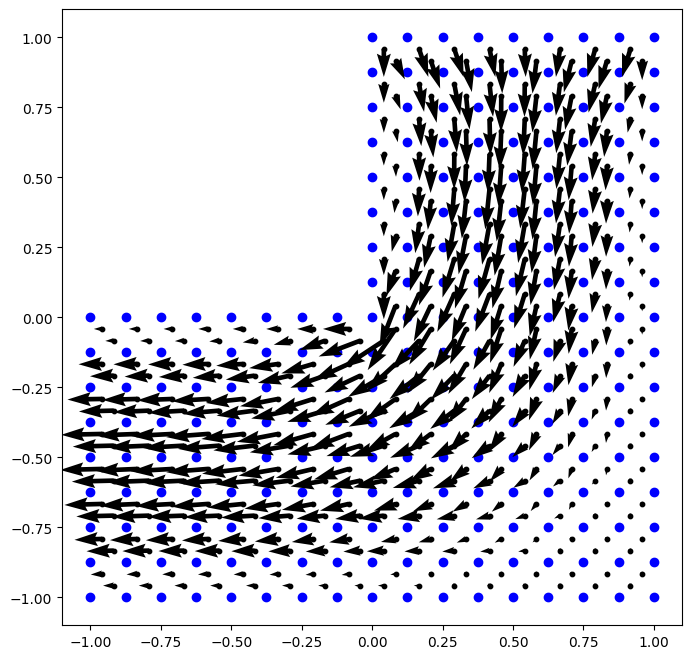

[0.66568379]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.02197251e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.24428096e-03
  1.11139739e-03  0.00000000e+00 -3.34534133e-04 -3.52893170e-04
  9.26579660e-04 -2.76013204e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.80123749e-03  3.81609000e-03  0.00000000e+00  1.82533224e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.89725802e-03 -1.62610425e-03
  0.00000000e+00 -5.03157732e-03  2.44615581e-03  4.25198895e-03
  4.14204482e-03  2.33335216e-03 -4.44539450e-03  4.56858265e-03
 -5.08232234e-03 -5.18950876e-04  4.44366124e-03 -5.40640190e-03
  1.83178709e-04  3.79174910e-03 -5.21979240e-03 -6.44976747e-04
  4.57811186e-03  2.05608181e-04 -5.38438768e-03  8.52611497e-04
 -5.68593445

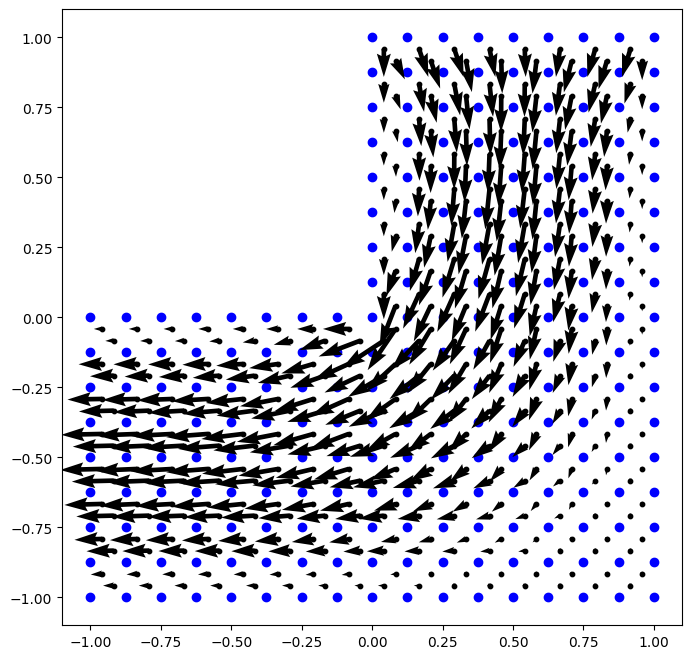

[4.30022757]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.00325054e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.23926894e-03
  1.10599825e-03  0.00000000e+00 -3.37628561e-04 -3.61466406e-04
  9.33037454e-04 -2.75387786e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.80865501e-03  3.80752347e-03  0.00000000e+00  1.82870474e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88835779e-03 -1.63494739e-03
  0.00000000e+00 -5.02527450e-03  2.43966226e-03  4.24678099e-03
  4.13793376e-03  2.32765544e-03 -4.44987236e-03  4.57371174e-03
 -5.08861037e-03 -5.19149602e-04  4.44413463e-03 -5.40633625e-03
  1.78323974e-04  3.78841708e-03 -5.22803155e-03 -6.51895251e-04
  4.57426401e-03  1.98442256e-04 -5.39037851e-03  8.51174118e-04
 -5.71634428

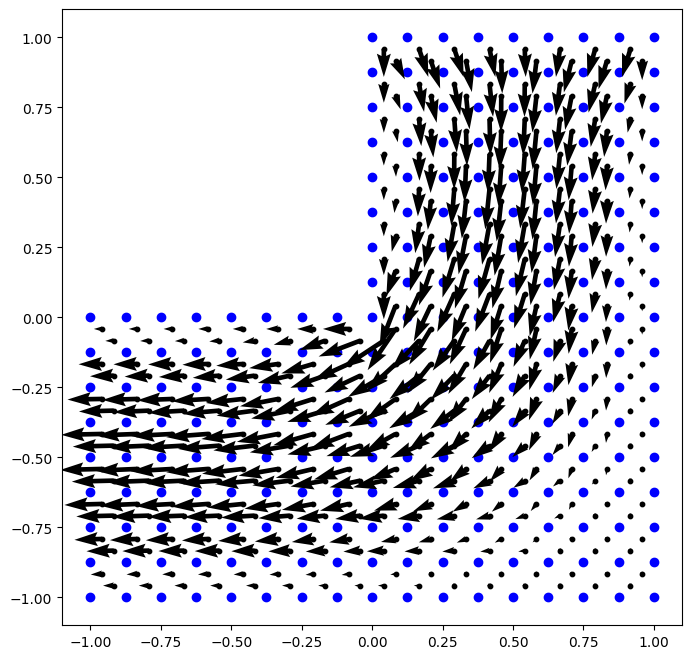

[0.37052514]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.07838153e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.24956148e-03
  1.11645906e-03  0.00000000e+00 -3.40665206e-04 -3.60872044e-04
  9.44332879e-04 -2.75822234e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.79724652e-03  3.81204787e-03  0.00000000e+00  1.82387455e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.89311680e-03 -1.62265044e-03
  0.00000000e+00 -5.03182082e-03  2.44360709e-03  4.25143313e-03
  4.14216085e-03  2.33135231e-03 -4.44642240e-03  4.56963066e-03
 -5.08503057e-03 -5.29295594e-04  4.44503486e-03 -5.40834996e-03
  1.82292876e-04  3.78932224e-03 -5.22350971e-03 -6.51356532e-04
  4.57669369e-03  2.02967288e-04 -5.38746374e-03  8.51956776e-04
 -5.55295534

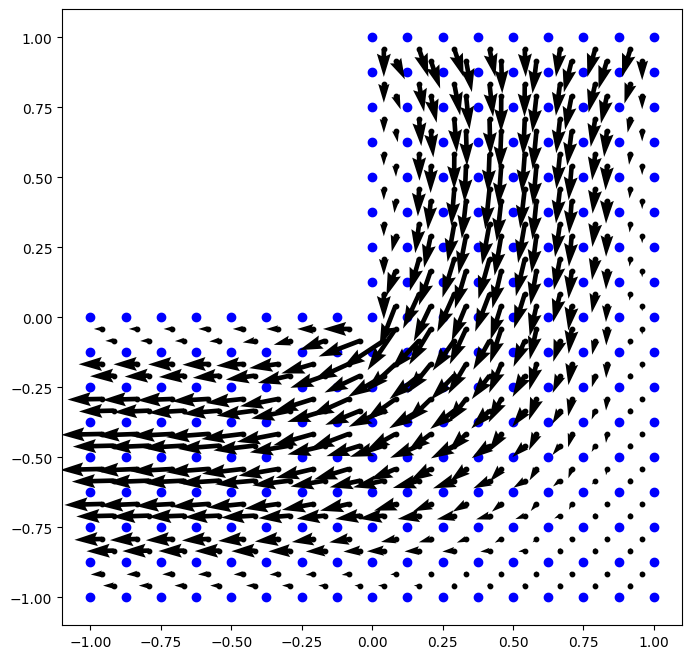

[1.131176]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.05516473e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.24441613e-03
  1.11137706e-03  0.00000000e+00 -3.42567251e-04 -3.67632411e-04
  9.47552839e-04 -2.75318299e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.80308778e-03  3.80499864e-03  0.00000000e+00  1.82685181e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88582079e-03 -1.62920311e-03
  0.00000000e+00 -5.02649974e-03  2.43806203e-03  4.24664054e-03
  4.13849852e-03  2.32642673e-03 -4.44979904e-03  4.57390164e-03
 -5.09030320e-03 -5.28010523e-04  4.44525784e-03 -5.40841479e-03
  1.78159627e-04  3.78674139e-03 -5.23044396e-03 -6.56354998e-04
  4.57323280e-03  1.96580519e-04 -5.39249692e-03  8.50559011e-04
 -5.57999784e-

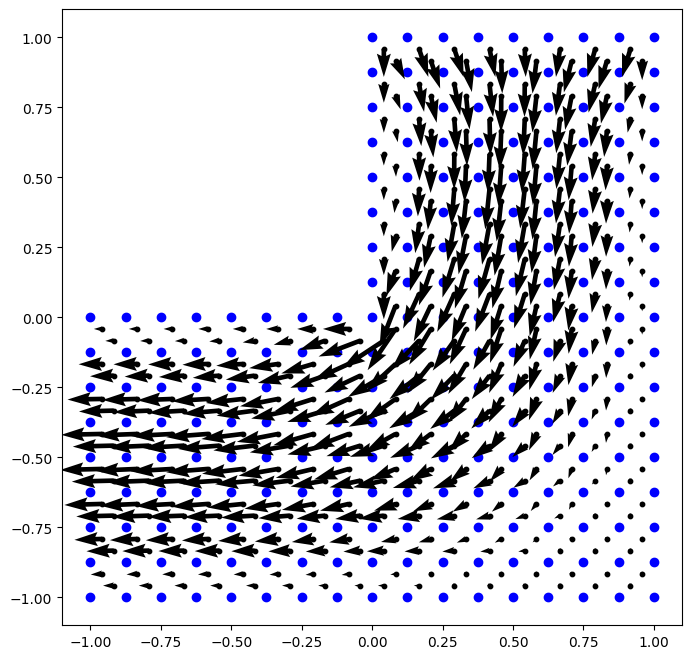

[0.26547551]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.11349341e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25282635e-03
  1.12033342e-03  0.00000000e+00 -3.44636455e-04 -3.66154814e-04
  9.56267928e-04 -2.75693112e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.79359599e-03  3.80891021e-03  0.00000000e+00  1.82306128e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88999832e-03 -1.61851520e-03
  0.00000000e+00 -5.03197498e-03  2.44150090e-03  4.25070877e-03
  4.14179562e-03  2.32978561e-03 -4.44709001e-03  4.57032089e-03
 -5.08690173e-03 -5.35770996e-04  4.44564970e-03 -5.40992500e-03
  1.81914250e-04  3.78778386e-03 -5.22621208e-03 -6.55423795e-04
  4.57562229e-03  2.01017586e-04 -5.38967627e-03  8.51305665e-04
 -5.44254194

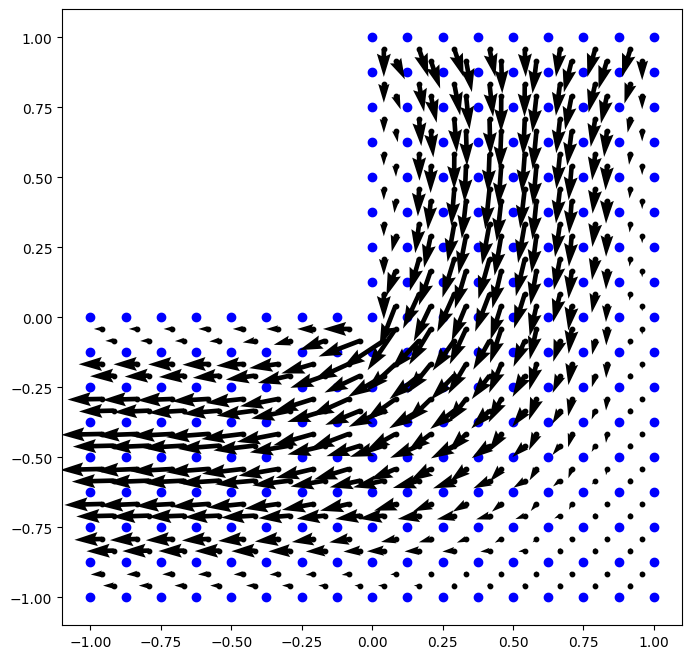

[0.62591375]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.08906822e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.24792141e-03
  1.11572067e-03  0.00000000e+00 -3.45803374e-04 -3.71587493e-04
  9.57539429e-04 -2.75282358e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.79844037e-03  3.80306243e-03  0.00000000e+00  1.82562685e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88393575e-03 -1.62369514e-03
  0.00000000e+00 -5.02747921e-03  2.43677641e-03  4.24638280e-03
  4.13866587e-03  2.32552417e-03 -4.44971781e-03  4.57386680e-03
 -5.09135737e-03 -5.33783987e-04  4.44577886e-03 -5.41006172e-03
  1.78418950e-04  3.78571142e-03 -5.23206544e-03 -6.59133210e-04
  4.57252124e-03  1.95387784e-04 -5.39391292e-03  8.49982645e-04
 -5.46932912

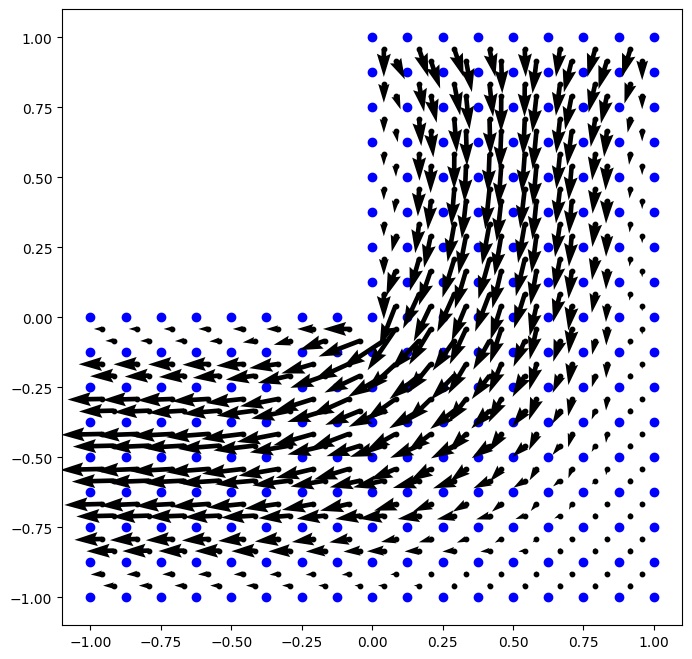

[0.20920993]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.13513284e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25493582e-03
  1.12343307e-03  0.00000000e+00 -3.47243299e-04 -3.69689366e-04
  9.64475650e-04 -2.75605264e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.79058739e-03  3.80649035e-03  0.00000000e+00  1.82258948e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88763634e-03 -1.61459806e-03
  0.00000000e+00 -5.03206398e-03  2.43982353e-03  4.24999893e-03
  4.14132703e-03  2.32860028e-03 -4.44755768e-03  4.57074072e-03
 -5.08822882e-03 -5.39851219e-04  4.44587644e-03 -5.41117799e-03
  1.81882742e-04  3.78676440e-03 -5.22819074e-03 -6.58046122e-04
  4.57479062e-03  1.99602478e-04 -5.39128413e-03  8.50712980e-04
 -5.35529264

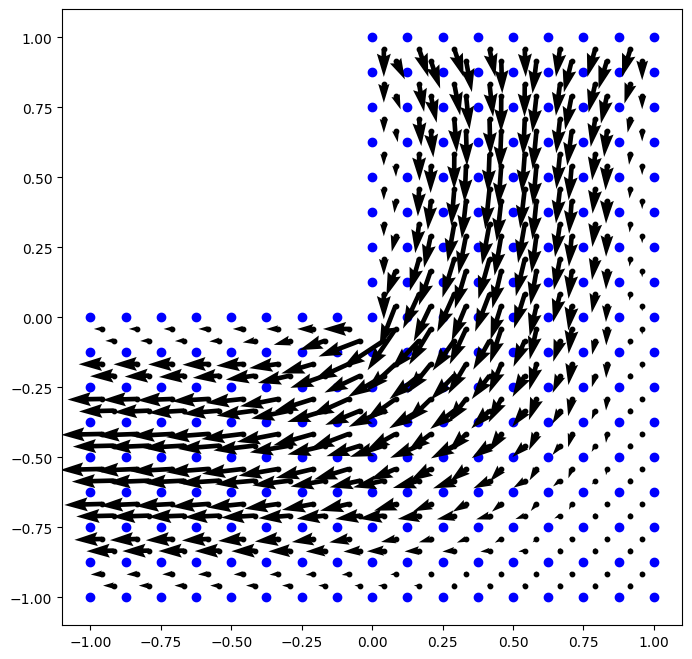

[0.41899218]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.11145702e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25041911e-03
  1.11930096e-03  0.00000000e+00 -3.47947494e-04 -3.74127226e-04
  9.64576051e-04 -2.75266941e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.79472782e-03  3.80158647e-03  0.00000000e+00  1.82478410e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88253059e-03 -1.61889302e-03
  0.00000000e+00 -5.02826888e-03  2.43577741e-03  4.24612993e-03
  4.13869284e-03  2.32488711e-03 -4.44965463e-03  4.57371046e-03
 -5.09202369e-03 -5.37611484e-04  4.44599298e-03 -5.41136073e-03
  1.78928656e-04  3.78506488e-03 -5.23315602e-03 -6.60875457e-04
  4.57203203e-03  1.94671675e-04 -5.39487026e-03  8.49484321e-04
 -5.38229469

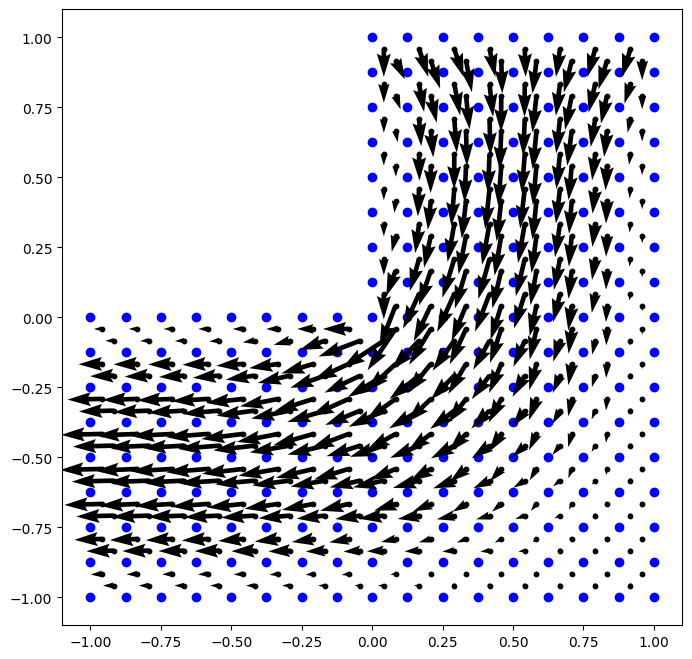

[0.17262153]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.14843438e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25634258e-03
  1.12594158e-03  0.00000000e+00 -3.48965990e-04 -3.72083084e-04
  9.70224235e-04 -2.75544282e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78822834e-03  3.80460968e-03  0.00000000e+00  1.82231679e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88582449e-03 -1.61122952e-03
  0.00000000e+00 -5.03211445e-03  2.43849745e-03  4.24936438e-03
  4.14088481e-03  2.32770194e-03 -4.44790366e-03  4.57100109e-03
 -5.08920188e-03 -5.42445065e-04  4.44592716e-03 -5.41217738e-03
  1.82063810e-04  3.78607104e-03 -5.22966289e-03 -6.59763860e-04
  4.57414458e-03  1.98584873e-04 -5.39247583e-03  8.50203268e-04
 -5.28812157

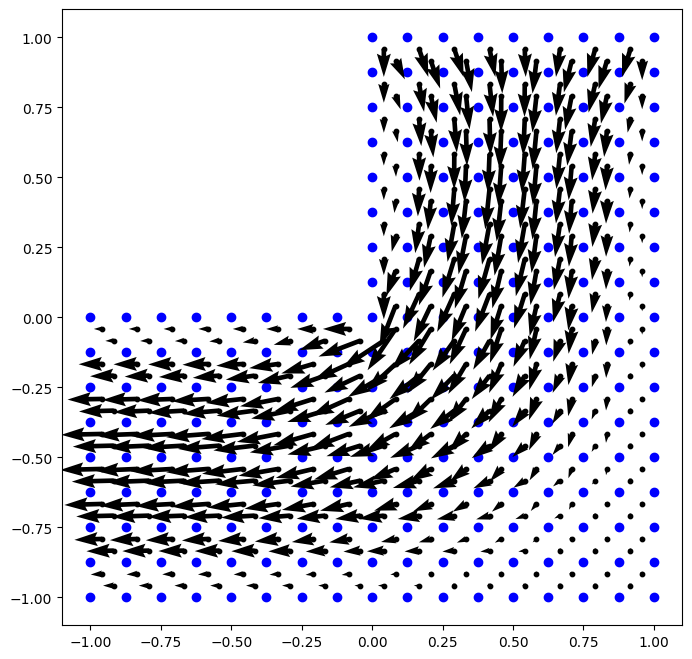

[0.30632539]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.12651510e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25225605e-03
  1.12225294e-03  0.00000000e+00 -3.49376418e-04 -3.75759302e-04
  9.69630187e-04 -2.75263318e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.79182473e-03  3.80046305e-03  0.00000000e+00  1.82418936e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88148275e-03 -1.61490321e-03
  0.00000000e+00 -5.02891095e-03  2.43501329e-03  4.24592270e-03
  4.13867557e-03  2.32444667e-03 -4.44960847e-03  4.57350863e-03
 -5.09244976e-03 -5.40198297e-04  4.44605847e-03 -5.41238392e-03
  1.79556426e-04  3.78465685e-03 -5.23389075e-03 -6.61977552e-04
  4.57170368e-03  1.94279045e-04 -5.39552393e-03  8.49075408e-04
 -5.31494148

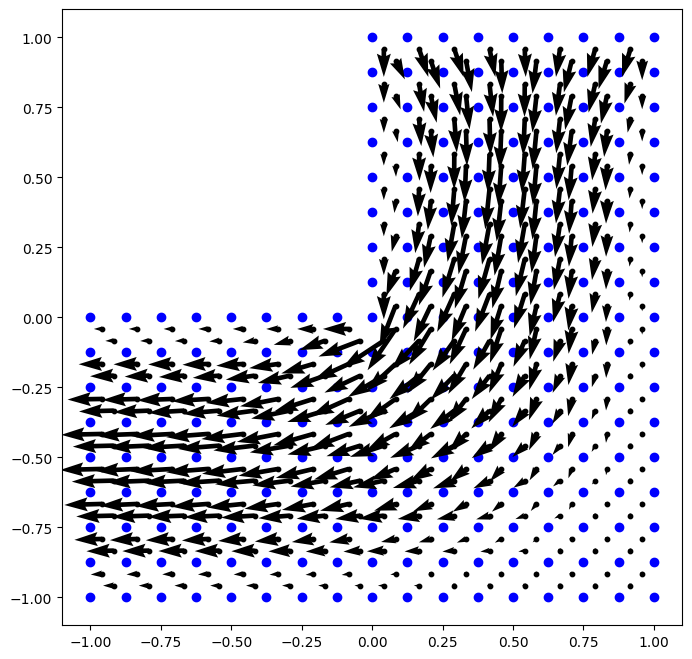

[0.14605368]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.15660688e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25729704e-03
  1.12795933e-03  0.00000000e+00 -3.50106867e-04 -3.73727161e-04
  9.74306817e-04 -2.75500873e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78642866e-03  3.80314037e-03  0.00000000e+00  1.82216395e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88442386e-03 -1.60847553e-03
  0.00000000e+00 -5.03214073e-03  2.43745130e-03  4.24882019e-03
  4.14050519e-03  2.32701465e-03 -4.44816719e-03  4.57117144e-03
 -5.08993316e-03 -5.44107773e-04  4.44590571e-03 -5.41297290e-03
  1.82351921e-04  3.78558995e-03 -5.23077342e-03 -6.60909654e-04
  4.57364298e-03  1.97851554e-04 -5.39337228e-03  8.49780002e-04
 -5.23715964

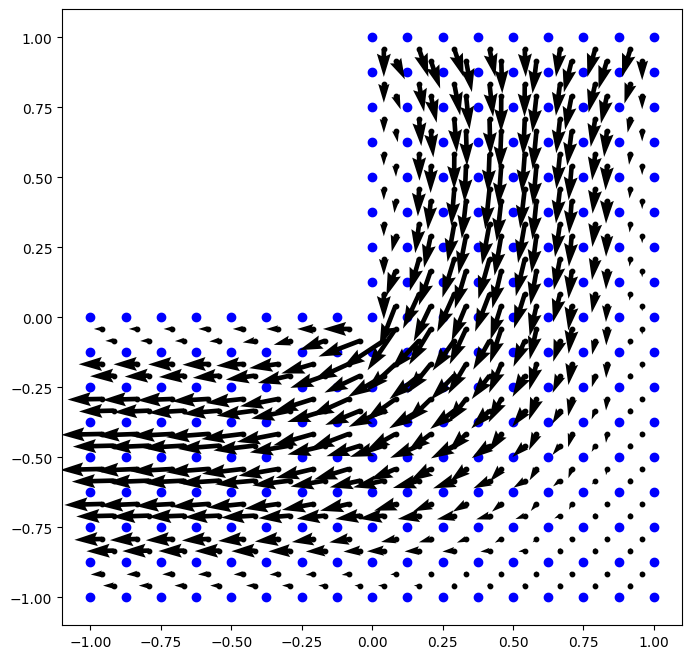

[0.23552194]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.13686350e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25363621e-03
  1.12466808e-03  0.00000000e+00 -3.50331661e-04 -3.76807458e-04
  9.73315673e-04 -2.75266130e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78957777e-03  3.79961288e-03  0.00000000e+00  1.82376007e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88070625e-03 -1.61167635e-03
  0.00000000e+00 -5.02943506e-03  2.43443709e-03  4.24576973e-03
  4.13865010e-03  2.32414885e-03 -4.44957335e-03  4.57330102e-03
 -5.09272073e-03 -5.41980804e-04  4.44605470e-03 -5.41318567e-03
  1.80209442e-04  3.78439972e-03 -5.23438333e-03 -6.62680248e-04
  4.57149010e-03  1.94095542e-04 -5.39597106e-03  8.48751265e-04
 -5.26324106

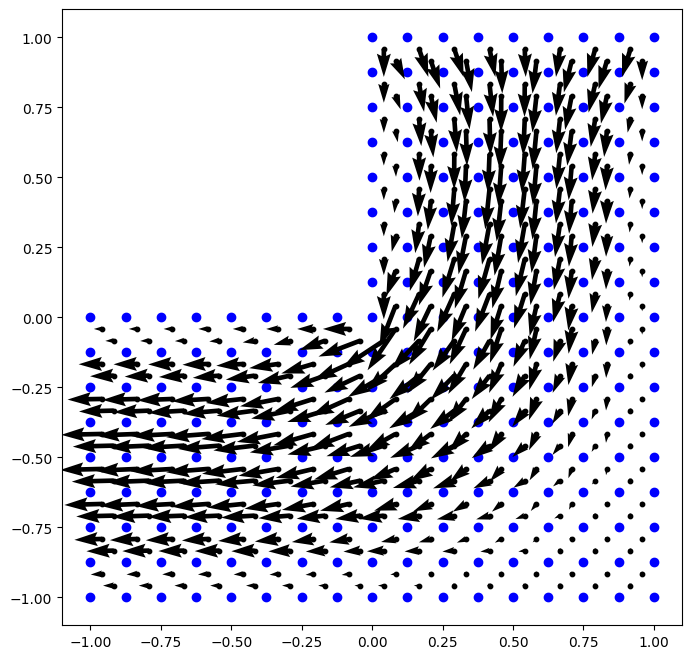

[0.12541387]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16161872e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25794837e-03
  1.12956210e-03  0.00000000e+00 -3.50862253e-04 -3.74873807e-04
  9.77235667e-04 -2.75469179e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78507874e-03  3.80198949e-03  0.00000000e+00  1.82208328e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88333590e-03 -1.60629067e-03
  0.00000000e+00 -5.03215047e-03  2.43662654e-03  4.24836325e-03
  4.14019210e-03  2.32648290e-03 -4.44837156e-03  4.57129046e-03
 -5.09049172e-03 -5.45180412e-04  4.44586040e-03 -5.41360225e-03
  1.82673911e-04  3.78524959e-03 -5.23162041e-03 -6.61688329e-04
  4.57325201e-03  1.97316883e-04 -5.39405408e-03  8.49435702e-04
 -5.19883364

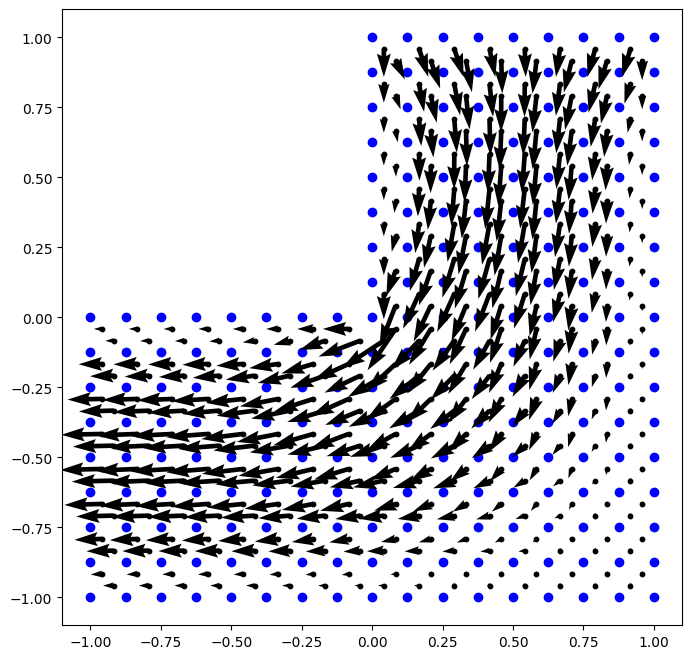

[0.18700754]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.14413764e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25468898e-03
  1.12662575e-03  0.00000000e+00 -3.50971690e-04 -3.77478388e-04
  9.76035257e-04 -2.75272192e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78784619e-03  3.79897487e-03  0.00000000e+00  1.82344341e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88013626e-03 -1.60910770e-03
  0.00000000e+00 -5.02986338e-03  2.43400881e-03  4.24566654e-03
  4.13862935e-03  2.32395337e-03 -4.44954479e-03  4.57310627e-03
 -5.09288869e-03 -5.43232366e-04  4.44602134e-03 -5.41380964e-03
  1.80830435e-04  3.78423875e-03 -5.23470951e-03 -6.63130745e-04
  4.57135677e-03  1.94041261e-04 -5.39627552e-03  8.48500513e-04
 -5.22370575

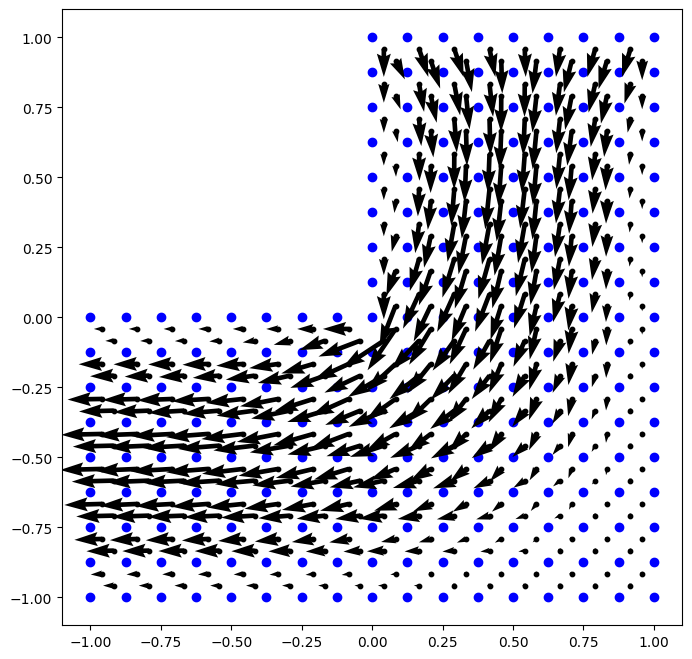

[0.10867291]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16467361e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25839138e-03
  1.13081780e-03  0.00000000e+00 -3.51361745e-04 -3.75686547e-04
  9.79351498e-04 -2.75445473e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78407804e-03  3.80108646e-03  0.00000000e+00  1.82204576e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88248728e-03 -1.60459113e-03
  0.00000000e+00 -5.03214835e-03  2.43597590e-03  4.24798355e-03
  4.13993870e-03  2.32606660e-03 -4.44853223e-03  4.57137965e-03
 -5.09092339e-03 -5.45874928e-04  4.44581280e-03 -5.41409665e-03
  1.82985334e-04  3.78500402e-03 -5.23227251e-03 -6.62227417e-04
  4.57294512e-03  1.96919866e-04 -5.39457740e-03  8.49158887e-04
 -5.17017562

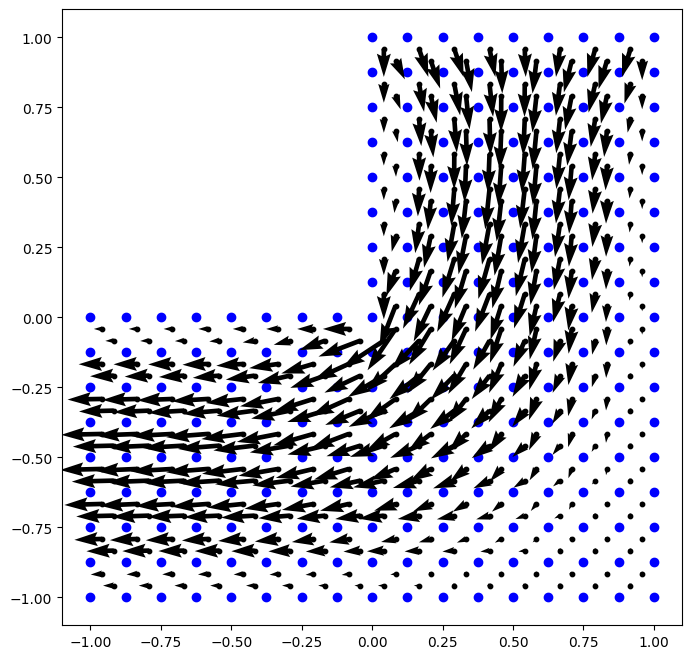

[0.15179913]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.14936552e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25550126e-03
  1.12819948e-03  0.00000000e+00 -3.51401608e-04 -3.77904691e-04
  9.78061145e-04 -2.75279638e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78651315e-03  3.79850072e-03  0.00000000e+00  1.82320512e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87972267e-03 -1.60708263e-03
  0.00000000e+00 -5.03021339e-03  2.43369531e-03  4.24560420e-03
  4.13861684e-03  2.32383058e-03 -4.44952008e-03  4.57293211e-03
 -5.09298751e-03 -5.44126983e-04  4.44597809e-03 -5.41429209e-03
  1.81389384e-04  3.78413942e-03 -5.23492096e-03 -6.63420177e-04
  4.57127864e-03  1.94062944e-04 -5.39648064e-03  8.48310240e-04
 -5.19351246

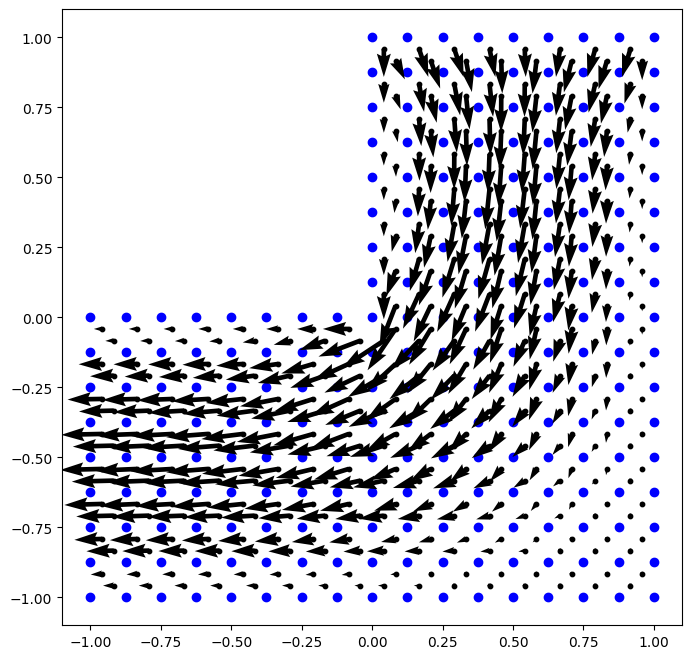

[0.09470564]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16651003e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25868907e-03
  1.13178855e-03  0.00000000e+00 -3.51691447e-04 -3.76272323e-04
  9.80886691e-04 -2.75427344e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78334316e-03  3.80037674e-03  0.00000000e+00  1.82203384e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88182264e-03 -1.60328761e-03
  0.00000000e+00 -5.03213761e-03  2.43546169e-03  4.24766944e-03
  4.13973530e-03  2.32573685e-03 -4.44865993e-03  4.57145099e-03
 -5.09126022e-03 -5.46324704e-04  4.44577157e-03 -5.41448261e-03
  1.83263031e-04  3.78482342e-03 -5.23277887e-03 -6.62607538e-04
  4.57270215e-03  1.96618476e-04 -5.39498242e-03  8.48937657e-04
 -5.14883683

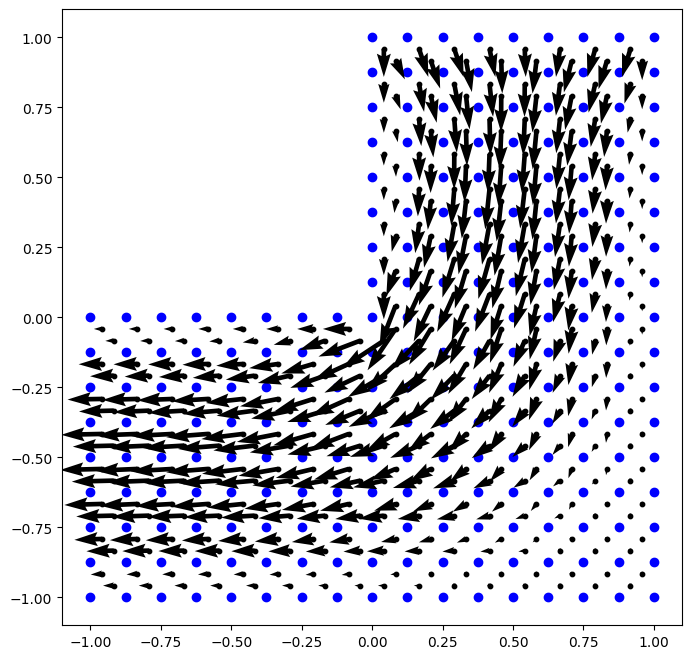

[0.12518919]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.15320175e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25613379e-03
  1.12945624e-03  0.00000000e+00 -3.51691366e-04 -3.78171920e-04
  9.79581976e-04 -2.75287399e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78548596e-03  3.79815224e-03  0.00000000e+00  1.82302264e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87942682e-03 -1.60549540e-03
  0.00000000e+00 -5.03049923e-03  2.43346977e-03  4.24557330e-03
  4.13861235e-03  2.32375896e-03 -4.44949773e-03  4.57278065e-03
 -5.09304000e-03 -5.44777265e-04  4.44593437e-03 -5.41466301e-03
  1.81874589e-04  3.78407979e-03 -5.23505333e-03 -6.63605744e-04
  4.57123800e-03  1.94126281e-04 -5.39661636e-03  8.48168332e-04
 -5.17044947

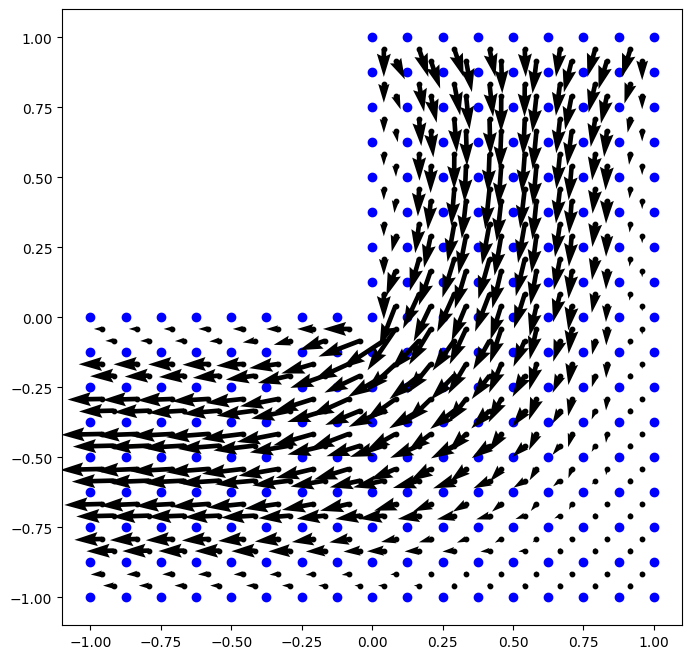

[0.08283205]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16758397e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25888465e-03
  1.13252968e-03  0.00000000e+00 -3.51908645e-04 -3.76701735e-04
  9.82003070e-04 -2.75413202e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78280816e-03  3.79981792e-03  0.00000000e+00  1.82203688e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88129992e-03 -1.60229877e-03
  0.00000000e+00 -5.03212075e-03  2.43505421e-03  4.24740985e-03
  4.13957244e-03  2.32547276e-03 -4.44876233e-03  4.57151107e-03
 -5.09152535e-03 -5.46614709e-04  4.44573915e-03 -5.41478239e-03
  1.83497798e-04  3.78468816e-03 -5.23317518e-03 -6.62880442e-04
  4.57250806e-03  1.96384242e-04 -5.39529826e-03  8.48761227e-04
 -5.13300415

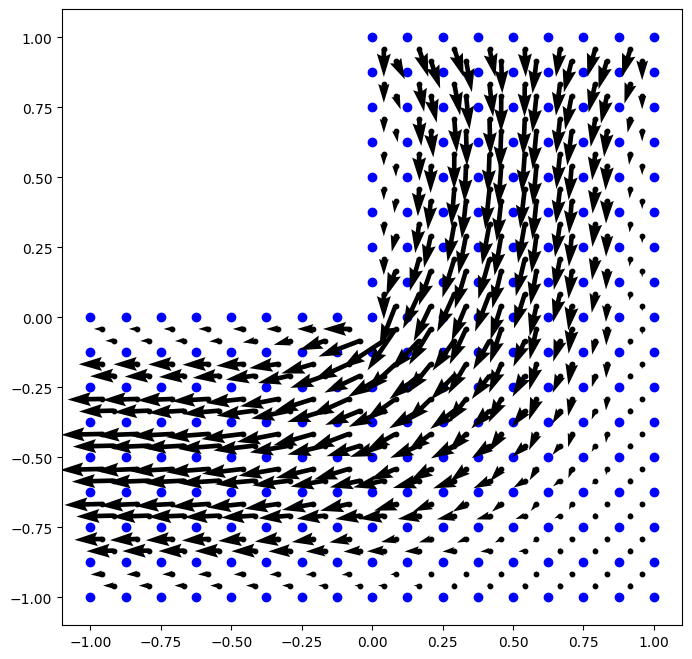

[0.10446869]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.15607024e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25663026e-03
  1.13045500e-03  0.00000000e+00 -3.51887544e-04 -3.78335564e-04
  9.80731155e-04 -2.75294891e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78469275e-03  3.79789944e-03  0.00000000e+00  1.82288081e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87921900e-03 -1.60425554e-03
  0.00000000e+00 -5.03073254e-03  2.43331094e-03  4.24556549e-03
  4.13861439e-03  2.32372297e-03 -4.44947693e-03  4.57265110e-03
 -5.09306176e-03 -5.45257328e-04  4.44589426e-03 -5.41494685e-03
  1.82285439e-04  3.78404583e-03 -5.23513143e-03 -6.63723793e-04
  4.57122242e-03  1.94209816e-04 -5.39670357e-03  8.48064327e-04
 -5.15281320

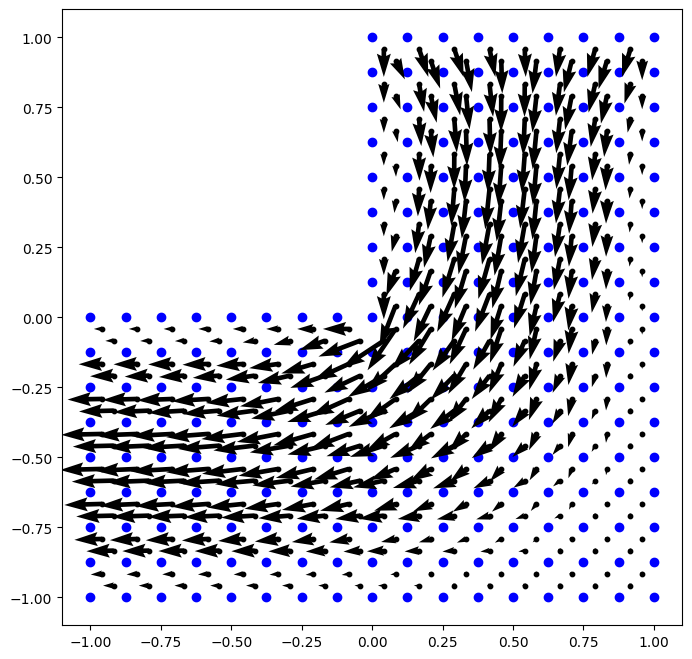

[0.07261097]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16817933e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25900837e-03
  1.13308876e-03  0.00000000e+00 -3.52051421e-04 -3.77021865e-04
  9.82815195e-04 -2.75401978e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78242219e-03  3.79937698e-03  0.00000000e+00  1.82204840e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88088705e-03 -1.60155559e-03
  0.00000000e+00 -5.03209978e-03  2.43473019e-03  4.24719512e-03
  4.13944190e-03  2.32525913e-03 -4.44884507e-03  4.57156341e-03
 -5.09173576e-03 -5.46799710e-04  4.44571528e-03 -5.41501430e-03
  1.83688709e-04  3.78458511e-03 -5.23348769e-03 -6.63079836e-04
  4.57235164e-03  1.96198002e-04 -5.39554631e-03  8.48620428e-04
 -5.12129702

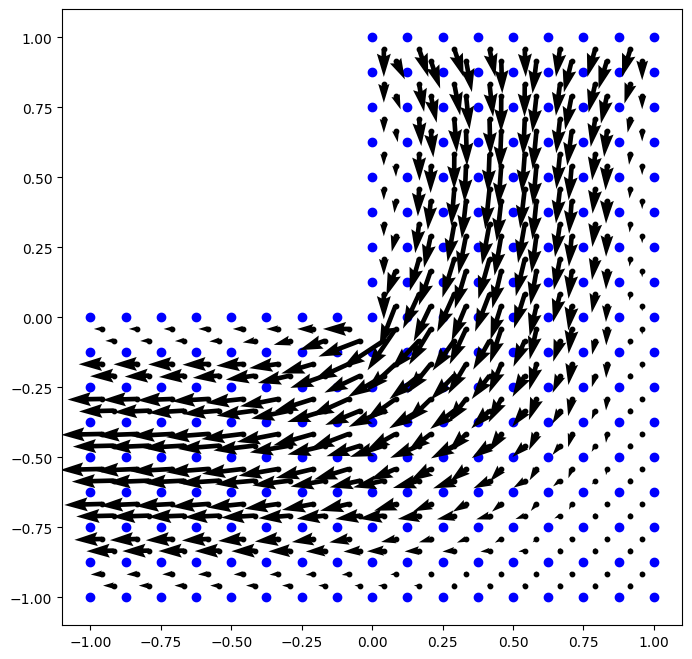

[0.08796558]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.15825091e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25702270e-03
  1.13124614e-03  0.00000000e+00 -3.52021138e-04 -3.78431790e-04
  9.81604542e-04 -2.75301817e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78407841e-03  3.79771894e-03  0.00000000e+00  1.82276918e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87907651e-03 -1.60328869e-03
  0.00000000e+00 -5.03092288e-03  2.43320218e-03  4.24557395e-03
  4.13862129e-03  2.32371142e-03 -4.44945733e-03  4.57254137e-03
 -5.09306354e-03 -5.45616784e-04  4.44585919e-03 -5.41516318e-03
  1.82627322e-04  3.78402843e-03 -5.23517257e-03 -6.63797683e-04
  4.57122326e-03  1.94300550e-04 -5.39675693e-03  8.47989581e-04
 -5.13930318

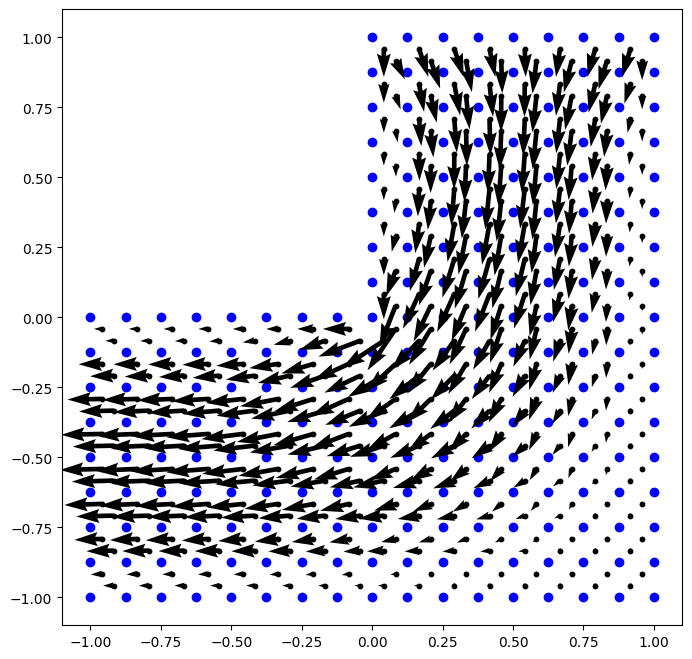

[0.06373837]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16847450e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25908169e-03
  1.13350553e-03  0.00000000e+00 -3.52145054e-04 -3.77264452e-04
  9.83405201e-04 -2.75392939e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78214664e-03  3.79902817e-03  0.00000000e+00  1.82206439e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88055946e-03 -1.60100184e-03
  0.00000000e+00 -5.03207633e-03  2.43447150e-03  4.24701712e-03
  4.13933697e-03  2.32508475e-03 -4.44891236e-03  4.57160988e-03
 -5.09190403e-03 -5.46915398e-04  4.44569862e-03 -5.41519318e-03
  1.83839240e-04  3.78450535e-03 -5.23373588e-03 -6.63228001e-04
  4.57222449e-03  1.96046844e-04 -5.39574242e-03  8.48507751e-04
 -5.11267231

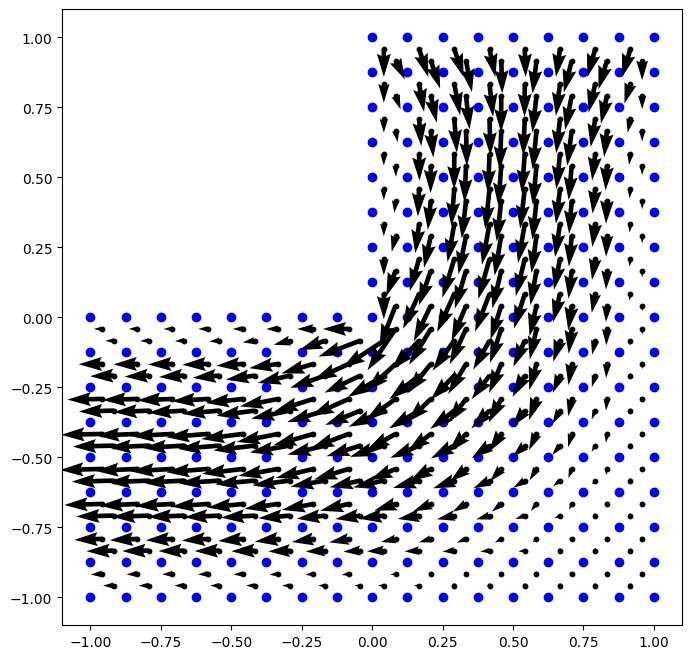

[0.0745899]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.15993261e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25733498e-03
  1.13187165e-03  0.00000000e+00 -3.52112760e-04 -3.78484279e-04
  9.82271880e-04 -2.75308052e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78360096e-03  3.79759263e-03  0.00000000e+00  1.82268040e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87898207e-03 -1.60253507e-03
  0.00000000e+00 -5.03107816e-03  2.43313059e-03  4.24559331e-03
  4.13863150e-03  2.32371629e-03 -4.44943882e-03  4.57244895e-03
 -5.09305274e-03 -5.45889414e-04  4.44582931e-03 -5.41532750e-03
  1.82908351e-04  3.78402165e-03 -5.23518885e-03 -6.63842583e-04
  4.57123451e-03  1.94390906e-04 -5.39678686e-03  8.47937148e-04
 -5.12893126e

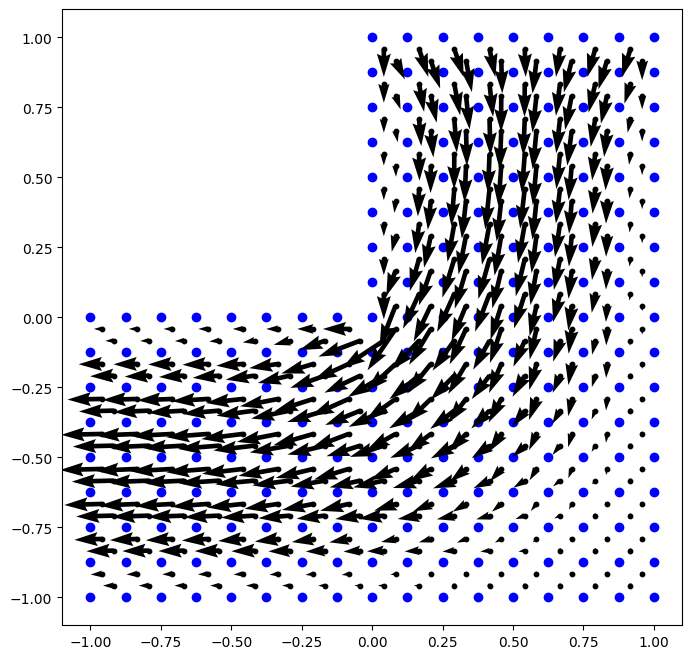

[0.05599341]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16858266e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25911998e-03
  1.13381239e-03  0.00000000e+00 -3.52206291e-04 -3.77451150e-04
  9.83832546e-04 -2.75385571e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78195247e-03  3.79875143e-03  0.00000000e+00  1.82208241e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88029832e-03 -1.60059275e-03
  0.00000000e+00 -5.03205167e-03  2.43426403e-03  4.24686913e-03
  4.13925228e-03  2.32494123e-03 -4.44896742e-03  4.57165151e-03
 -5.09203961e-03 -5.46985264e-04  4.44568763e-03 -5.41533086e-03
  1.83954808e-04  3.78444269e-03 -5.23393431e-03 -6.63339878e-04
  4.57212031e-03  1.95921994e-04 -5.39589846e-03  8.48417183e-04
 -5.10634543

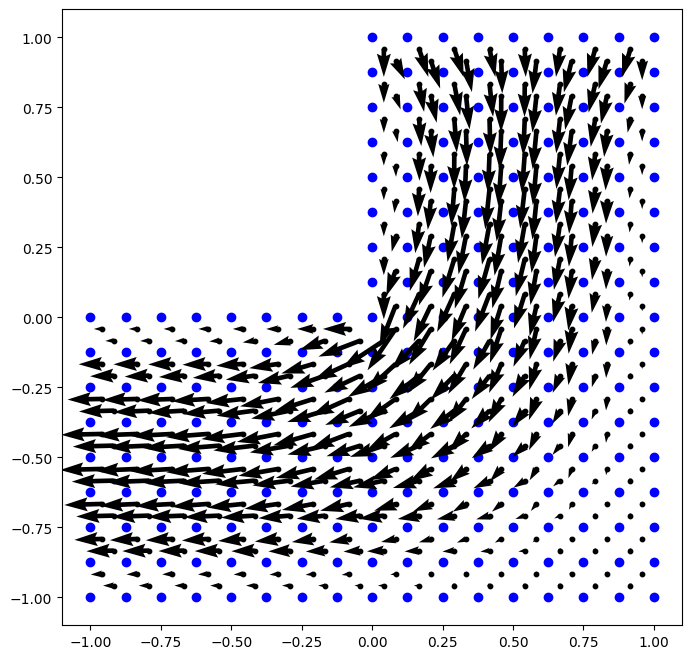

[0.06359915]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16124552e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25758506e-03
  1.13236586e-03  0.00000000e+00 -3.52176119e-04 -3.78508598e-04
  9.82784399e-04 -2.75313568e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78322846e-03  3.79750657e-03  0.00000000e+00  1.82260915e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87892262e-03 -1.60194739e-03
  0.00000000e+00 -5.03120487e-03  2.43308627e-03  4.24561952e-03
  4.13864379e-03  2.32373184e-03 -4.44942139e-03  4.57237133e-03
 -5.09303440e-03 -5.46098598e-04  4.44580424e-03 -5.41545192e-03
  1.83137405e-04  3.78402158e-03 -5.23518875e-03 -6.63868434e-04
  4.57125202e-03  1.94476718e-04 -5.39680071e-03  8.47901543e-04
 -5.12094810

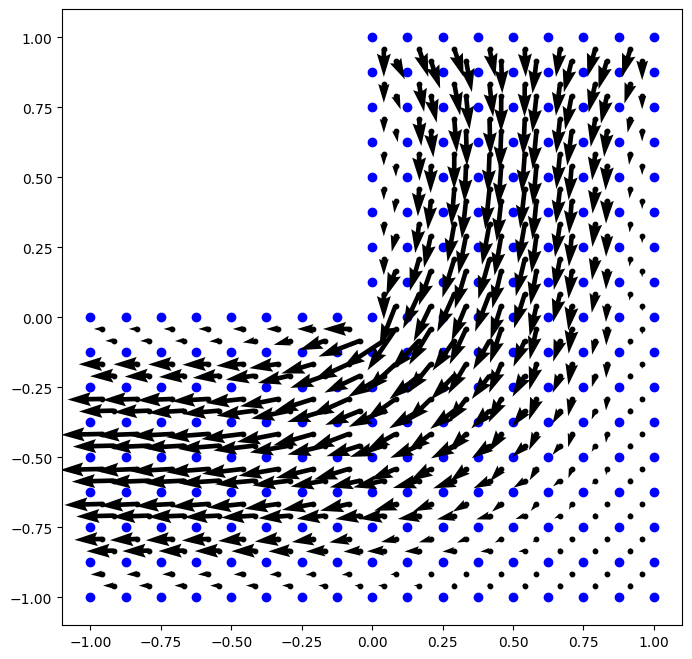

[0.04920827]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16857622e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25913423e-03
  1.13403527e-03  0.00000000e+00 -3.52246210e-04 -3.77596924e-04
  9.84140572e-04 -2.75379505e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78181793e-03  3.79853113e-03  0.00000000e+00  1.82210093e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.88008909e-03 -1.60029327e-03
  0.00000000e+00 -5.03202683e-03  2.43409681e-03  4.24674568e-03
  4.13918358e-03  2.32482225e-03 -4.44901272e-03  4.57168886e-03
 -5.09214963e-03 -5.47024904e-04  4.44568089e-03 -5.41543669e-03
  1.84041335e-04  3.78439282e-03 -5.23409400e-03 -6.63425635e-04
  4.57203432e-03  1.95817398e-04 -5.39602340e-03  8.48343979e-04
 -5.10172789

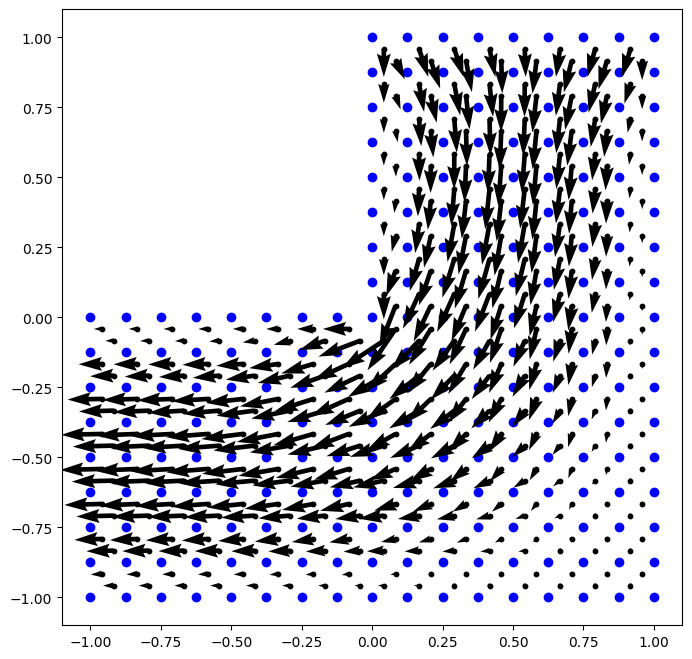

[0.05446887]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16228133e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25778657e-03
  1.13275647e-03  0.00000000e+00 -3.52220338e-04 -3.78515013e-04
  9.83180014e-04 -2.75318390e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78293662e-03  3.79745013e-03  0.00000000e+00  1.82255153e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87888832e-03 -1.60148854e-03
  0.00000000e+00 -5.03130835e-03  2.43306169e-03  4.24564960e-03
  4.13865720e-03  2.32375397e-03 -4.44940508e-03  4.57230621e-03
 -5.09301197e-03 -5.46260782e-04  4.44578338e-03 -5.41554585e-03
  1.83323042e-04  3.78402565e-03 -5.23517819e-03 -6.63881807e-04
  4.57127298e-03  1.94555914e-04 -5.39680373e-03  8.47878491e-04
 -5.11478587

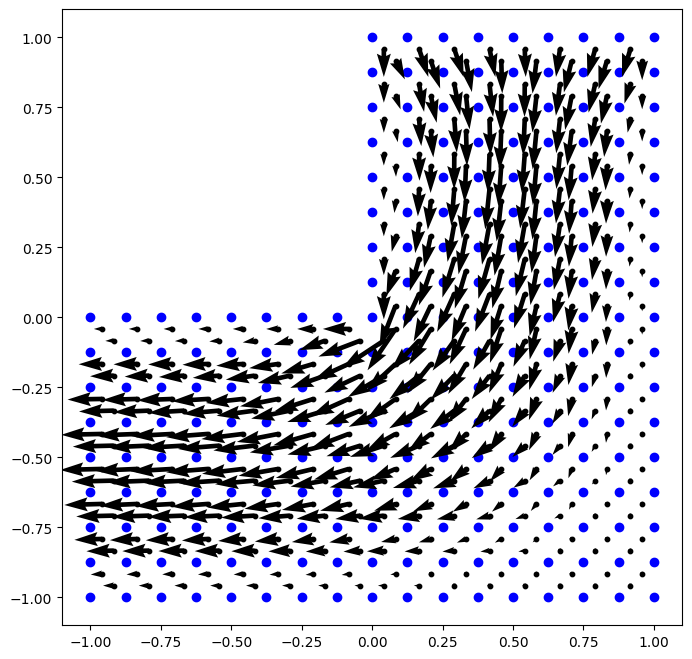

[0.04325045]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16850179e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25913235e-03
  1.13419461e-03  0.00000000e+00 -3.52272130e-04 -3.77712262e-04
  9.84361043e-04 -2.75374472e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78172682e-03  3.79835510e-03  0.00000000e+00  1.82211904e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87992060e-03 -1.60007630e-03
  0.00000000e+00 -5.03200254e-03  2.43396132e-03  4.24664233e-03
  4.13912756e-03  2.32472297e-03 -4.44905019e-03  4.57172233e-03
 -5.09223950e-03 -5.47044742e-04  4.44567719e-03 -5.41551799e-03
  1.84104466e-04  3.78435264e-03 -5.23422331e-03 -6.63492297e-04
  4.57196285e-03  1.95728794e-04 -5.39612405e-03  8.48284427e-04
 -5.09837909

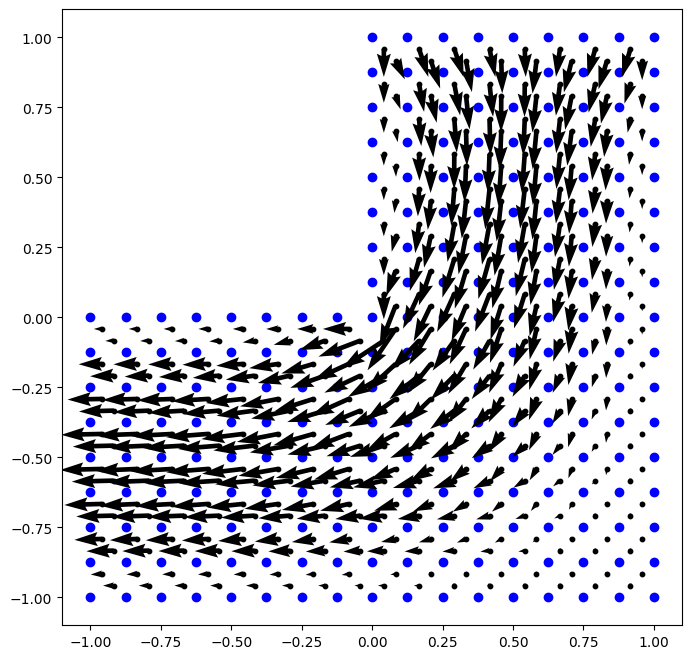

[0.04681715]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16310592e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25794991e-03
  1.13306558e-03  0.00000000e+00 -3.52251503e-04 -3.78510308e-04
  9.83486957e-04 -2.75322573e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78270695e-03  3.79741525e-03  0.00000000e+00  1.82250462e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87887185e-03 -1.60112962e-03
  0.00000000e+00 -5.03139294e-03  2.43305114e-03  4.24568137e-03
  4.13867102e-03  2.32377979e-03 -4.44938993e-03  4.57225157e-03
 -5.09298774e-03 -5.46387705e-04  4.44576612e-03 -5.41561655e-03
  1.83472976e-04  3.78403213e-03 -5.23516126e-03 -6.63887071e-04
  4.57129547e-03  1.94627681e-04 -5.39679964e-03  8.47864693e-04
 -5.11001411

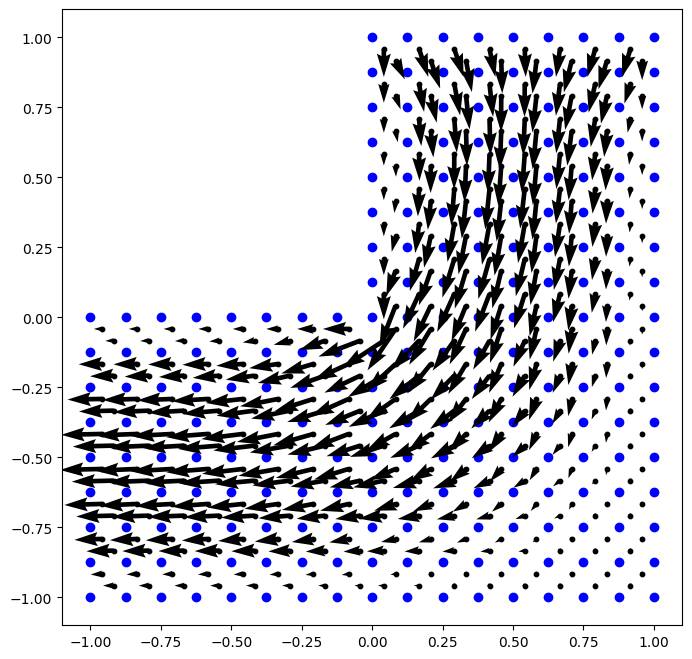

[0.038012]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16838945e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25911998e-03
  1.13430631e-03  0.00000000e+00 -3.52288879e-04 -3.77804618e-04
  9.84517317e-04 -2.75370270e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78166712e-03  3.79821387e-03  0.00000000e+00  1.82213621e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87978419e-03 -1.59992102e-03
  0.00000000e+00 -5.03197935e-03  2.43385092e-03  4.24655550e-03
  4.13908163e-03  2.32463962e-03 -4.44908134e-03  4.57175221e-03
 -5.09231337e-03 -5.47051780e-04  4.44567561e-03 -5.41558044e-03
  1.84149196e-04  3.78431992e-03 -5.23432864e-03 -6.63544786e-04
  4.57190310e-03  1.95653102e-04 -5.39620560e-03  8.48235638e-04
 -5.09596962e-

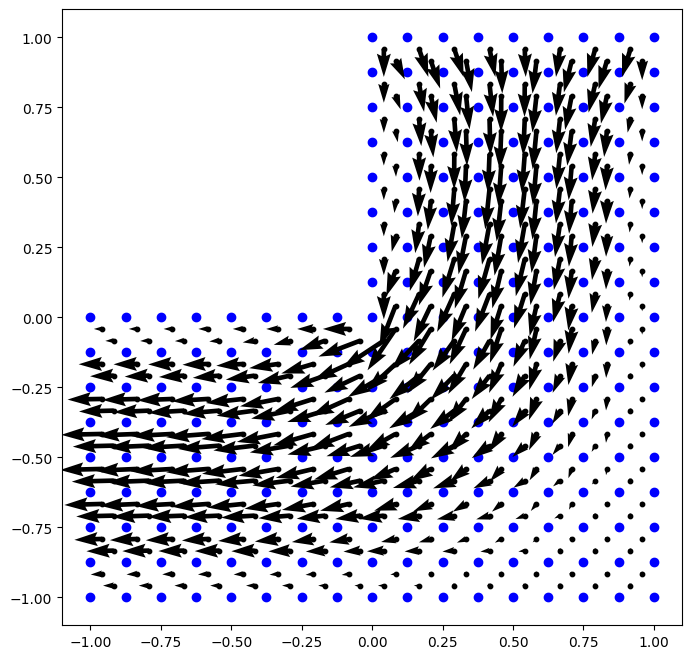

[0.04035867]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16376749e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25808308e-03
  1.13331068e-03  0.00000000e+00 -3.52273688e-04 -3.78498964e-04
  9.83726356e-04 -2.75326179e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78252537e-03  3.79739583e-03  0.00000000e+00  1.82246621e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87886775e-03 -1.60084819e-03
  0.00000000e+00 -5.03146219e-03  2.43305036e-03  4.24571335e-03
  4.13868475e-03  2.32380730e-03 -4.44937595e-03  4.57220570e-03
 -5.09296320e-03 -5.46487868e-04  4.44575187e-03 -5.41566961e-03
  1.83593869e-04  3.78403991e-03 -5.23514080e-03 -6.63887152e-04
  4.57131822e-03  1.94691935e-04 -5.39679107e-03  8.47857624e-04
 -5.10630627

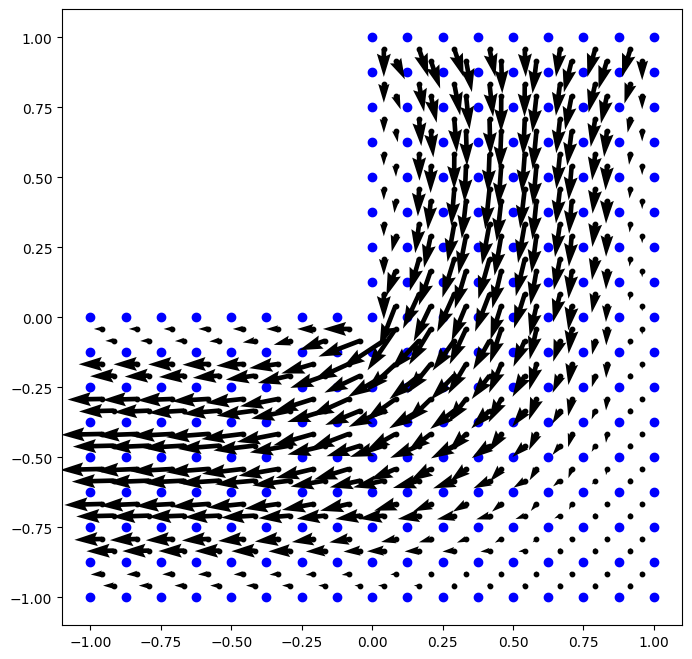

[0.03340277]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16825857e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25910113e-03
  1.13438265e-03  0.00000000e+00 -3.52299638e-04 -3.77879367e-04
  9.84626613e-04 -2.75366745e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78162994e-03  3.79810004e-03  0.00000000e+00  1.82215214e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87967315e-03 -1.59981157e-03
  0.00000000e+00 -5.03195760e-03  2.43376045e-03  4.24648228e-03
  4.13904377e-03  2.32456927e-03 -4.44910737e-03  4.57177880e-03
 -5.09237445e-03 -5.47050728e-04  4.44567545e-03 -5.41562844e-03
  1.84179748e-04  3.78429302e-03 -5.23441492e-03 -6.63586604e-04
  4.57185286e-03  1.95588036e-04 -5.39627206e-03  8.48195373e-04
 -5.09425348

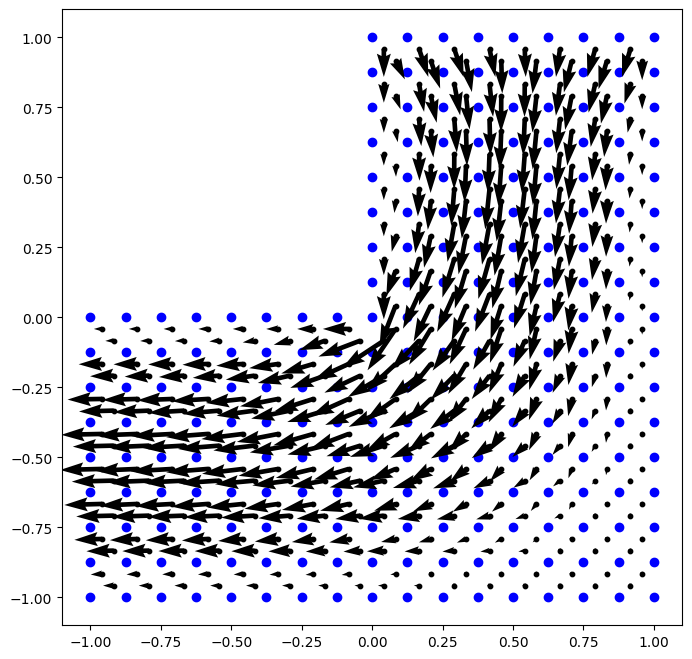

[0.03487545]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16430187e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25819229e-03
  1.13350555e-03  0.00000000e+00 -3.52289631e-04 -3.78483934e-04
  9.83914087e-04 -2.75329277e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78238110e-03  3.79738734e-03  0.00000000e+00  1.82243459e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87887202e-03 -1.60062687e-03
  0.00000000e+00 -5.03151897e-03  2.43305619e-03  4.24574450e-03
  4.13869803e-03  2.32383510e-03 -4.44936315e-03  4.57216715e-03
 -5.09293932e-03 -5.46567510e-04  4.44574014e-03 -5.41570929e-03
  1.83691321e-04  3.78404825e-03 -5.23511875e-03 -6.63884009e-04
  4.57134040e-03  1.94748997e-04 -5.39677986e-03  8.47855365e-04
 -5.10341434

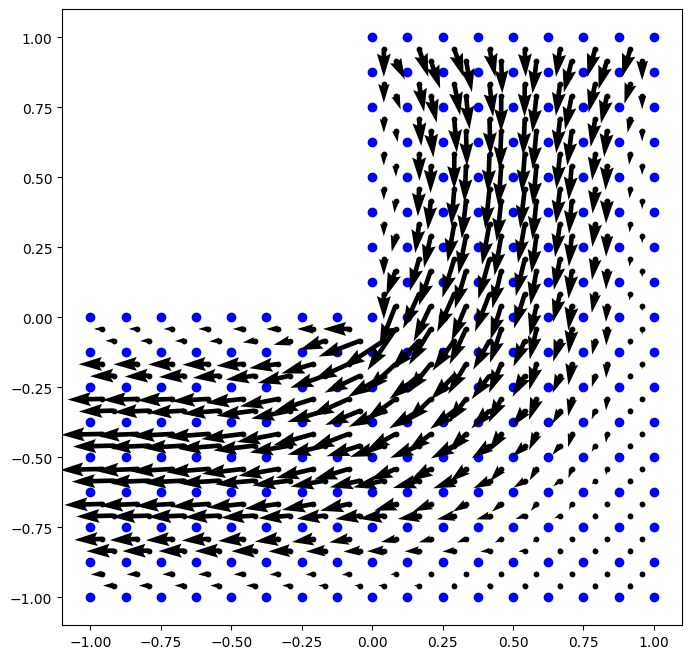

[0.02934602]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16812150e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25907861e-03
  1.13443299e-03  0.00000000e+00 -3.52306503e-04 -3.77940444e-04
  9.84701642e-04 -2.75363777e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78160873e-03  3.79800788e-03  0.00000000e+00  1.82216671e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87958228e-03 -1.59973595e-03
  0.00000000e+00 -5.03193750e-03  2.43368590e-03  4.24642033e-03
  4.13901237e-03  2.32450962e-03 -4.44912920e-03  4.57180234e-03
 -5.09242523e-03 -5.47044759e-04  4.44567618e-03 -5.41566540e-03
  1.84199578e-04  3.78427072e-03 -5.23448598e-03 -6.63620277e-04
  4.57181042e-03  1.95531850e-04 -5.39632652e-03  8.48161896e-04
 -5.09304726

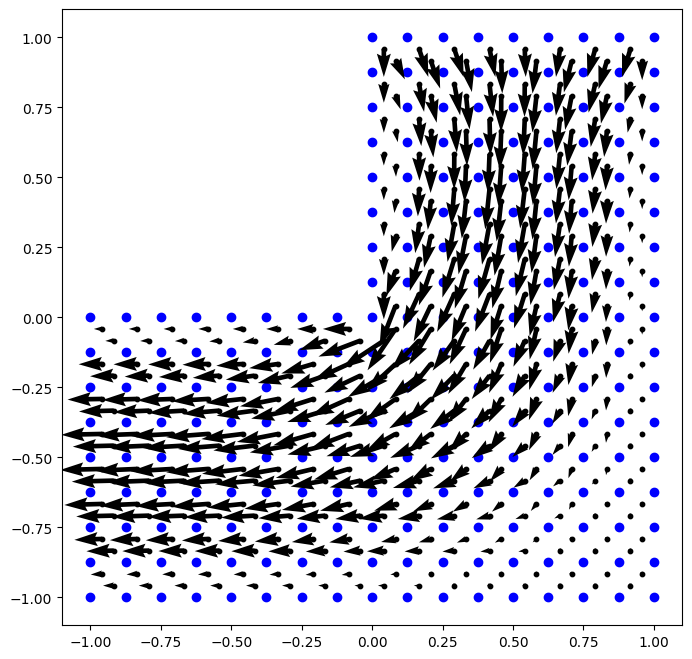

[0.03019786]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16473608e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25828232e-03
  1.13366097e-03  0.00000000e+00 -3.52301190e-04 -3.78467150e-04
  9.84062131e-04 -2.75331932e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78226591e-03  3.79738639e-03  0.00000000e+00  1.82240846e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87888172e-03 -1.60045224e-03
  0.00000000e+00 -5.03156561e-03  2.43306629e-03  4.24577416e-03
  4.13871065e-03  2.32386228e-03 -4.44935149e-03  4.57213471e-03
 -5.09291668e-03 -5.46631263e-04  4.44573049e-03 -5.41573885e-03
  1.83769950e-04  3.78405665e-03 -5.23509639e-03 -6.63878957e-04
  4.57136150e-03  1.94799389e-04 -5.39676728e-03  8.47856467e-04
 -5.10114969

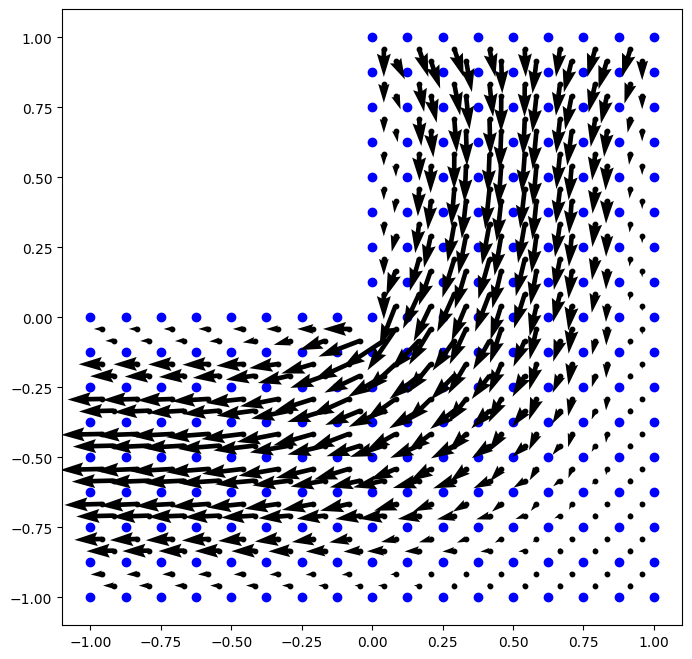

[0.02577555]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16798597e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25905441e-03
  1.13446441e-03  0.00000000e+00 -3.52310852e-04 -3.77990771e-04
  9.84751789e-04 -2.75361270e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78159869e-03  3.79793288e-03  0.00000000e+00  1.82217987e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87950751e-03 -1.59968510e-03
  0.00000000e+00 -5.03191917e-03  2.43362412e-03  4.24636774e-03
  4.13898620e-03  2.32445880e-03 -4.44914759e-03  4.57182311e-03
 -5.09246767e-03 -5.47035994e-04  4.44567745e-03 -5.41569390e-03
  1.84211448e-04  3.78425210e-03 -5.23454481e-03 -6.63647652e-04
  4.57177441e-03  1.95483172e-04 -5.39637138e-03  8.48133858e-04
 -5.09221437

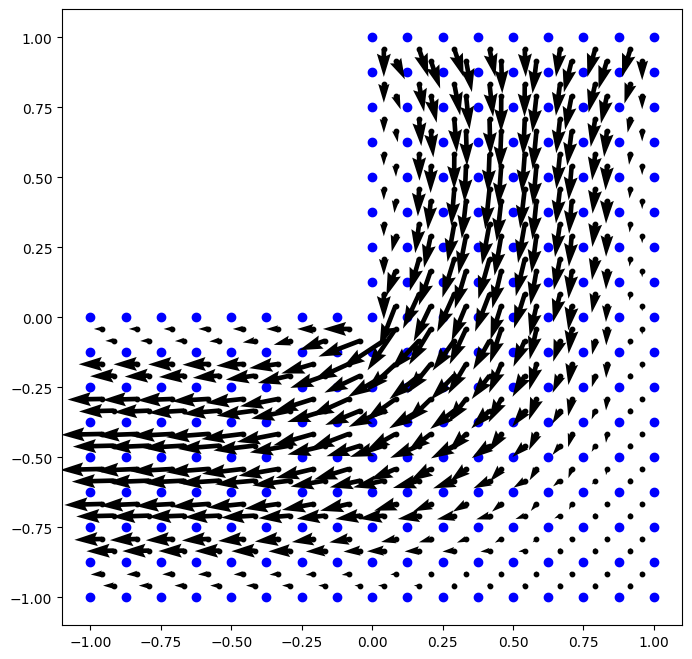

[0.02619164]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16509076e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25835694e-03
  1.13378540e-03  0.00000000e+00 -3.52309630e-04 -3.78449861e-04
  9.84179556e-04 -2.75334201e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78217344e-03  3.79739051e-03  0.00000000e+00  1.82238677e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87889474e-03 -1.60031394e-03
  0.00000000e+00 -5.03160400e-03  2.43307897e-03  4.24580194e-03
  4.13872246e-03  2.32388824e-03 -4.44934094e-03  4.57210738e-03
 -5.09289559e-03 -5.46682606e-04  4.44572257e-03 -5.41576075e-03
  1.83833512e-04  3.78406482e-03 -5.23507456e-03 -6.63872876e-04
  4.57138123e-03  1.94843724e-04 -5.39675422e-03  8.47859849e-04
 -5.09936863

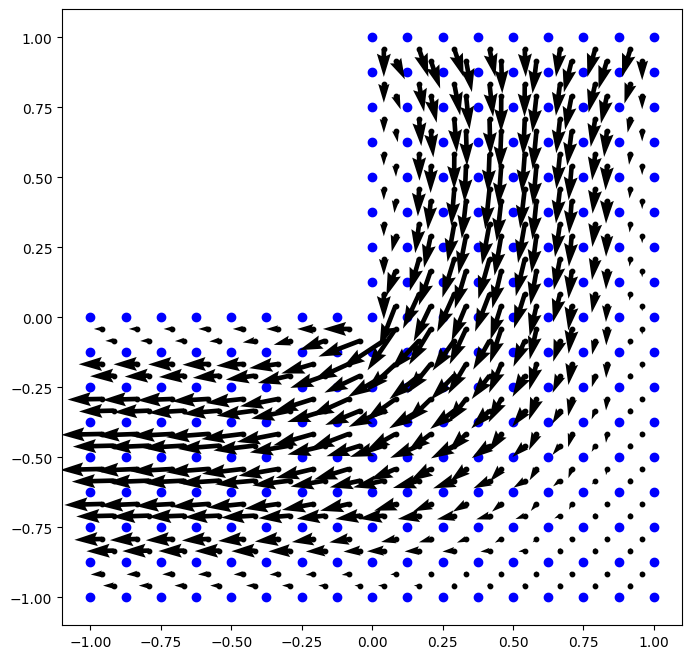

[0.02263365]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16785665e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25902984e-03
  1.13448227e-03  0.00000000e+00 -3.52313588e-04 -3.78032546e-04
  9.84783985e-04 -2.75359148e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78159630e-03  3.79787154e-03  0.00000000e+00  1.82219166e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87944566e-03 -1.59965224e-03
  0.00000000e+00 -5.03190260e-03  2.43357264e-03  4.24632295e-03
  4.13896426e-03  2.32441535e-03 -4.44916315e-03  4.57184136e-03
 -5.09250330e-03 -5.47025844e-04  4.44567898e-03 -5.41571595e-03
  1.84217518e-04  3.78423645e-03 -5.23459375e-03 -6.63670099e-04
  4.57174374e-03  1.95440901e-04 -5.39640853e-03  8.48110212e-04
 -5.09165330

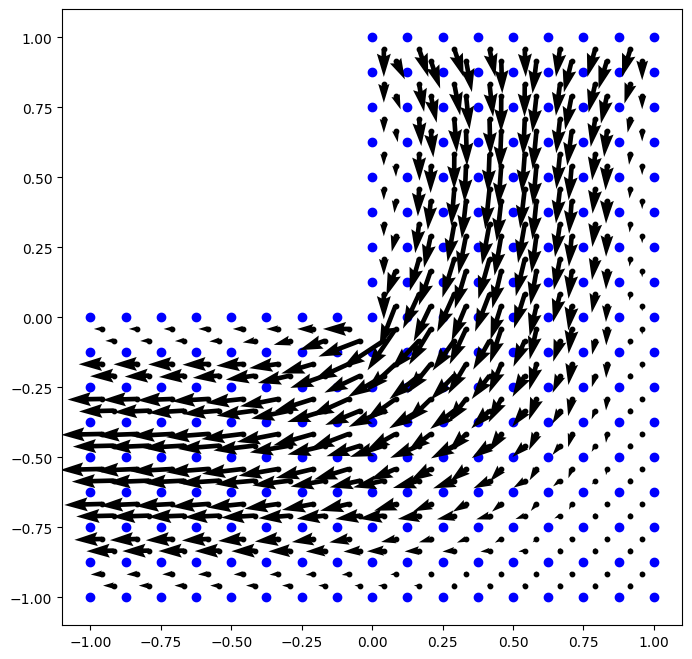

[0.02274908]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16538182e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25841910e-03
  1.13388542e-03  0.00000000e+00 -3.52315826e-04 -3.78432855e-04
  9.84273253e-04 -2.75336138e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78209884e-03  3.79739788e-03  0.00000000e+00  1.82236870e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87890958e-03 -1.60020396e-03
  0.00000000e+00 -5.03163564e-03  2.43309302e-03  4.24582762e-03
  4.13873340e-03  2.32391263e-03 -4.44933143e-03  4.57208433e-03
 -5.09287621e-03 -5.46724181e-04  4.44571606e-03 -5.41577690e-03
  1.83885032e-04  3.78407258e-03 -5.23505379e-03 -6.63866347e-04
  4.57139943e-03  1.94882625e-04 -5.39674126e-03  8.47864705e-04
 -5.09796149

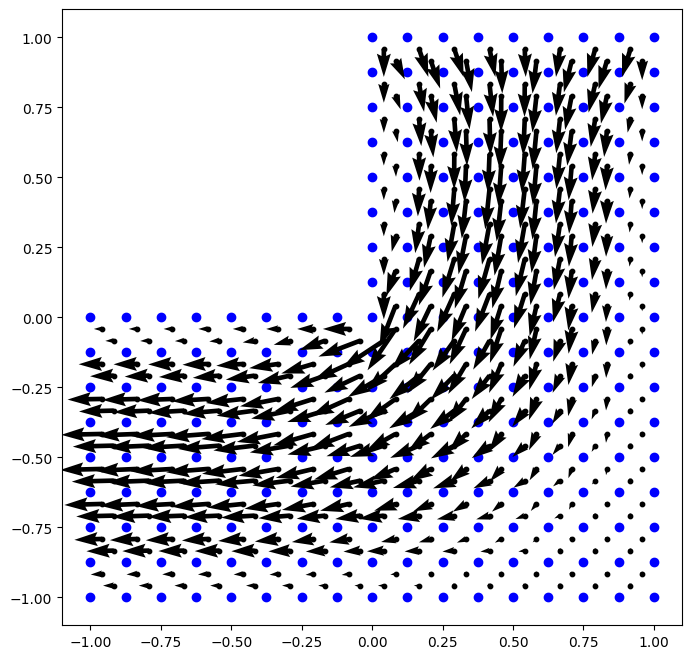

[0.0198697]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16773617e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25900581e-03
  1.13449055e-03  0.00000000e+00 -3.52315305e-04 -3.78067449e-04
  9.84803337e-04 -2.75357349e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78159902e-03  3.79782112e-03  0.00000000e+00  1.82220215e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87939425e-03 -1.59963231e-03
  0.00000000e+00 -5.03188776e-03  2.43352951e-03  4.24628470e-03
  4.13894579e-03  2.32437807e-03 -4.44917636e-03  4.57185735e-03
 -5.09253334e-03 -5.47015232e-04  4.44568060e-03 -5.41573307e-03
  1.84219458e-04  3.78422322e-03 -5.23463464e-03 -6.63688646e-04
  4.57171752e-03  1.95404133e-04 -5.39643944e-03  8.48090139e-04
 -5.09128876e

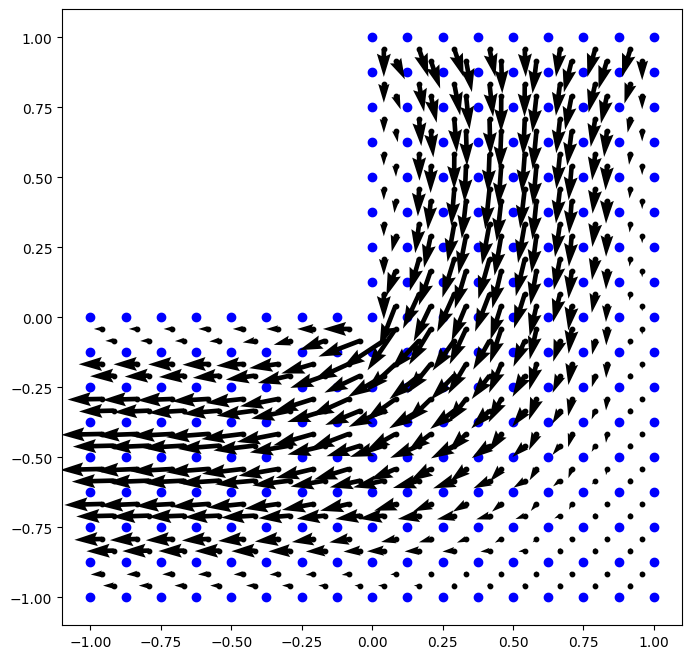

[0.01978269]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16562166e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25847111e-03
  1.13396618e-03  0.00000000e+00 -3.52320387e-04 -3.78416613e-04
  9.84348474e-04 -2.75337791e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78203833e-03  3.79740719e-03  0.00000000e+00  1.82235360e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87892517e-03 -1.60011612e-03
  0.00000000e+00 -5.03166179e-03  2.43310758e-03  4.24585114e-03
  4.13874345e-03  2.32393525e-03 -4.44932290e-03  4.57206486e-03
 -5.09285857e-03 -5.46758009e-04  4.44571073e-03 -5.41578871e-03
  1.83926932e-04  3.78407981e-03 -5.23503438e-03 -6.63859753e-04
  4.57141607e-03  1.94916699e-04 -5.39672878e-03  8.47870445e-04
 -5.09684443

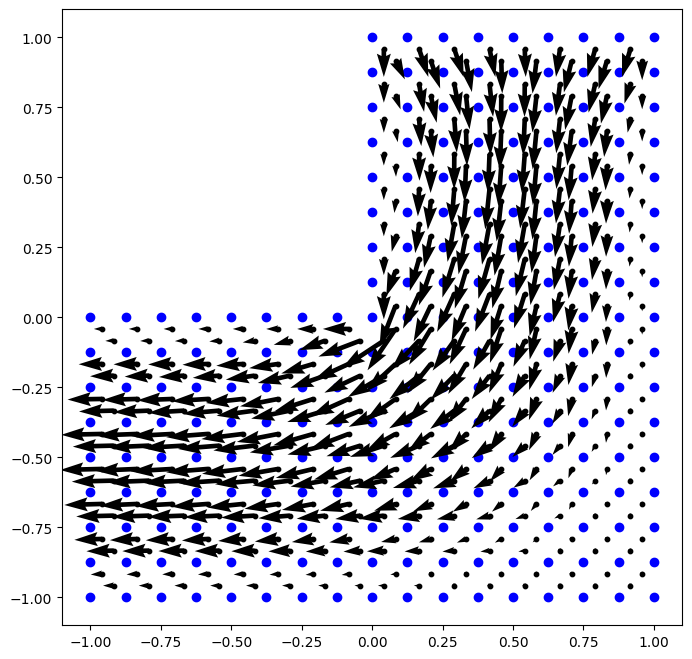

[0.0174391]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16762583e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25898287e-03
  1.13449219e-03  0.00000000e+00 -3.52316388e-04 -3.78096775e-04
  9.84813604e-04 -2.75355821e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78160501e-03  3.79777946e-03  0.00000000e+00  1.82221143e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87935130e-03 -1.59962155e-03
  0.00000000e+00 -5.03187457e-03  2.43349320e-03  4.24625195e-03
  4.13893015e-03  2.32434597e-03 -4.44918760e-03  4.57187130e-03
 -5.09255877e-03 -5.47004747e-04  4.44568221e-03 -5.41574641e-03
  1.84218533e-04  3.78421199e-03 -5.23466896e-03 -6.63704077e-04
  4.57169505e-03  1.95372114e-04 -5.39646527e-03  8.48072997e-04
 -5.09106506e

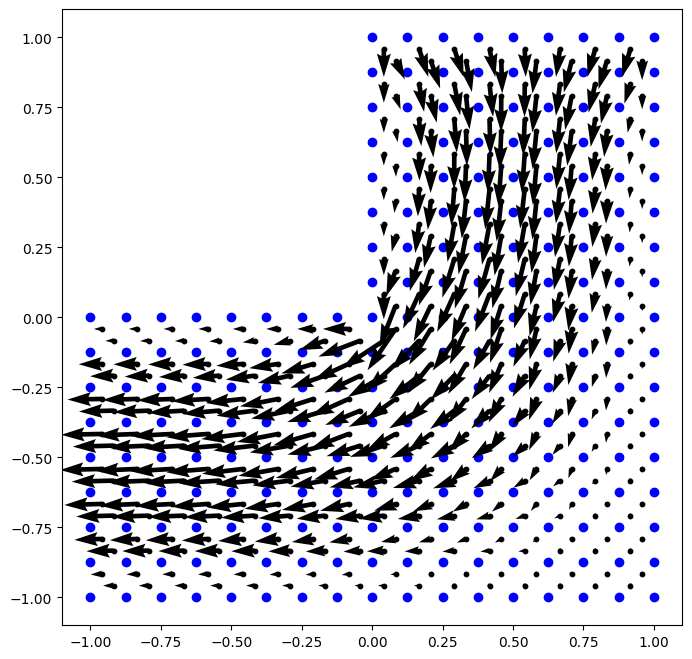

[0.01722066]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16582004e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25851484e-03
  1.13403170e-03  0.00000000e+00 -3.52323741e-04 -3.78401409e-04
  9.84409237e-04 -2.75339200e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78198898e-03  3.79741752e-03  0.00000000e+00  1.82234096e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87894080e-03 -1.60004564e-03
  0.00000000e+00 -5.03168343e-03  2.43312206e-03  4.24587251e-03
  4.13875262e-03  2.32395603e-03 -4.44931528e-03  4.57204841e-03
 -5.09284263e-03 -5.46785655e-04  4.44570637e-03 -5.41579726e-03
  1.83961140e-04  3.78408648e-03 -5.23501649e-03 -6.63853335e-04
  4.57143116e-03  1.94946507e-04 -5.39671700e-03  8.47876641e-04
 -5.09595321

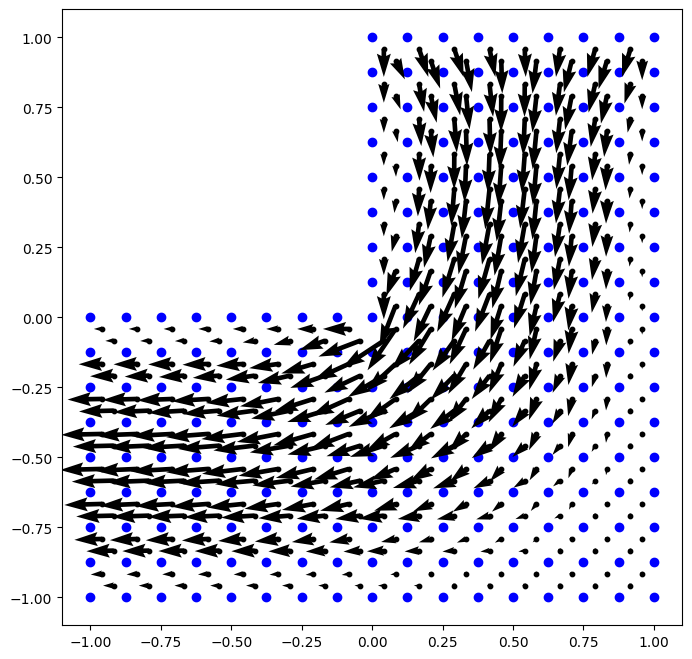

[0.01530247]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16752605e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25896137e-03
  1.13448938e-03  0.00000000e+00 -3.52317086e-04 -3.78121539e-04
  9.84817541e-04 -2.75354523e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78161296e-03  3.79774487e-03  0.00000000e+00  1.82221960e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87931525e-03 -1.59961718e-03
  0.00000000e+00 -5.03186291e-03  2.43346249e-03  4.24622383e-03
  4.13891686e-03  2.32431828e-03 -4.44919721e-03  4.57188345e-03
 -5.09258039e-03 -5.46994749e-04  4.44568373e-03 -5.41575687e-03
  1.84215694e-04  3.78420241e-03 -5.23469787e-03 -6.63716992e-04
  4.57167574e-03  1.95344209e-04 -5.39648696e-03  8.48058279e-04
 -5.09094114

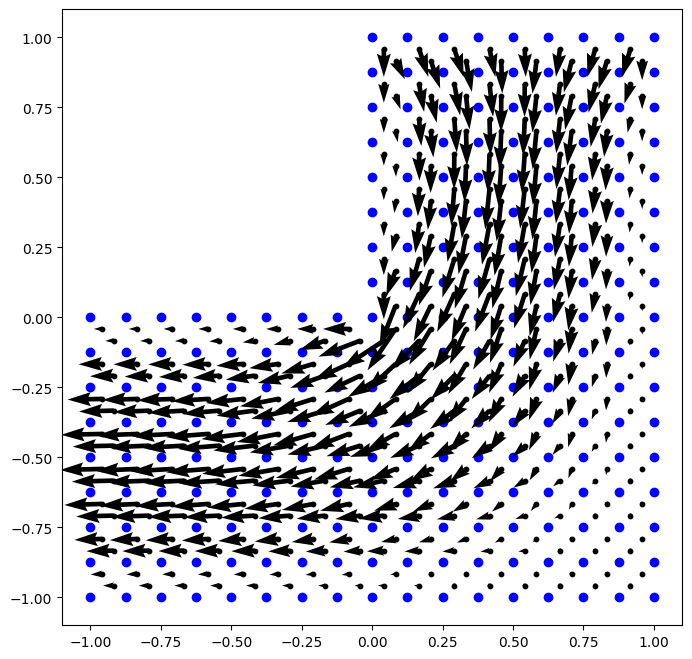

[0.01500352]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16598465e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25855174e-03
  1.13408511e-03  0.00000000e+00 -3.52326198e-04 -3.78387379e-04
  9.84458626e-04 -2.75340401e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78194853e-03  3.79742823e-03  0.00000000e+00  1.82233034e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87895598e-03 -1.59998880e-03
  0.00000000e+00 -5.03170137e-03  2.43313607e-03  4.24589179e-03
  4.13876093e-03  2.32397497e-03 -4.44930849e-03  4.57203449e-03
 -5.09282832e-03 -5.46808337e-04  4.44570281e-03 -5.41580338e-03
  1.83989188e-04  3.78409256e-03 -5.23500016e-03 -6.63847241e-04
  4.57144475e-03  1.94972562e-04 -5.39670606e-03  8.47882986e-04
 -5.09523848

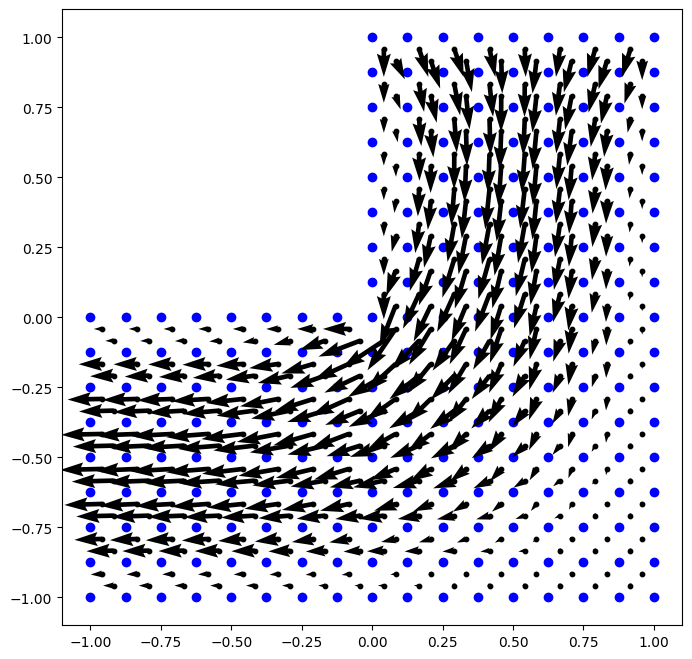

[0.01342496]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16743670e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25894149e-03
  1.13448369e-03  0.00000000e+00 -3.52317559e-04 -3.78142540e-04
  9.84817162e-04 -2.75353420e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78162196e-03  3.79771601e-03  0.00000000e+00  1.82222677e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87928486e-03 -1.59961719e-03
  0.00000000e+00 -5.03185267e-03  2.43343640e-03  4.24619965e-03
  4.13890551e-03  2.32429431e-03 -4.44920543e-03  4.57189400e-03
 -5.09259882e-03 -5.46985446e-04  4.44568512e-03 -5.41576512e-03
  1.84211643e-04  3.78419421e-03 -5.23472232e-03 -6.63727860e-04
  4.57165910e-03  1.95319874e-04 -5.39650523e-03  8.48045581e-04
 -5.09088687

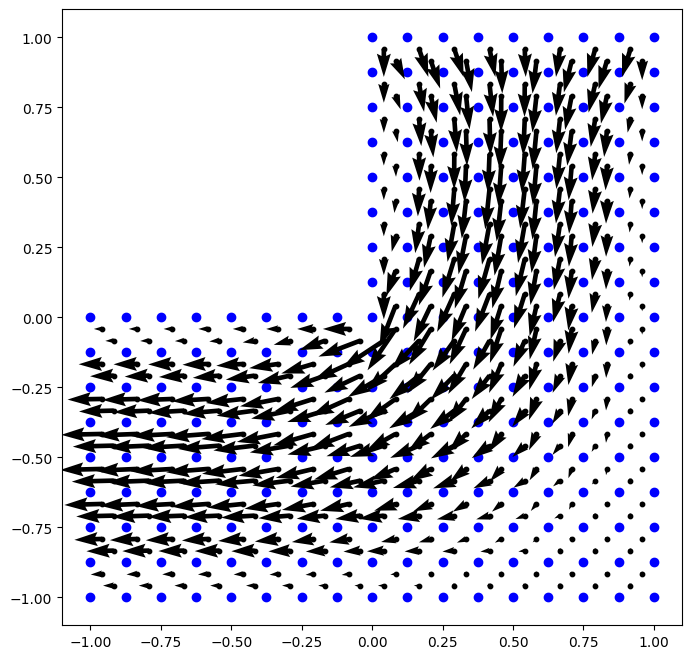

[0.01308167]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16612166e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25858301e-03
  1.13412888e-03  0.00000000e+00 -3.52327980e-04 -3.78374572e-04
  9.84499020e-04 -2.75341423e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78191521e-03  3.79743885e-03  0.00000000e+00  1.82232141e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87897040e-03 -1.59994274e-03
  0.00000000e+00 -5.03171627e-03  2.43314936e-03  4.24590911e-03
  4.13876843e-03  2.32399214e-03 -4.44930246e-03  4.57202270e-03
 -5.09281552e-03 -5.46827010e-04  4.44569991e-03 -5.41580767e-03
  1.84012288e-04  3.78409807e-03 -5.23498538e-03 -6.63841556e-04
  4.57145695e-03  1.94995325e-04 -5.39669602e-03  8.47889267e-04
 -5.09466224

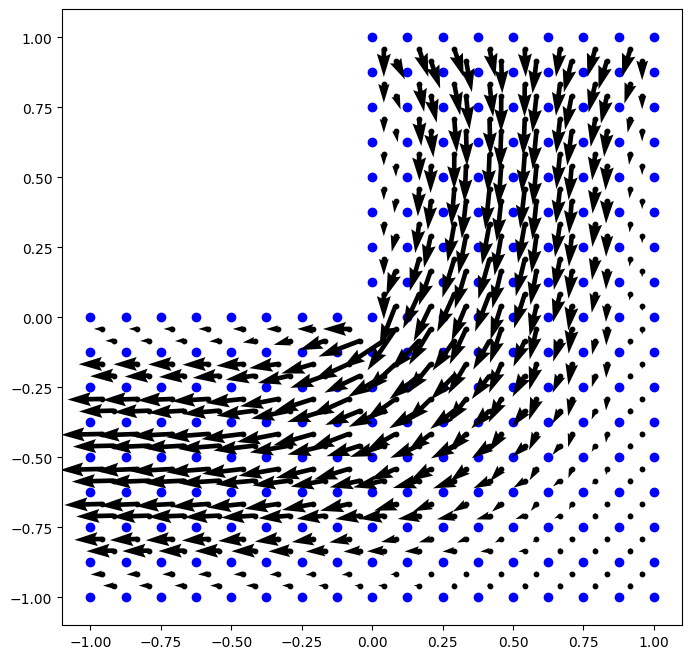

[0.01177577]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16735731e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25892328e-03
  1.13447626e-03  0.00000000e+00 -3.52317909e-04 -3.78160419e-04
  9.84813930e-04 -2.75352481e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78163137e-03  3.79769181e-03  0.00000000e+00  1.82223303e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87925913e-03 -1.59962008e-03
  0.00000000e+00 -5.03184371e-03  2.43341416e-03  4.24617880e-03
  4.13889578e-03  2.32427354e-03 -4.44921249e-03  4.57190313e-03
 -5.09261458e-03 -5.46976940e-04  4.44568635e-03 -5.41577167e-03
  1.84206890e-04  3.78418718e-03 -5.23474306e-03 -6.63737050e-04
  4.57164474e-03  1.95298644e-04 -5.39652069e-03  8.48034581e-04
 -5.09088021

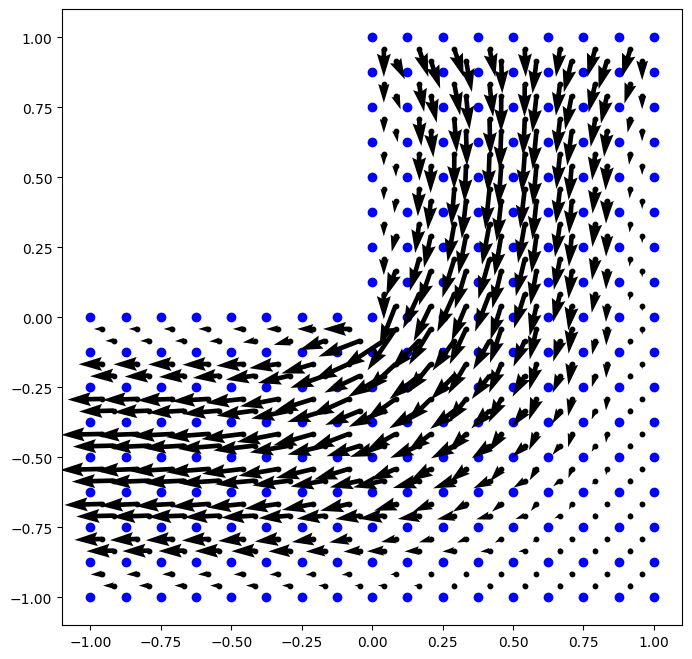

[0.0114134]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16623598e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25860960e-03
  1.13416491e-03  0.00000000e+00 -3.52329251e-04 -3.78362974e-04
  9.84532257e-04 -2.75342294e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78188762e-03  3.79744911e-03  0.00000000e+00  1.82231387e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87898389e-03 -1.59990523e-03
  0.00000000e+00 -5.03172867e-03  2.43316178e-03  4.24592461e-03
  4.13877518e-03  2.32400762e-03 -4.44929711e-03  4.57201272e-03
 -5.09280412e-03 -5.46842430e-04  4.44569755e-03 -5.41581062e-03
  1.84031404e-04  3.78410304e-03 -5.23497208e-03 -6.63836319e-04
  4.57146784e-03  1.95015204e-04 -5.39668688e-03  8.47895338e-04
 -5.09419516e

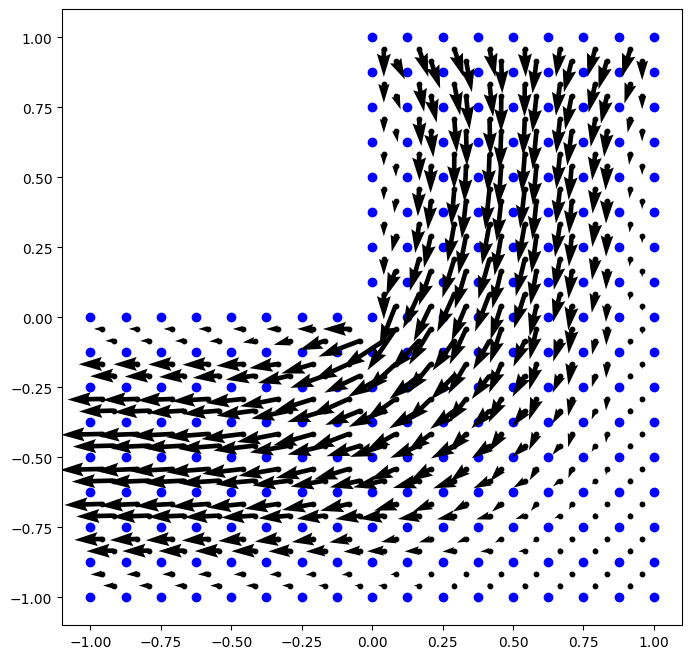

[0.01032762]
[ 0.00000000e+00  1.00000000e-01  0.00000000e+00  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -7.16728720e-04  5.00000000e-02  1.00000000e-01  1.00000000e-01
  1.00000000e-01  1.00000000e-01  0.00000000e+00  1.25890675e-03
  1.13446790e-03  0.00000000e+00 -3.52318198e-04 -3.78175689e-04
  9.84808898e-04 -2.75351682e-03  2.50000000e-02  1.00000000e-01
  1.00000000e-01  1.00000000e-01  1.00000000e-01  0.00000000e+00
 -1.78164075e-03  3.79767143e-03  0.00000000e+00  1.82223849e-03
  7.50000000e-02  1.00000000e-01  1.00000000e-01  1.00000000e-01
  1.00000000e-01  0.00000000e+00  3.87923728e-03 -1.59962478e-03
  0.00000000e+00 -5.03183591e-03  2.43339512e-03  4.24616080e-03
  4.13888742e-03  2.32425549e-03 -4.44921856e-03  4.57191103e-03
 -5.09262810e-03 -5.46969265e-04  4.44568743e-03 -5.41577691e-03
  1.84201801e-04  3.78418112e-03 -5.23476072e-03 -6.63744851e-04
  4.57163233e-03  1.95280118e-04 -5.39653382e-03  8.48025017e-04
 -5.09090518

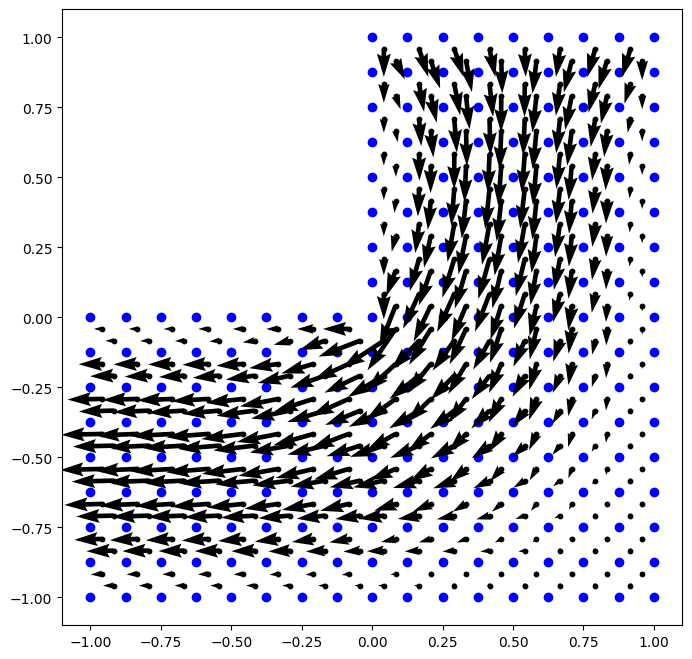

[0.0099635]


In [ ]:
omega = np.array([omega_init  for i in range(len(xy))]).reshape(-1,1)
#omega = np.array([omega_init if xy[i][0]!=0 else omega_ab(xy[i][1]/100)  for i in range(len(xy))]).reshape(-1,1)

iter_nums = 100
for iter_num in range(iter_nums):
  D_e_list = []
  M_e_list = []
  #F_e_list = []
  for pos in range(len(node_label)):
    ## d matrix of element pos
    #print(pos)
    area_t, b1,b2,b3,c1,c2,c3 = compfunc(xy,node_label,pos)
    D_e_list.append(D_e(area_t, b1,b2,b3,c1,c2,c3))

    ## m matrix of element pos
    M_e_list.append(M_e(area_t))

    ## f vector of element pos
    #F_e_list.append(np.array([0,0,0]))

  ## construct full matrix
  D_mat = np.zeros((len(xy),len(xy))); F_vec = np.zeros((len(xy),1)); M_mat = np.zeros((len(xy),len(xy)))
  for i in range(len(node_label)):
    for ith ,jth in itertools.product(np.arange(3), np.arange(3)):
      D_mat[node_label[i][ith]-1][node_label[i][jth]-1] += D_e_list[i][ith][jth]
      M_mat[node_label[i][ith]-1][node_label[i][jth]-1] += M_e_list[i][ith][jth]
    # note that we ignore F for this case
  '''
  print('print D matrix')
  plt.matshow(D_mat)
  plt.colorbar()
  plt.show()
  print('F vector')
  print(F_vec)
  '''
  ## add vorticity related
  MOmega = np.dot(M_mat,omega)
  F_vec += MOmega
  ## take into account the normal conditions
  for i in range(len(xy)):
    if xy[i][1] == 1.0:
      F_vec[i] = psi_in(xy[i][0])
      D_mat[i,:] = 0
      D_mat[i,i] = 1
    elif i+1 in bound_up_label:
      F_vec[i] = psi_b_up
      D_mat[i,:] = 0
      D_mat[i,i] = 1
    elif i+1 in bound_down_label:
      F_vec[i] = psi_b_down
      D_mat[i,:] = 0
      D_mat[i,i] = 1
    else:
      pass

  #print(F_vec.reshape(-1,))

  for i in range(len(xy)):
    if xy[i][1] == 1.0:
      temp_f = deepcopy(D_mat[:,i])
      temp_f[i] = 0
      F_prime = -psi_in(xy[i][0])*temp_f
      D_mat[:,i] = 0
      D_mat[i,i] = 1
    elif i+1 in bound_up_label:
      temp_f = deepcopy(D_mat[:,i])
      temp_f[i] = 0
      F_prime = -psi_b_up*temp_f
      D_mat[:,i] = 0
      D_mat[i,i] = 1
    elif i+1 in bound_down_label:
      temp_f = deepcopy(D_mat[:,i])
      temp_f[i] = 0
      F_prime = -psi_b_down*temp_f
      D_mat[:,i] = 0
      D_mat[i,i] = 1
    else:
      pass

    F_vec = F_vec + F_prime.reshape(-1,1)
    F_prime = np.zeros(F_vec.shape)



  ## calculation of psi
  psi = np.dot(np.linalg.pinv(D_mat),F_vec)
  print('--- {}th iteration, calculated error:{} ---'.format(iter_num,np.mean((np.dot(D_mat,psi)-F_vec)**2)))
  ## calculation of flow
  Flow_list = []
  for pos in range(len(node_label)):
    area_t, b1,b2,b3,c1,c2,c3 = compfunc(xy,node_label,pos)
    u = 1/2/area_t * (c1* psi[node_label[pos][0]-1]+ c2*psi[node_label[pos][1]-1] + c3*psi[node_label[pos][2]-1] )
    v = -1/2/area_t * (b1* psi[node_label[pos][0]-1]+ b2*psi[node_label[pos][1]-1] + b3*psi[node_label[pos][2]-1] )
    Flow_list.append([u,v])
  centr_list = []
  for pos in range(len(node_label)):
    centr_list.append(centroid(xy,node_label,pos))


  if iter_num%1==0:
    print('--- {}th iteration ---'.format(iter_num))
    plt.figure(figsize=(8,8))
    for i in range(len(xy)):
      plt.scatter(xy[i][0],xy[i][1],color='blue')
    for i in range(len(node_label)):
      plt.scatter(centr_list[i][0],centr_list[i][1],color='black',s=10)
      #plt.quiver(centr_list[i][0], centr_list[i][1], Flow_list[i][0], Flow_list[i][1], width=0.003, headwidth=1,headlength=1, color='black',angles='xy', scale_units='xy', scale=1/3)
      plt.quiver(centr_list[i][0], centr_list[i][1], Flow_list[i][0], Flow_list[i][1],angles='xy', scale_units='xy', scale=1)
    plt.show()
  else:
    pass

  # omega calculation
  ## kinematic viscosity
  nu_xs = nu0 + 1/2*dt*np.array([t[0]**2 for t in Flow_list]).reshape(-1,1)
  nu_ys = nu0 + 1/2*dt*np.array([t[1]**2 for t in Flow_list]).reshape(-1,1)

  Dnu_e_list = []
  M_e_list = []
  tildeM_e_list = []
  A_e_list = []
  #F_e_list = []
  for pos in range(len(node_label)):
    ## d matrix of element pos
    #print(pos)
    area_t, b1,b2,b3,c1,c2,c3 = compfunc(xy,node_label,pos)
    Dnu_e_list.append(Dnu_e(area_t, b1,b2,b3,c1,c2,c3,nu_xs[pos],nu_ys[pos]))

    ## m matrix of element pos
    M_e_list.append(M_e(area_t))
    tildeM_e_list.append(tildeM_e(area_t))

    ## a matrix of element pos
    t_p_list = [psi[t-1][0]  for t in node_label[pos]]
    A_e_list.append(A_e(t_p_list))


  ## construct full matrix
  Dnu_mat = np.zeros((len(xy),len(xy))); F_vec = np.zeros((len(xy),1))
  M_mat = np.zeros((len(xy),len(xy))); tildeM_mat = np.zeros((len(xy),len(xy)))
  A_mat = np.zeros((len(xy),len(xy)))
  for i in range(len(node_label)):
    for ith ,jth in itertools.product(np.arange(3), np.arange(3)):
      Dnu_mat[node_label[i][ith]-1][node_label[i][jth]-1] += Dnu_e_list[i][ith][jth]
      M_mat[node_label[i][ith]-1][node_label[i][jth]-1] += M_e_list[i][ith][jth]
      tildeM_mat[node_label[i][ith]-1][node_label[i][jth]-1] += tildeM_e_list[i][ith][jth]
      A_mat[node_label[i][ith]-1][node_label[i][jth]-1] += A_e_list[i][ith][jth]

  RHS_vec = np.dot(M_mat, omega)/dt - np.dot(A_mat, omega) - np.dot(Dnu_mat,omega) + F_vec
  LHS_mat = tildeM_mat/dt

  ## take into account the normal conditions
  for i in range(len(xy)):
    if xy[i][1] == 1.0:
      RHS_vec[i] = omega_in
      LHS_mat[i,i] = 1
    elif i+1 in bound_label_corner:
      RHS_vec[i] = omega_corner
      LHS_mat[i,i] = 1
    elif i+1 in omega_n_dict.keys():
      [t_pos,t_length] = omega_n_dict[i+1]
      RHS_vec[i] = -3/(t_length**2)*(psi[t_pos-1]-psi[i])-1/2*omega[t_pos-1]
      LHS_mat[i,i] = 1
    else:
      pass

  omega_new = np.dot(np.linalg.inv(LHS_mat),RHS_vec)
  #print(omega)
  conv_cond = max([ abs((o_new-o_pre)/(o_pre+1e-10)) for o_pre, o_new in zip(omega,omega_new)])
  omega = omega_new
  #print(omega_new)
  print(conv_cond)
  if conv_cond < epsilon:
    break
  else:
    pass


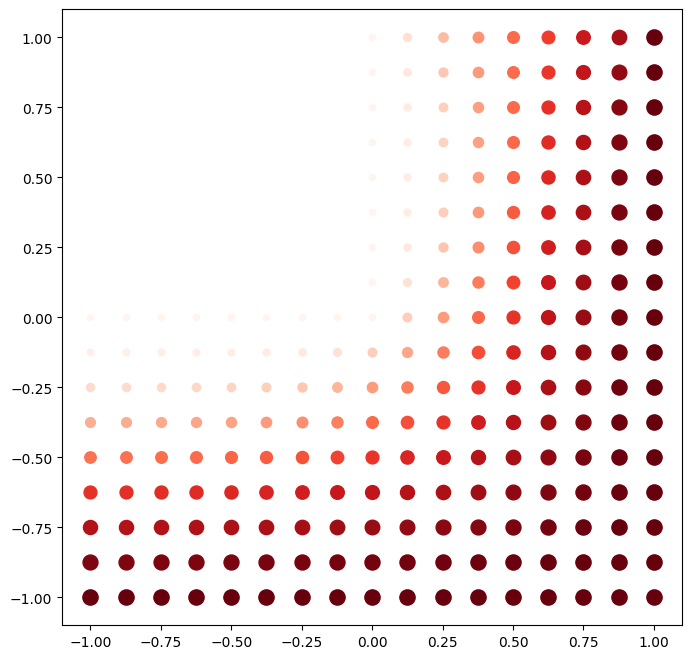

In [ ]:
cm = plt.get_cmap("Reds")
max_psi = max(psi)
min_psi = min(psi)
plt.figure(figsize=(8,8))
for i in range(len(xy)):
  c_ind = (psi[i]-min_psi)/(max_psi-min_psi)
  plt.scatter(xy[i][0],xy[i][1],s=100*c_ind+20,color = cm(c_ind))
plt.show()

### 条件設定・計算: （入力口はポアズイユ流れ）

In [ ]:
## def of time increment & viscosity conditions
dt = 0.05 # 0.2
epsilon = 0.01
nu0 = 0.05
mu0 = nu0*997 #water
p_alpha = 100

## def of normal and natural conditions
Vs = 0 # for green and orange boundary
psi_b_up = 0
psi_b_down = p_alpha/12/mu0
psi_in = lambda x: -p_alpha/6/mu0*(x**3) + p_alpha/4/mu0*(x**2)

### conditions for pmega N.B. boundary for
omega_corner = 0
omega_init = 0
omega_in = lambda x: p_alpha/2/mu0*(2*x-1)


[0.         0.16716817 0.         0.16716817 0.16716817 0.16716817
 0.16716817 0.         0.         0.08358409 0.16716817 0.16716817
 0.16716817 0.16716817 0.         0.         0.         0.
 0.         0.         0.         0.         0.02612003 0.16716817
 0.16716817 0.16716817 0.16716817 0.         0.         0.
 0.         0.         0.14104814 0.16716817 0.16716817 0.16716817
 0.16716817 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.00718301 0.16716817 0.16716817 0.16716817 0.16716817 0.
 0.         0.         0.         0.         0.11427512 0.16716817
 0.16716817 0.16716817 0.16716817 0.         0.         0.
 0.         0.         0.05289305 0.16716817 0.16716817 0.16716817
 0.16716817 0.         0.         0.         0.         0.
 0.15998

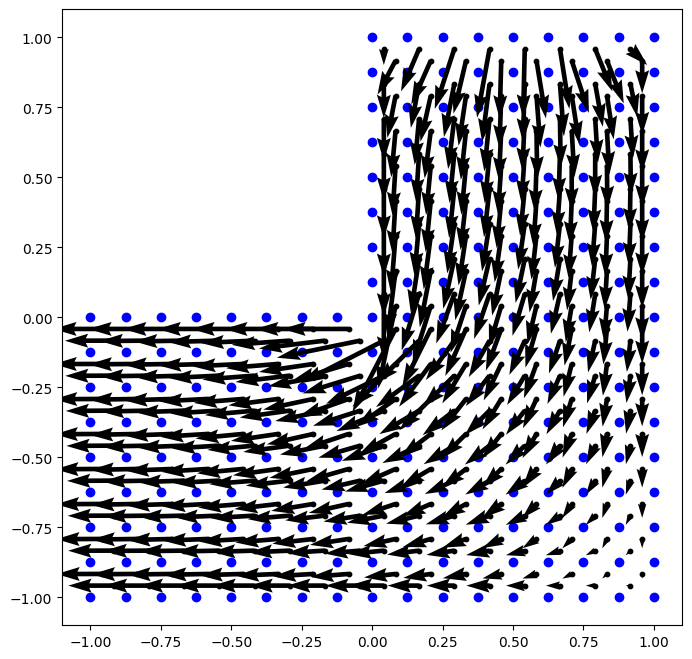

[2.62550084e+10]
[ 0.          0.16716817  0.          0.16716817  0.16716817  0.16716817
  0.16716817  0.          0.          0.08358409  0.16716817  0.16716817
  0.16716817  0.16716817  0.          0.          0.          0.
  0.          0.          0.          0.          0.02612003  0.16716817
  0.16716817  0.16716817  0.16716817  0.          0.          0.
  0.          0.          0.14104814  0.16716817  0.16716817  0.16716817
  0.16716817  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.         -0.00404965
  0.00718301  0.16716817  0.16716817  0.16716817  0.16716817  0.
  0.          0.00584803  0.          0.          0.11427512  0.16716817
  0.16716817  0.16716817  0.16716817  0.          0.          0.
  0.          0.         

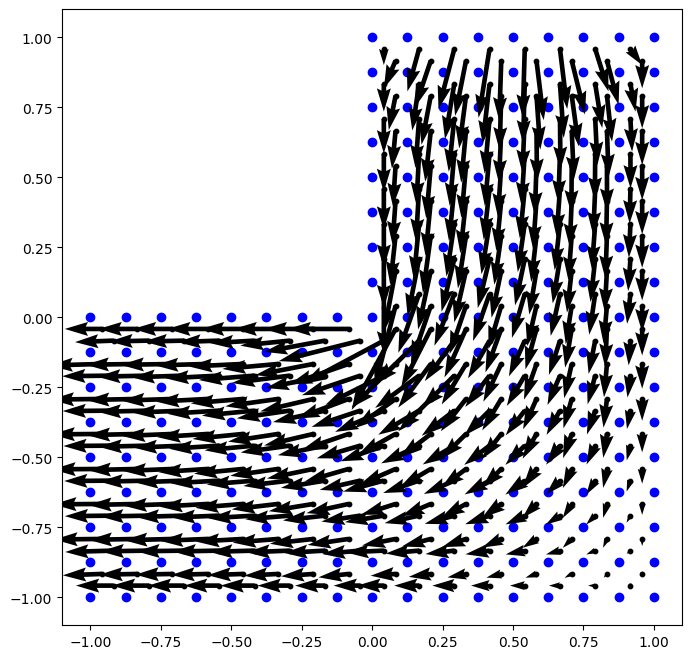

[8.51110042e+09]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
  0.00000000e+00  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -1.44025771e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
  0.00000000e+00  2.05136504e-03  0.00000000e+00  3.07253575e-04
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  2.07489237e-03  0.00000000e+00
  0.00000000e+00 -1.80536493e-03  8.89699569e-04  1.51774286e-03
  1.51575533e-03  8.76486338e-04 -1.97318040e-03  1.64442894e-03
 -1.85277810e-03  0.00000000e+00  1.60582677e-03 -1.92142140e-03
  0.00000000e+00  1.86845213e-03 -1.89169571e-03  1.84167466e-04
  1.55711817e-03  0.00000000e+00 -1.86705761e-03  4.23096749e-04
  0.0000

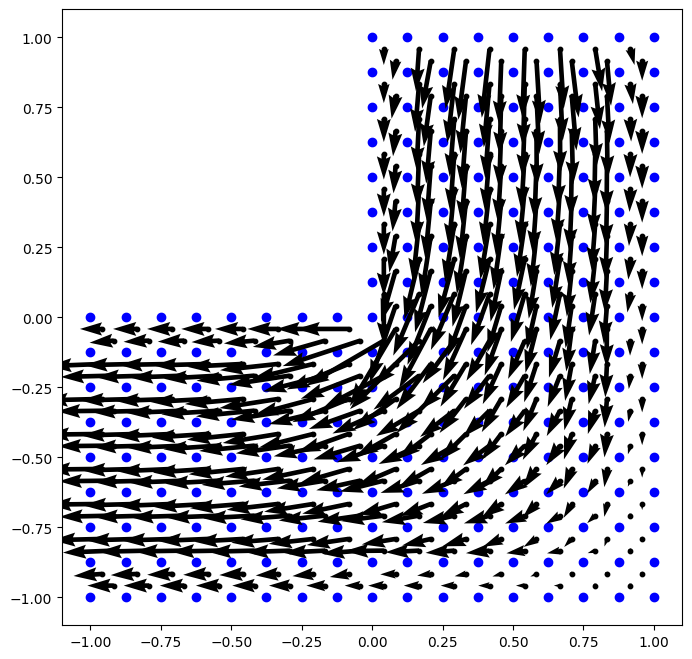

[3.17485991e+09]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
  0.00000000e+00  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -3.36101051e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -4.55482219e-04  4.76073405e-03  0.00000000e+00  1.15475745e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  4.87640542e-03 -3.64534693e-04
  0.00000000e+00 -4.67913854e-03  2.35127261e-03  3.91943418e-03
  3.87549410e-03  2.27712676e-03 -5.18479033e-03  4.19790607e-03
 -4.70500754e-03  0.00000000e+00  4.13908205e-03 -5.01471396e-03
  0.00000000e+00  4.67694936e-03 -4.68459601e-03  4.26874674e-04
  4.03110618e-03  0.00000000e+00 -4.79937912e-03  1.16900373e-03
  0.0000

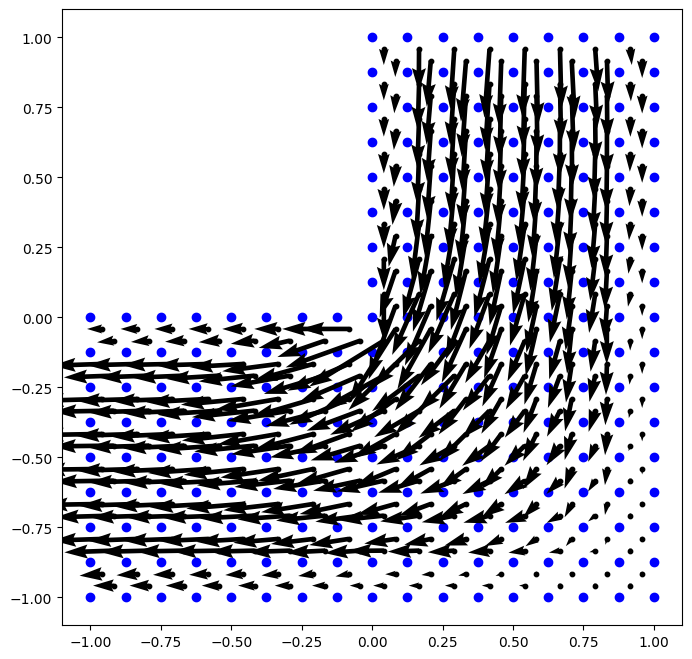

[1.12180237e+09]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.50706380e-04  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.49155707e-04
  2.30483926e-04  0.00000000e+00 -4.57274749e-05  6.32186162e-06
  9.92947501e-05 -4.26457788e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.32318501e-03  5.98738016e-03  0.00000000e+00  1.96109381e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.16748454e-03 -1.05172560e-03
  0.00000000e+00 -6.56801772e-03  3.28980442e-03  5.47032404e-03
  5.38284663e-03  3.14526356e-03 -7.07644002e-03  5.82872700e-03
 -6.29739954e-03 -3.65194892e-05  5.75359615e-03 -7.03489947e-03
  1.90296534e-05  6.15701773e-03 -6.35448158e-03  4.85997046e-04
  5.64848052e-03  1.97457217e-05 -6.71140602e-03  1.50094906e-03
 -1.3979

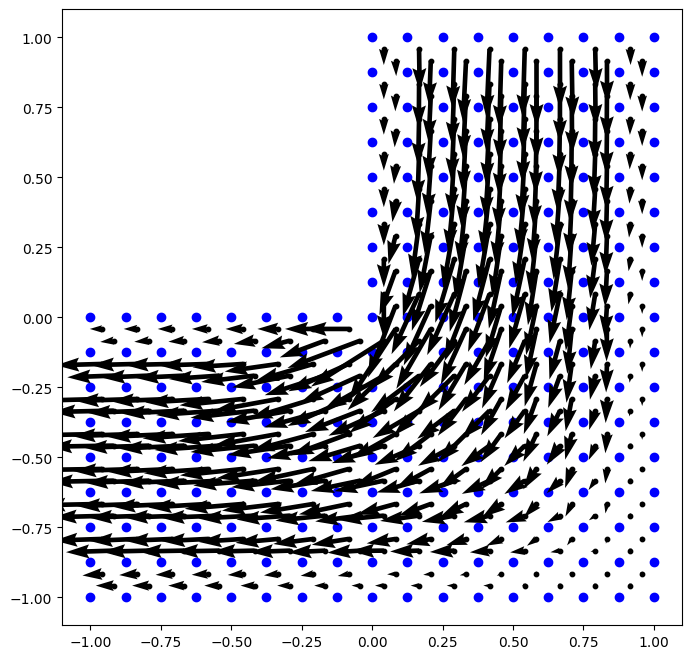

[3.17159897e+08]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -4.11370444e-04  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  7.27400404e-04
  6.56548008e-04  0.00000000e+00 -1.44452449e-04  1.44292954e-05
  3.32679546e-04 -4.75231735e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.82734103e-03  6.59893133e-03  0.00000000e+00  2.45249827e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.82315470e-03 -1.46293592e-03
  0.00000000e+00 -7.70702480e-03  3.84769823e-03  6.38603717e-03
  6.27987953e-03  3.62977220e-03 -7.88458738e-03  6.80136108e-03
 -7.32434406e-03 -1.32058496e-04  6.69430317e-03 -8.20494134e-03
  5.48082195e-05  7.00347456e-03 -7.41364179e-03  3.79500621e-04
  6.64218819e-03  7.43262563e-05 -7.89384948e-03  1.55789364e-03
 -3.4630

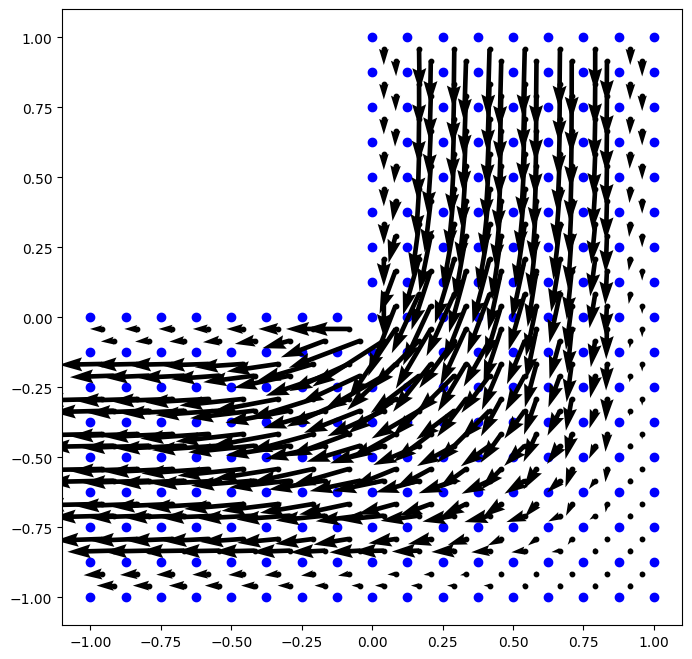

[39140251.02513935]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -6.13858216e-04  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  1.12563822e-03
  1.00190376e-03  0.00000000e+00 -2.45337059e-04 -2.71954543e-07
  5.93446339e-04 -4.79288181e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -2.41179921e-03  6.60249995e-03  0.00000000e+00  2.83244526e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.83791443e-03 -1.94684930e-03
  0.00000000e+00 -8.20454596e-03  4.05184710e-03  6.77991612e-03
  6.65524634e-03  3.79347558e-03 -8.23687018e-03  7.31643241e-03
 -7.85431284e-03 -2.64695159e-04  7.13311830e-03 -8.74954449e-03
  1.30118276e-04  7.42001579e-03 -8.02675045e-03  2.14627438e-04
  7.11252502e-03  1.64392472e-04 -8.48803875e-03  1.49835241e-03
 -5.8

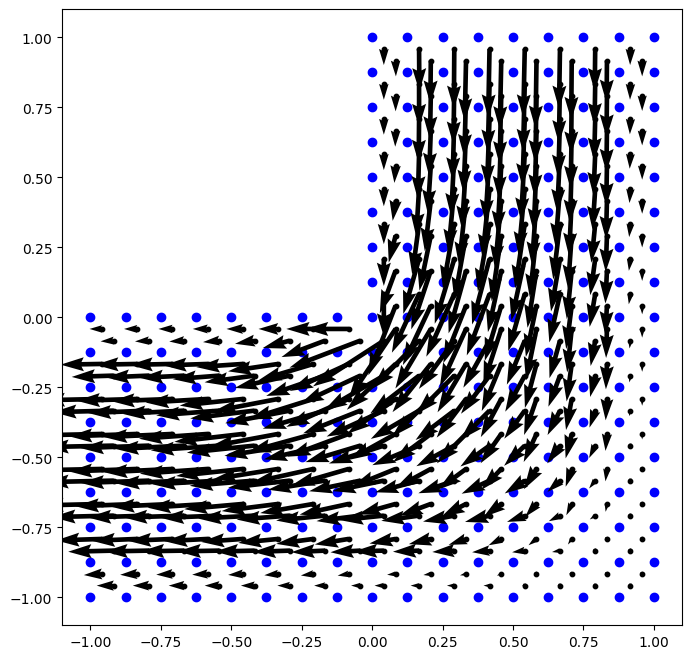

[1.31172095]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -8.02723769e-04  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  1.49164739e-03
  1.31159869e-03  0.00000000e+00 -3.29849305e-04 -4.10712353e-05
  8.23169769e-04 -4.80197178e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -2.65614732e-03  6.57664446e-03  0.00000000e+00  2.97832892e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.81199429e-03 -2.14729302e-03
  0.00000000e+00 -8.42277959e-03  4.15022356e-03  6.95377444e-03
  6.82307496e-03  3.85824712e-03 -8.23948252e-03  7.53335864e-03
 -8.13899563e-03 -4.04574293e-04  7.31414549e-03 -8.98650564e-03
  1.97161494e-04  7.61160161e-03 -8.34571414e-03  1.00630981e-04
  7.32225043e-03  2.52222487e-04 -8.73594485e-03  1.45180639e-03
 -7.42510222

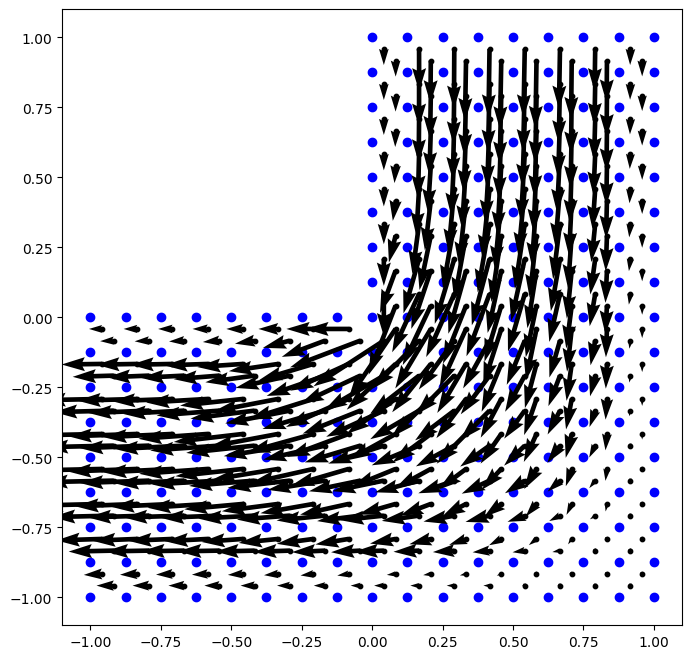

[8.7726575]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -8.99528799e-04  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  1.69703459e-03
  1.47607180e-03  0.00000000e+00 -3.97951575e-04 -8.73713629e-05
  1.00391917e-03 -4.70684912e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -2.93186556e-03  6.43935947e-03  0.00000000e+00  3.09549161e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.66371001e-03 -2.39772043e-03
  0.00000000e+00 -8.44555955e-03  4.14037698e-03  6.98026788e-03
  6.84167883e-03  3.84121865e-03 -8.25472346e-03  7.63664060e-03
 -8.28438548e-03 -5.10949176e-04  7.37025244e-03 -9.06387868e-03
  2.44865184e-04  7.68341224e-03 -8.54270668e-03 -8.81615890e-06
  7.39671778e-03  3.12481319e-04 -8.83582188e-03  1.42309904e-03
 -9.02906191e

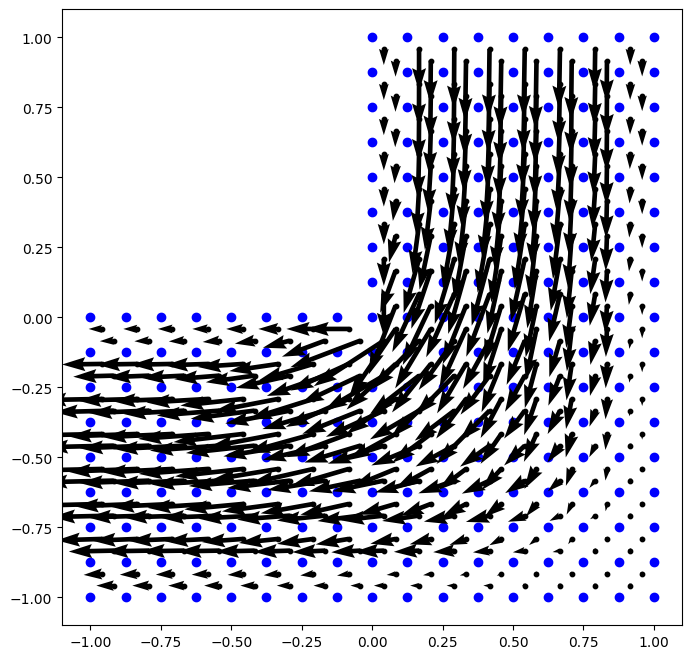

[8.00901871]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -9.91569415e-04  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  1.87211978e-03
  1.61390646e-03  0.00000000e+00 -4.48772587e-04 -1.24363020e-04
  1.14165611e-03 -4.68672999e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -2.99344164e-03  6.41214820e-03  0.00000000e+00  3.10010488e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.62762258e-03 -2.45760567e-03
  0.00000000e+00 -8.46194055e-03  4.15890991e-03  7.00087905e-03
  6.86435684e-03  3.84906493e-03 -8.18444201e-03  7.64392570e-03
 -8.34373132e-03 -6.10354915e-04  7.38354179e-03 -9.09057699e-03
  2.80790835e-04  7.70484216e-03 -8.60906964e-03 -5.00097483e-05
  7.42013582e-03  3.57369986e-04 -8.84426374e-03  1.42133006e-03
 -9.52437567

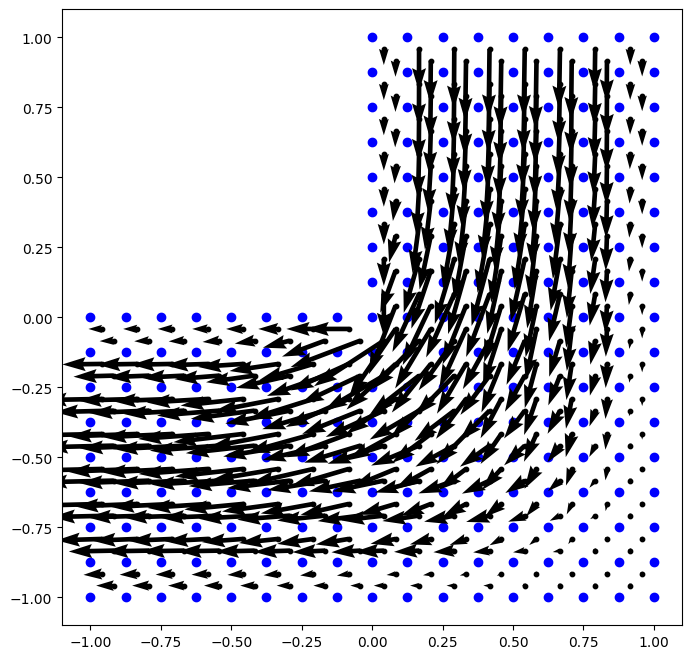

[22.70916687]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.02101290e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  1.93920425e-03
  1.65677984e-03  0.00000000e+00 -4.88786247e-04 -1.62534592e-04
  1.24352365e-03 -4.62901048e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.10905255e-03  6.34803638e-03  0.00000000e+00  3.12766713e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.55291606e-03 -2.58382511e-03
  0.00000000e+00 -8.42418960e-03  4.13607199e-03  6.98307878e-03
  6.84579523e-03  3.82987729e-03 -8.18775103e-03  7.65634768e-03
 -8.38476070e-03 -6.67136976e-04  7.37967169e-03 -9.08604085e-03
  2.89008841e-04  7.69996950e-03 -8.66927968e-03 -1.01300562e-04
  7.41691843e-03  3.68499454e-04 -8.85342827e-03  1.42017489e-03
 -1.0299657

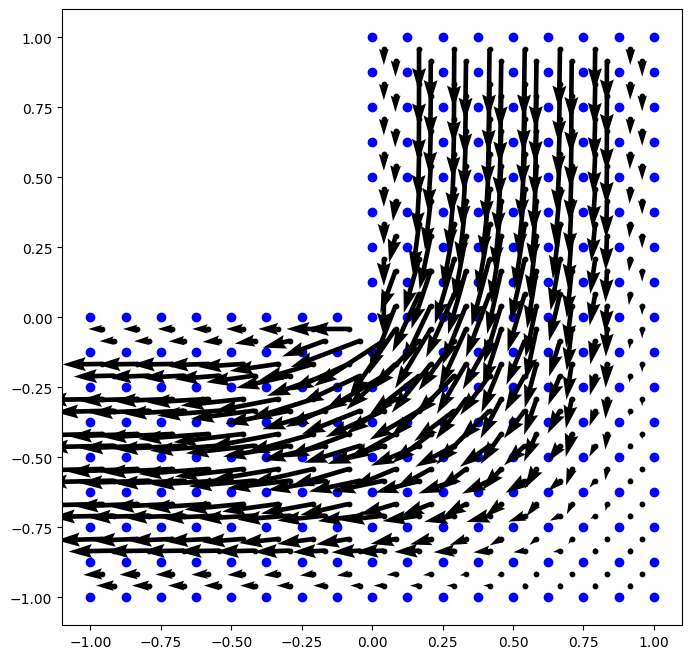

[2.48672283]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.06828287e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.01928860e-03
  1.71562168e-03  0.00000000e+00 -5.18559558e-04 -1.79971098e-04
  1.32592550e-03 -4.63279771e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.09786350e-03  6.35980868e-03  0.00000000e+00  3.10192825e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.55864213e-03 -2.58428387e-03
  0.00000000e+00 -8.43144992e-03  4.15332613e-03  6.99451747e-03
  6.86332688e-03  3.84269726e-03 -8.15011798e-03  7.63418306e-03
 -8.38976316e-03 -7.30499599e-04  7.37976893e-03 -9.08685625e-03
  3.02136737e-04  7.69503437e-03 -8.66675665e-03 -1.08409937e-04
  7.41482474e-03  3.86611906e-04 -8.83477151e-03  1.42581573e-03
 -1.01907713

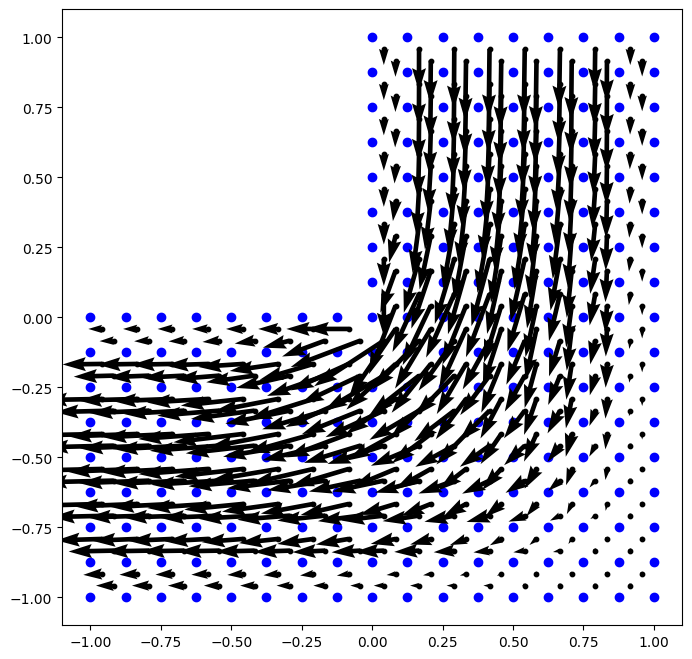

[1.93148175]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.07398163e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.03267185e-03
  1.71555821e-03  0.00000000e+00 -5.42316991e-04 -2.06314816e-04
  1.38500596e-03 -4.60292148e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.14983322e-03  6.33087190e-03  0.00000000e+00  3.11109103e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.52313398e-03 -2.65376744e-03
  0.00000000e+00 -8.40483462e-03  4.13687079e-03  6.98083054e-03
  6.85280913e-03  3.83084518e-03 -8.16398049e-03  7.64059127e-03
 -8.40994840e-03 -7.57710249e-04  7.37764918e-03 -9.07915349e-03
  2.93223867e-04  7.68318885e-03 -8.69386355e-03 -1.35528332e-04
  7.40413472e-03  3.78020799e-04 -8.84295983e-03  1.42526192e-03
 -1.05406706

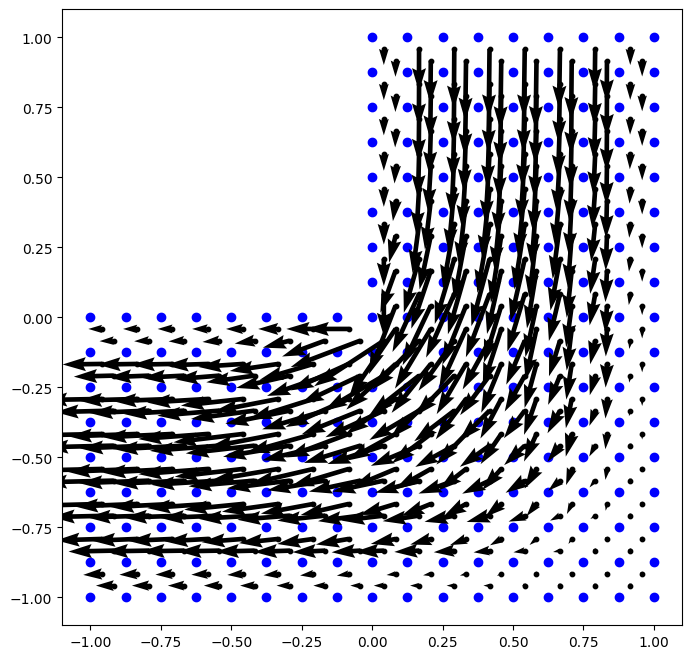

[1.04526345]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.10513822e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.07795176e-03
  1.74922006e-03  0.00000000e+00 -5.60122971e-04 -2.10857534e-04
  1.43851490e-03 -4.61479146e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.12012885e-03  6.34777746e-03  0.00000000e+00  3.08812927e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.53703567e-03 -2.63343906e-03
  0.00000000e+00 -8.41911771e-03  4.15159191e-03  6.99306040e-03
  6.87087737e-03  3.84272422e-03 -8.14534556e-03  7.62428903e-03
 -8.40503789e-03 -8.00683958e-04  7.38191395e-03 -9.08184409e-03
  2.99884691e-04  7.68032169e-03 -8.68042466e-03 -1.33371822e-04
  7.40409481e-03  3.90081385e-04 -8.83020152e-03  1.42836854e-03
 -1.02111482

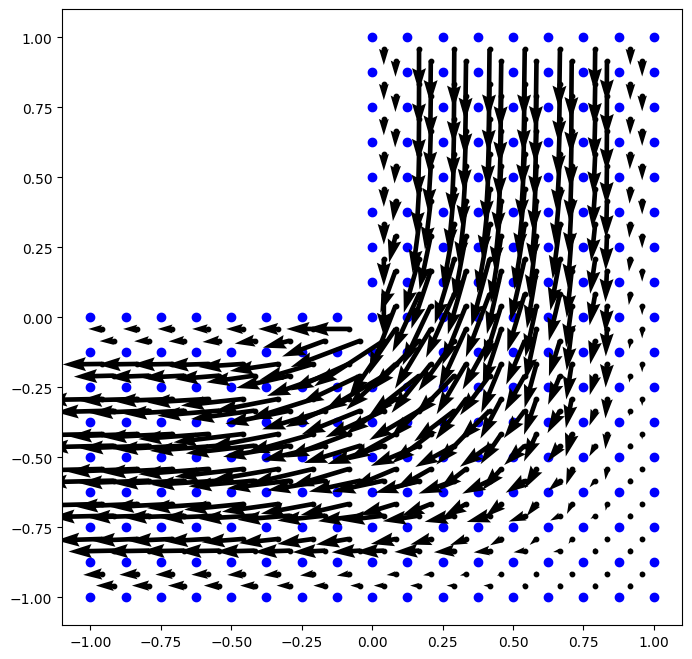

[4.58846027]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.10371653e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.07468832e-03
  1.73836297e-03  0.00000000e+00 -5.74519081e-04 -2.30324613e-04
  1.47301612e-03 -4.59530316e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.14883166e-03  6.32702579e-03  0.00000000e+00  3.09603278e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.51238737e-03 -2.67591857e-03
  0.00000000e+00 -8.40135356e-03  4.13666271e-03  6.98152491e-03
  6.86296565e-03  3.83168221e-03 -8.15954937e-03  7.63435434e-03
 -8.42154916e-03 -8.12549996e-04  7.38291392e-03 -9.07855125e-03
  2.87531863e-04  7.67172253e-03 -8.70138220e-03 -1.51192696e-04
  7.39511600e-03  3.77077344e-04 -8.84287664e-03  1.42640052e-03
 -1.03850777

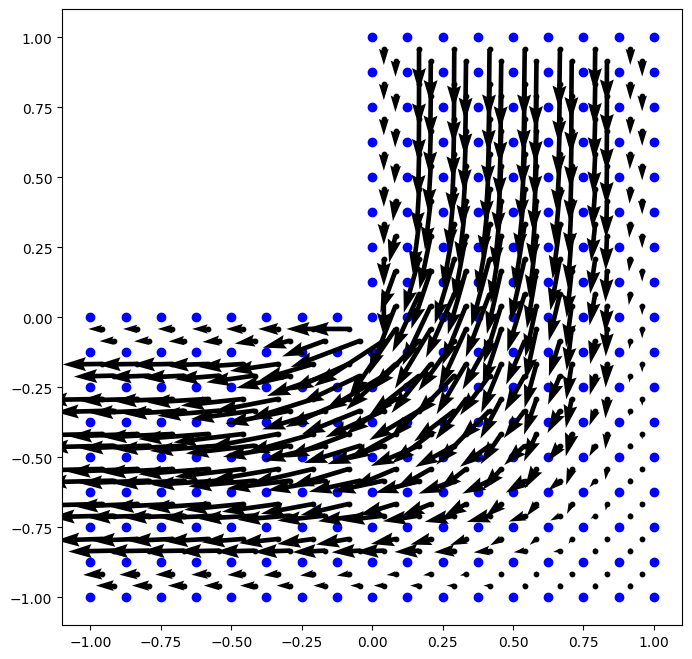

[1.04171457]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.12731474e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.10620167e-03
  1.76396466e-03  0.00000000e+00 -5.85379463e-04 -2.28681927e-04
  1.50950321e-03 -4.60715699e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.11860307e-03  6.33986192e-03  0.00000000e+00  3.07951123e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.52397956e-03 -2.64957830e-03
  0.00000000e+00 -8.41677105e-03  4.14734767e-03  6.99230873e-03
  6.87690180e-03  3.84053087e-03 -8.14801457e-03  7.62359179e-03
 -8.41475993e-03 -8.43372609e-04  7.38765252e-03 -9.08272620e-03
  2.93911099e-04  7.67215262e-03 -8.68848818e-03 -1.47215146e-04
  7.39814340e-03  3.88951912e-04 -8.83408602e-03  1.42829770e-03
 -1.00121486

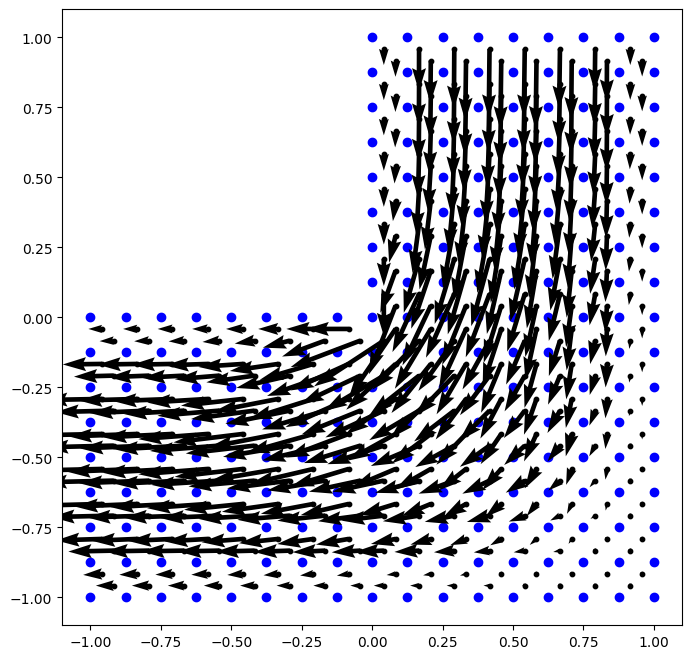

[1.06630114]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.12305242e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.09758876e-03
  1.75118483e-03  0.00000000e+00 -5.94284744e-04 -2.44386819e-04
  1.52893952e-03 -4.59206738e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.13798983e-03  6.32216601e-03  0.00000000e+00  3.08752717e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.50390092e-03 -2.67788349e-03
  0.00000000e+00 -8.40286752e-03  4.13354692e-03  6.98130749e-03
  6.86886069e-03  3.82989414e-03 -8.15917364e-03  7.63421927e-03
 -8.42929269e-03 -8.46822020e-04  7.38864215e-03 -9.08172863e-03
  2.82294698e-04  7.66599322e-03 -8.70699205e-03 -1.60268852e-04
  7.39046078e-03  3.75519716e-04 -8.84702017e-03  1.42594756e-03
 -1.01193004

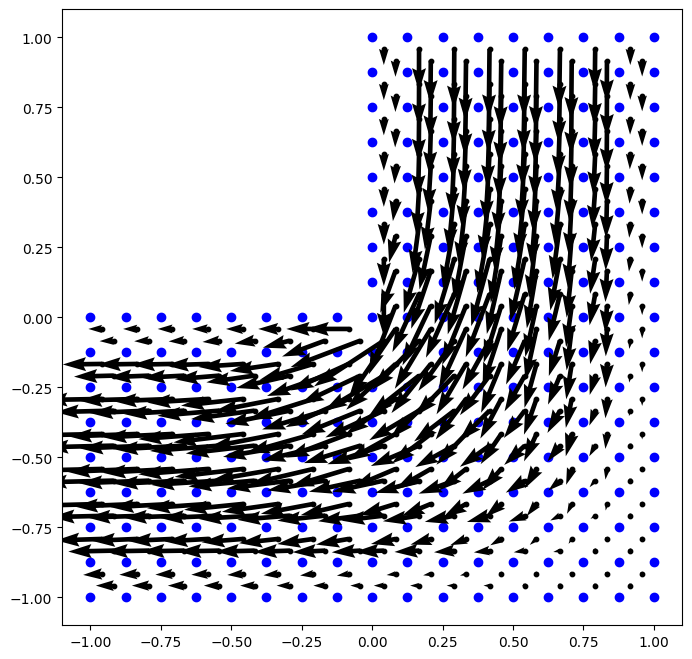

[7.81587388]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.14148303e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.12177669e-03
  1.77302004e-03  0.00000000e+00 -6.01074883e-04 -2.39977060e-04
  1.55492509e-03 -4.60255145e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.11154790e-03  6.33205354e-03  0.00000000e+00  3.07541913e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.51348917e-03 -2.65120135e-03
  0.00000000e+00 -8.41676223e-03  4.14178856e-03  6.99071350e-03
  6.87885800e-03  3.83711644e-03 -8.15070668e-03  7.62580210e-03
 -8.42171568e-03 -8.69642289e-04  7.39188485e-03 -9.08552289e-03
  2.89279909e-04  7.66794299e-03 -8.69533732e-03 -1.56071863e-04
  7.39493921e-03  3.87452478e-04 -8.83943877e-03  1.42747238e-03
 -9.76980381

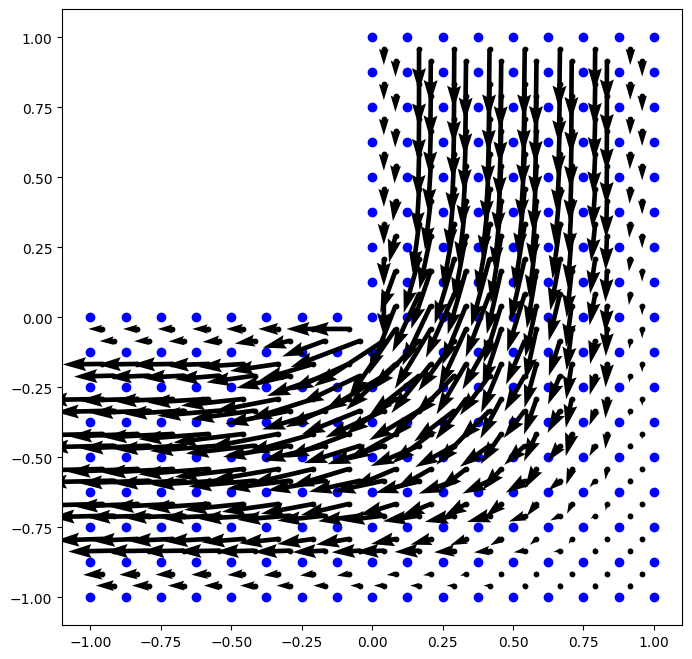

[2.17003866]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.13577818e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.11138481e-03
  1.76057208e-03  0.00000000e+00 -6.06720061e-04 -2.53179597e-04
  1.56520136e-03 -4.59024679e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.12642649e-03  6.31714621e-03  0.00000000e+00  3.08282850e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.49702428e-03 -2.67154793e-03
  0.00000000e+00 -8.40498850e-03  4.12973812e-03  6.98033165e-03
  6.87110193e-03  3.82755099e-03 -8.15908985e-03  7.63514376e-03
 -8.43428848e-03 -8.68423280e-04  7.39216331e-03 -9.08541088e-03
  2.79138036e-04  7.66307031e-03 -8.71141313e-03 -1.65980485e-04
  7.38790736e-03  3.74457870e-04 -8.85086679e-03  1.42505849e-03
 -9.85380718

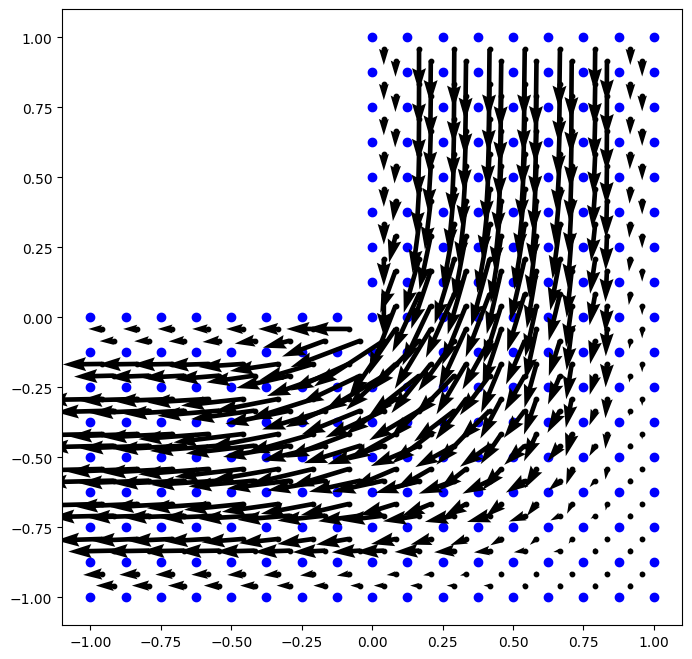

[0.96848862]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.15032860e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.13084601e-03
  1.77985978e-03  0.00000000e+00 -6.11087051e-04 -2.47559268e-04
  1.58459113e-03 -4.59946760e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.10422058e-03  6.32550021e-03  0.00000000e+00  3.07347398e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.50554658e-03 -2.64681303e-03
  0.00000000e+00 -8.41697784e-03  4.13670383e-03  6.98886271e-03
  6.87858716e-03  3.83408355e-03 -8.15249132e-03  7.62779139e-03
 -8.42642146e-03 -8.85796323e-04  7.39396866e-03 -9.08829366e-03
  2.86424544e-04  7.66552436e-03 -8.70073778e-03 -1.61910326e-04
  7.39288384e-03  3.85990136e-04 -8.84379541e-03  1.42643234e-03
 -9.54837768

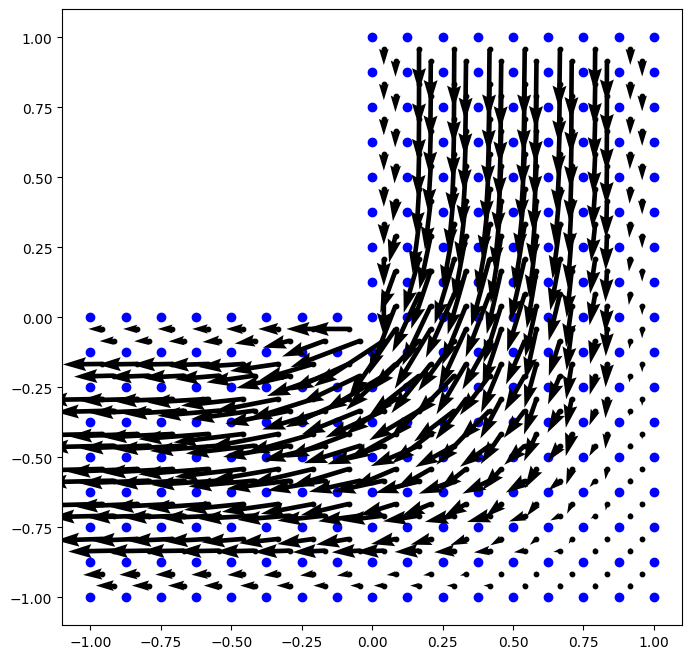

[52.63425935]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.14403893e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.12016885e-03
  1.76838389e-03  0.00000000e+00 -6.14743082e-04 -2.58816294e-04
  1.58935424e-03 -4.58925734e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.11648441e-03  6.31303415e-03  0.00000000e+00  3.07996780e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.49196158e-03 -2.66248945e-03
  0.00000000e+00 -8.40683538e-03  4.12643517e-03  6.97926260e-03
  6.87168298e-03  3.82567662e-03 -8.15891820e-03  7.63560493e-03
 -8.43729198e-03 -8.82163443e-04  7.39384158e-03 -9.08859776e-03
  2.77729246e-04  7.66141954e-03 -8.71453916e-03 -1.69583864e-04
  7.38632148e-03  3.73776850e-04 -8.85356475e-03  1.42406240e-03
 -9.6253887

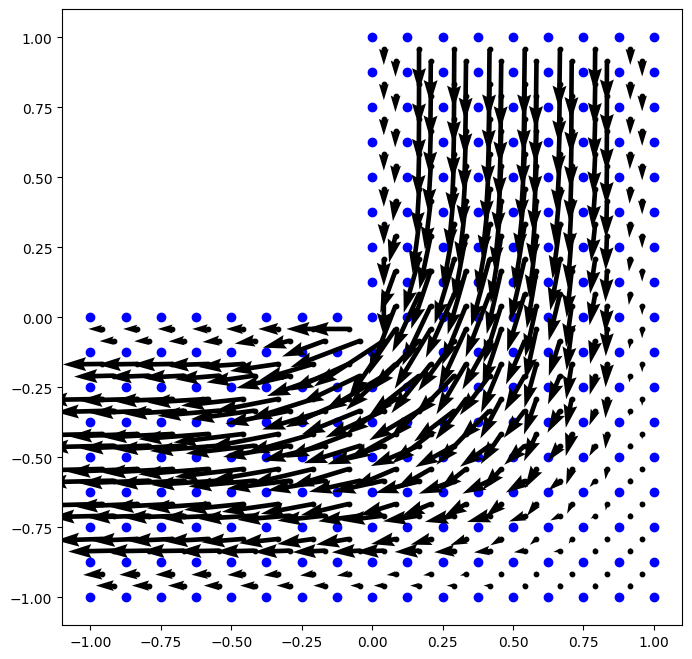

[0.55334482]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.15570672e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.13630439e-03
  1.78558334e-03  0.00000000e+00 -6.17616590e-04 -2.52769813e-04
  1.60443561e-03 -4.59738143e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.09804101e-03  6.32040859e-03  0.00000000e+00  3.07247750e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.49972253e-03 -2.64051662e-03
  0.00000000e+00 -8.41711306e-03  4.13258820e-03  6.98715555e-03
  6.87762590e-03  3.83179375e-03 -8.15367091e-03  7.62904359e-03
 -8.42957278e-03 -8.95774512e-04  7.39471961e-03 -9.09064633e-03
  2.84977041e-04  7.66396383e-03 -8.70480404e-03 -1.65770066e-04
  7.39136554e-03  3.84636746e-04 -8.84701662e-03  1.42536844e-03
 -9.36625608

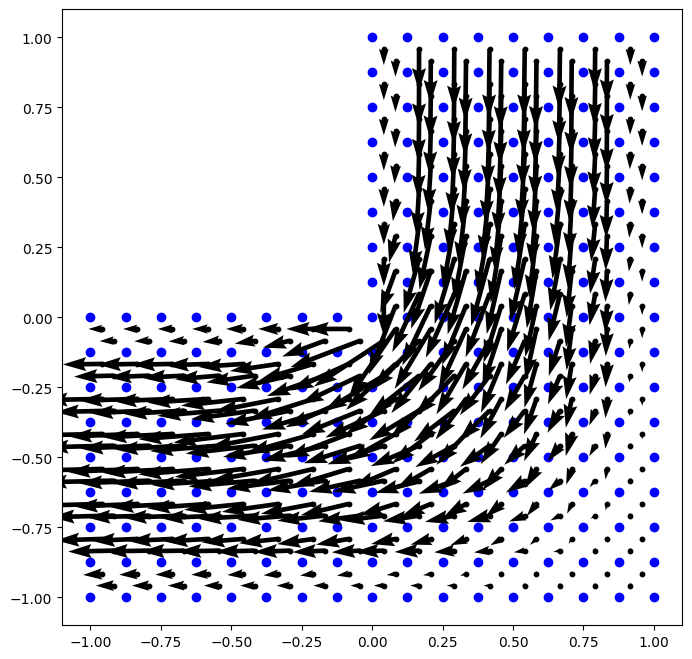

[1.93670421]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.14940867e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.12603567e-03
  1.77520291e-03  0.00000000e+00 -6.20010615e-04 -2.62436306e-04
  1.60588246e-03 -4.58880223e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.10854554e-03  6.30987737e-03  0.00000000e+00  3.07806705e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48832063e-03 -2.65329994e-03
  0.00000000e+00 -8.40836807e-03  4.12383623e-03  6.97836190e-03
  6.87171650e-03  3.82437221e-03 -8.15874386e-03  7.63558176e-03
 -8.43905214e-03 -8.91066051e-04  7.39451000e-03 -9.09120718e-03
  2.77555466e-04  7.66041794e-03 -8.71665310e-03 -1.71838836e-04
  7.38527078e-03  3.73391681e-04 -8.85536019e-03  1.42311078e-03
 -9.44112939

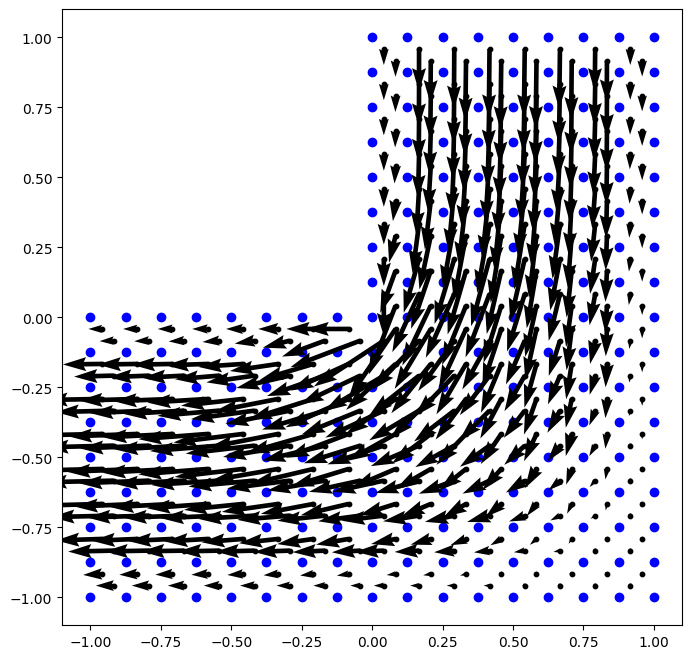

[0.39958334]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.15893306e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.13967683e-03
  1.79052084e-03  0.00000000e+00 -6.21925603e-04 -2.56402305e-04
  1.61799924e-03 -4.59594734e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.09323343e-03  6.31648186e-03  0.00000000e+00  3.07194692e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.49541264e-03 -2.63420172e-03
  0.00000000e+00 -8.41718552e-03  4.12935903e-03  6.98569066e-03
  6.87662050e-03  3.83011939e-03 -8.15450444e-03  7.62976678e-03
 -8.43175401e-03 -9.02008113e-04  7.39485262e-03 -9.09260660e-03
  2.84521642e-04  7.66288911e-03 -8.70786610e-03 -1.68345329e-04
  7.39018139e-03  3.83450254e-04 -8.84940241e-03  1.42438729e-03
 -9.22381130

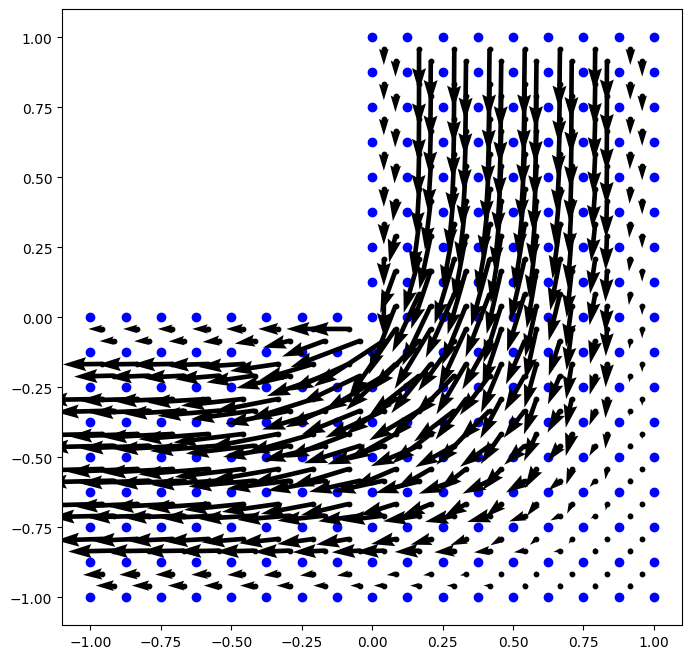

[0.96138495]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.15296100e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.13011384e-03
  1.78116774e-03  0.00000000e+00 -6.23492407e-04 -2.64751723e-04
  1.61745852e-03 -4.58866672e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.10240801e-03  6.30747340e-03  0.00000000e+00  3.07673701e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48569147e-03 -2.64505396e-03
  0.00000000e+00 -8.40965044e-03  4.12184591e-03  6.97767688e-03
  6.87162266e-03  3.82350742e-03 -8.15860248e-03  7.63530195e-03
 -8.44007750e-03 -8.96977364e-04  7.39471327e-03 -9.09332578e-03
  2.78168112e-04  7.65979636e-03 -8.71806798e-03 -1.73248570e-04
  7.38457418e-03  3.73239297e-04 -8.85655550e-03  1.42228031e-03
 -9.29710280

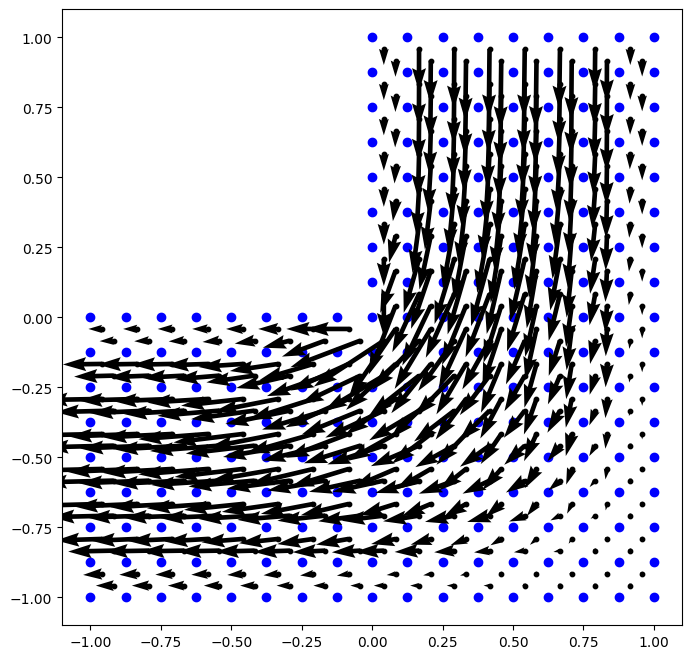

[0.32250607]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16085918e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14178749e-03
  1.79473893e-03  0.00000000e+00 -6.24773629e-04 -2.58975612e-04
  1.62743023e-03 -4.59493382e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08964415e-03  6.31342690e-03  0.00000000e+00  3.07167088e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.49217455e-03 -2.62863035e-03
  0.00000000e+00 -8.41722566e-03  4.12683870e-03  6.98446420e-03
  6.87575846e-03  3.82888465e-03 -8.15512069e-03  7.63019047e-03
 -8.43332671e-03 -9.05954983e-04  7.39475176e-03 -9.09423431e-03
  2.84691545e-04  7.66212500e-03 -8.71020109e-03 -1.70094435e-04
  7.38924575e-03  3.82442885e-04 -8.85119778e-03  1.42353862e-03
 -9.11535238

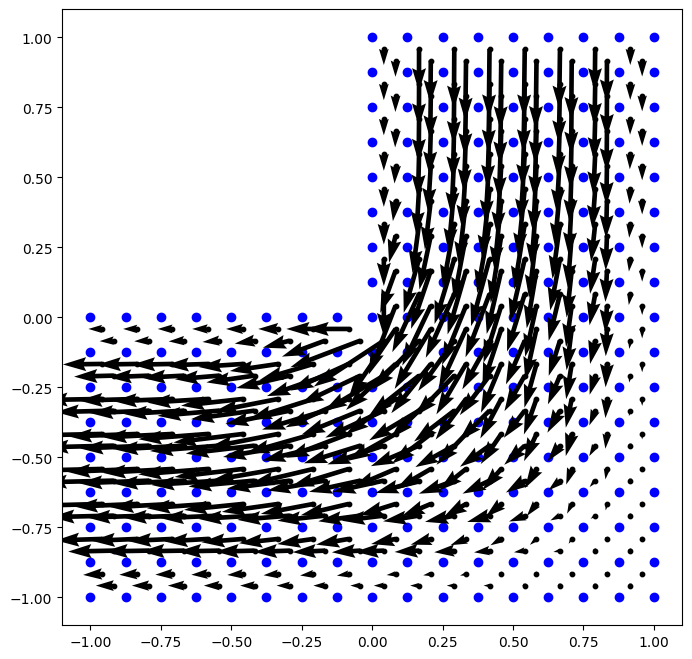

[0.62579069]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.15537479e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.13303464e-03
  1.78629874e-03  0.00000000e+00 -6.25789731e-04 -2.66223532e-04
  1.62571951e-03 -4.58871129e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.09773097e-03  6.30564786e-03  0.00000000e+00  3.07577474e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48379255e-03 -2.63808083e-03
  0.00000000e+00 -8.41073204e-03  4.12034129e-03  6.97719091e-03
  6.87153101e-03  3.82295362e-03 -8.15848940e-03  7.63492586e-03
 -8.44066120e-03 -9.01004627e-04  7.39472245e-03 -9.09503243e-03
  2.79209933e-04  7.65941332e-03 -8.71900656e-03 -1.74132148e-04
  7.38412771e-03  3.73252968e-04 -8.85734991e-03  1.42159586e-03
 -9.18629546

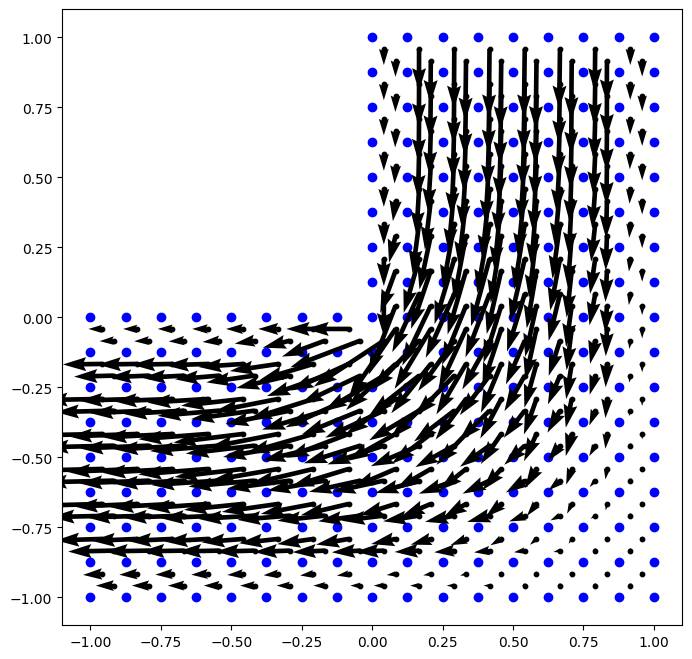

[0.28042688]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16200537e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14310380e-03
  1.79825711e-03  0.00000000e+00 -6.26645575e-04 -2.60831850e-04
  1.63407200e-03 -4.59419509e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08703005e-03  6.31103459e-03  0.00000000e+00  3.07153994e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48971582e-03 -2.62402016e-03
  0.00000000e+00 -8.41724654e-03  4.12487273e-03  6.98344791e-03
  6.87506578e-03  3.82795736e-03 -8.15558684e-03  7.63045505e-03
 -8.43449741e-03 -9.08482546e-04  7.39458859e-03 -9.09557224e-03
  2.85198614e-04  7.66156978e-03 -8.71200186e-03 -1.71307945e-04
  7.38850235e-03  3.81596594e-04 -8.85256495e-03  1.42283270e-03
 -9.03404429

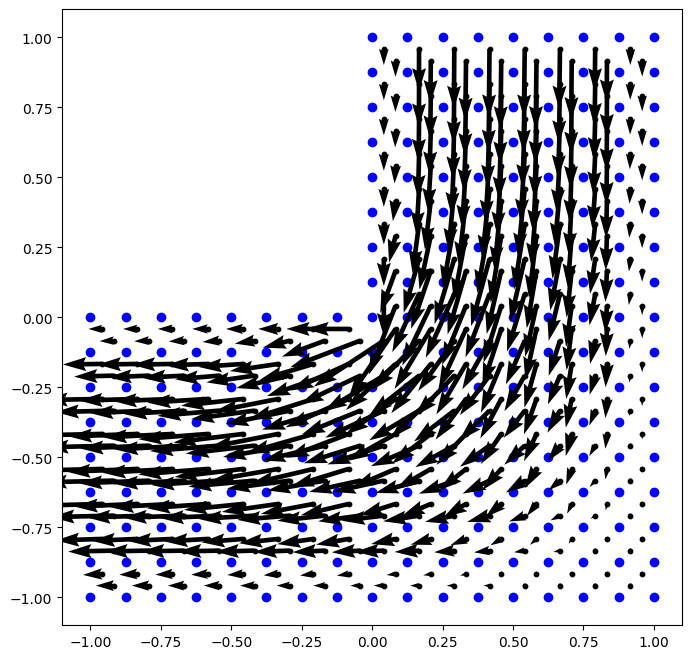

[0.45511986]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.15706514e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.13517462e-03
  1.79062441e-03  0.00000000e+00 -6.27295212e-04 -2.67148639e-04
  1.63170300e-03 -4.58885120e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.09418591e-03  6.30427214e-03  0.00000000e+00  3.07505954e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48243079e-03 -2.63237244e-03
  0.00000000e+00 -8.41164582e-03  4.11921794e-03  6.97687023e-03
  6.87147309e-03  3.82261569e-03 -8.15839462e-03  7.63453669e-03
 -8.44097044e-03 -9.03815504e-04  7.39465997e-03 -9.09639062e-03
  2.80424606e-04  7.65918293e-03 -8.71961702e-03 -1.74685581e-04
  7.38385757e-03  3.73373391e-04 -8.85787034e-03  1.42105247e-03
 -9.10170415

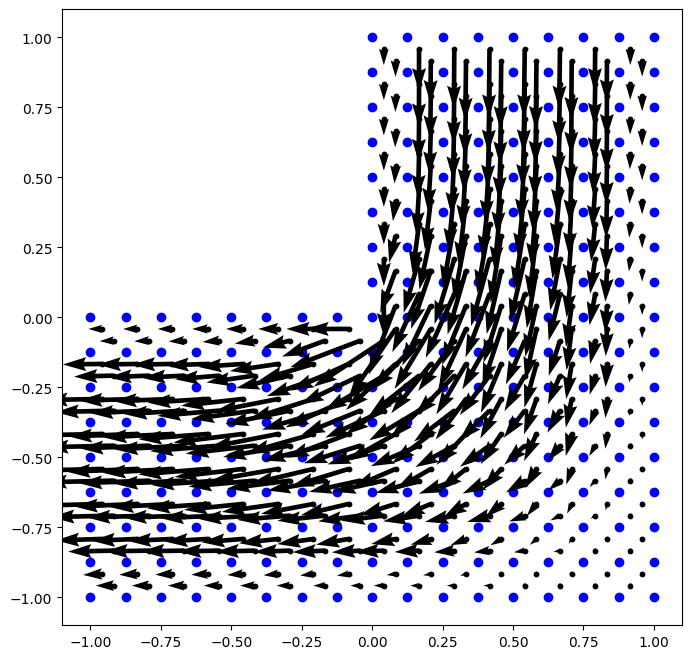

[0.24436278]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16268208e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14390762e-03
  1.80111751e-03  0.00000000e+00 -6.27863997e-04 -2.62195842e-04
  1.63879148e-03 -4.59364034e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08515956e-03  6.30915432e-03  0.00000000e+00  3.07149212e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48783392e-03 -2.62034686e-03
  0.00000000e+00 -8.41725190e-03  4.12333821e-03  6.98260872e-03
  6.87452219e-03  3.82724631e-03 -8.15594487e-03  7.63063646e-03
 -8.43538931e-03 -9.10112581e-04  7.39443174e-03 -9.09665710e-03
  2.85842401e-04  7.66115791e-03 -8.71340309e-03 -1.72167994e-04
  7.38790705e-03  3.80885105e-04 -8.85361543e-03  1.42225899e-03
 -8.97369112

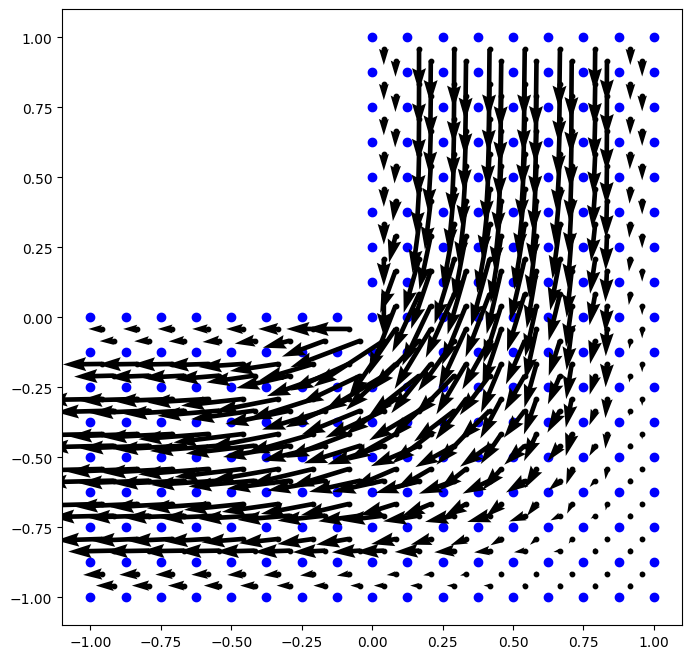

[0.35139521]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.15828443e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.13677230e-03
  1.79420724e-03  0.00000000e+00 -6.28272521e-04 -2.67718026e-04
  1.63608838e-03 -4.58903608e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.09149992e-03  6.30324692e-03  0.00000000e+00  3.07451557e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48146569e-03 -2.62778714e-03
  0.00000000e+00 -8.41241606e-03  4.11839057e-03  6.97667851e-03
  6.87144984e-03  3.82242595e-03 -8.15831175e-03  7.63417267e-03
 -8.44110608e-03 -9.05820608e-04  7.39457885e-03 -9.09745747e-03
  2.81648122e-04  7.65905048e-03 -8.72000017e-03 -1.75029197e-04
  7.38370953e-03  3.73555750e-04 -8.85820192e-03  1.42063229e-03
 -9.03734026

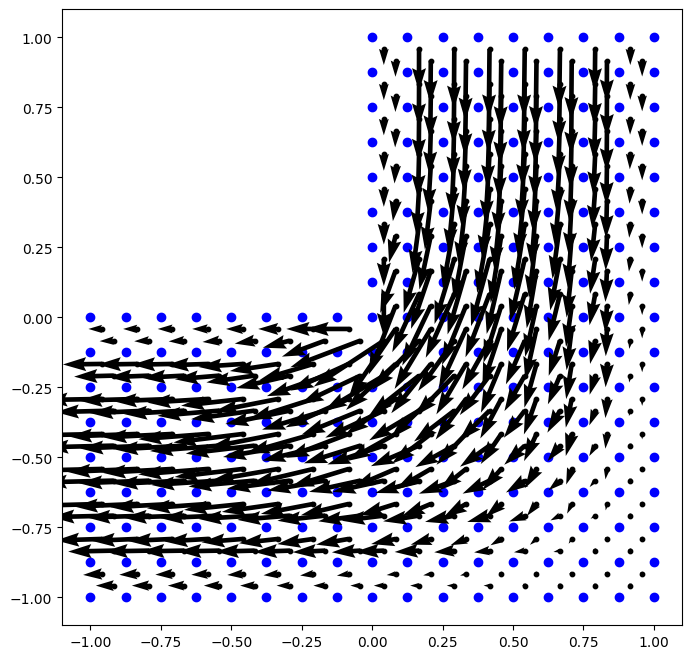

[0.21329755]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16307371e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14437690e-03
  1.80338974e-03  0.00000000e+00 -6.28647193e-04 -2.63216397e-04
  1.64216417e-03 -4.59321222e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08384132e-03  6.30767253e-03  0.00000000e+00  3.07149164e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48638277e-03 -2.61749286e-03
  0.00000000e+00 -8.41724275e-03  4.12213828e-03  6.98191512e-03
  6.87409825e-03  3.82668930e-03 -8.15622371e-03  7.63077459e-03
 -8.43608150e-03 -9.11165111e-04  7.39430414e-03 -9.09752553e-03
  2.86498786e-04  7.66084600e-03 -8.71450197e-03 -1.72790097e-04
  7.38742561e-03  3.80283905e-04 -8.85442930e-03  1.42179893e-03
 -8.92921194

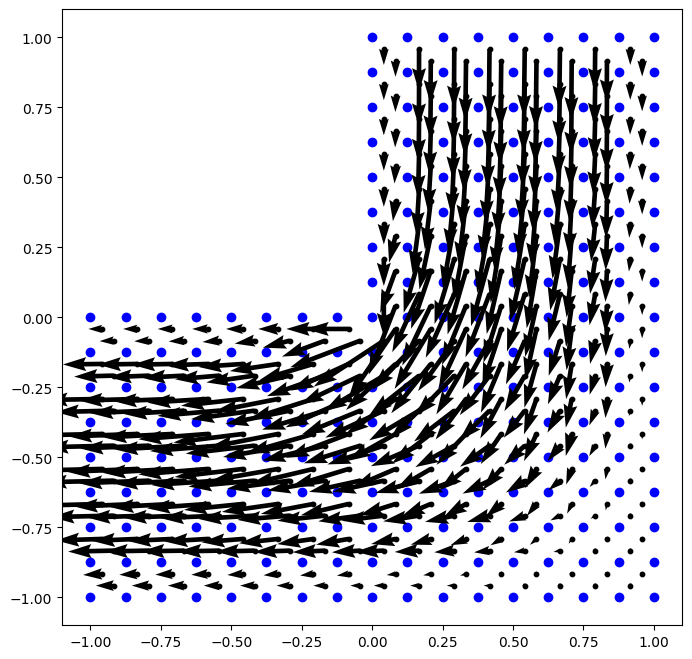

[0.28150624]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.15918778e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.13798510e-03
  1.79713390e-03  0.00000000e+00 -6.28900101e-04 -2.68055347e-04
  1.63933344e-03 -4.58923637e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08945961e-03  6.30249327e-03  0.00000000e+00  3.07409388e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48079263e-03 -2.62414569e-03
  0.00000000e+00 -8.41306282e-03  4.11779044e-03  6.97658303e-03
  6.87145384e-03  3.82233679e-03 -8.15823736e-03  7.63384872e-03
 -8.44113233e-03 -9.07278825e-04  7.39450050e-03 -9.09828564e-03
  2.82787799e-04  7.65898088e-03 -8.72022615e-03 -1.75238016e-04
  7.38364453e-03  3.73769128e-04 -8.85840349e-03  1.42031405e-03
 -8.98840262

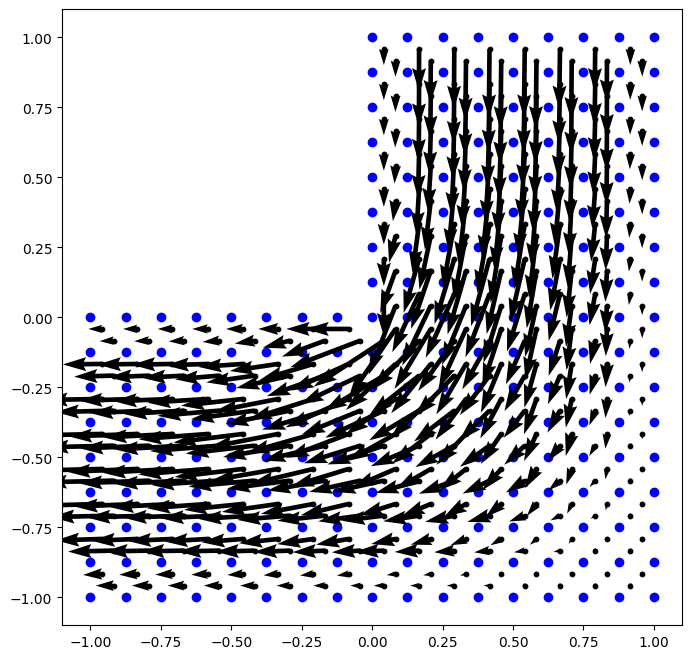

[0.1864406]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16329044e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14462722e-03
  1.80515808e-03  0.00000000e+00 -6.29143147e-04 -2.63993339e-04
  1.64458153e-03 -4.59287372e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08292664e-03  6.30650177e-03  0.00000000e+00  3.07151782e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48525542e-03 -2.61531658e-03
  0.00000000e+00 -8.41722016e-03  4.12119717e-03  6.98133993e-03
  6.87376667e-03  3.82624394e-03 -8.15644373e-03  7.63088985e-03
 -8.43662755e-03 -9.11840659e-04  7.39420928e-03 -9.09821348e-03
  2.87100021e-04  7.66060510e-03 -8.71537008e-03 -1.73248939e-04
  7.38703213e-03  3.79772784e-04 -8.85506509e-03  1.42143261e-03
 -8.89662766e

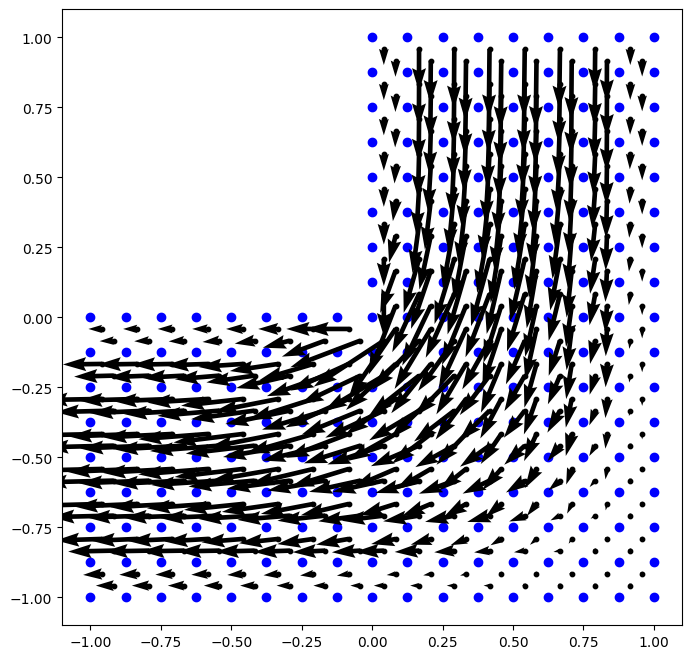

[0.23114415]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.15987256e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.13891987e-03
  1.79950014e-03  0.00000000e+00 -6.29298311e-04 -2.68241339e-04
  1.64175414e-03 -4.58943520e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08790293e-03  6.30194832e-03  0.00000000e+00  3.07376197e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48033354e-03 -2.62127341e-03
  0.00000000e+00 -8.41360379e-03  4.11736305e-03  6.97655685e-03
  6.87147674e-03  3.82231496e-03 -8.15816963e-03  7.63356809e-03
 -8.44109124e-03 -9.08357593e-04  7.39443217e-03 -9.09892209e-03
  2.83799740e-04  7.65895153e-03 -8.72034428e-03 -1.75359638e-04
  7.38363498e-03  3.73993359e-04 -8.85851608e-03  1.42007749e-03
 -8.95116068

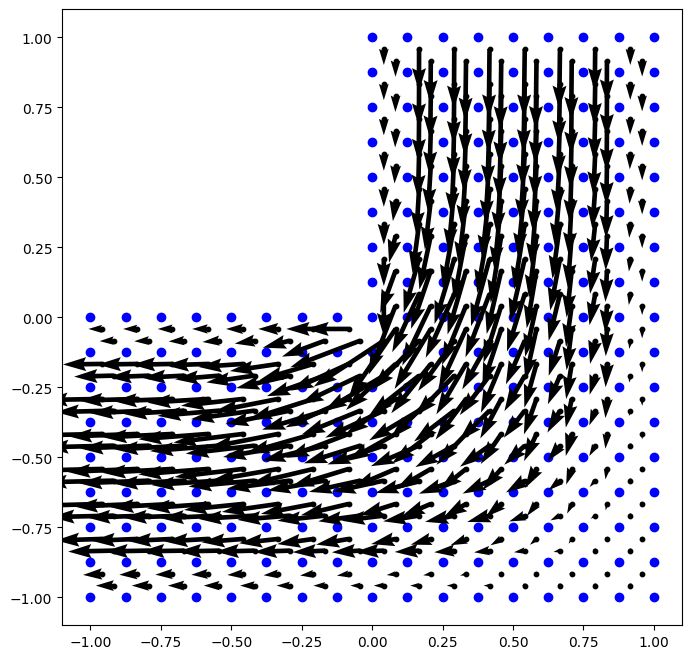

[0.16315759]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16339893e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14473494e-03
  1.80650898e-03  0.00000000e+00 -6.29451596e-04 -2.64594601e-04
  1.64631506e-03 -4.59260045e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08230357e-03  6.30557416e-03  0.00000000e+00  3.07155854e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48437301e-03 -2.61368262e-03
  0.00000000e+00 -8.41718588e-03  4.12045613e-03  6.98086076e-03
  6.87350531e-03  3.82588123e-03 -8.15661947e-03  7.63099215e-03
 -8.43706487e-03 -9.12267482e-04  7.39414317e-03 -9.09875411e-03
  2.87615622e-04  7.66041562e-03 -8.71606078e-03 -1.73593713e-04
  7.38670730e-03  3.79335734e-04 -8.85556587e-03  1.42114174e-03
 -8.87289553

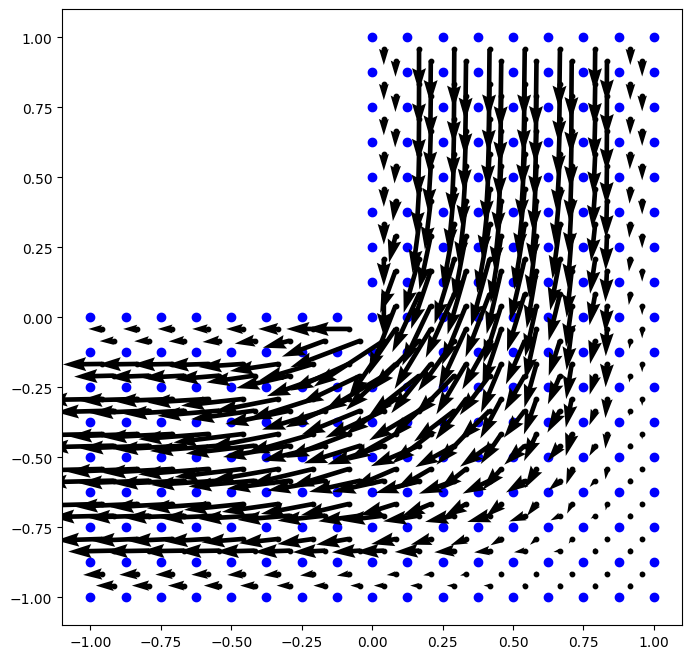

[0.19311213]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16040157e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.13965070e-03
  1.80139950e-03  0.00000000e+00 -6.29547673e-04 -2.68329103e-04
  1.64357280e-03 -4.58962337e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08670854e-03  6.30156234e-03  0.00000000e+00  3.07349754e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48003026e-03 -2.61901639e-03
  0.00000000e+00 -8.41405476e-03  4.11706577e-03  6.97657886e-03
  6.87151161e-03  3.82233733e-03 -8.15810757e-03  7.63332847e-03
 -8.44101059e-03 -9.09167889e-04  7.39437503e-03 -9.09940703e-03
  2.84670478e-04  7.65894776e-03 -8.72038935e-03 -1.75424715e-04
  7.38366154e-03  3.74215881e-04 -8.85856837e-03  1.41990496e-03
 -8.92276276

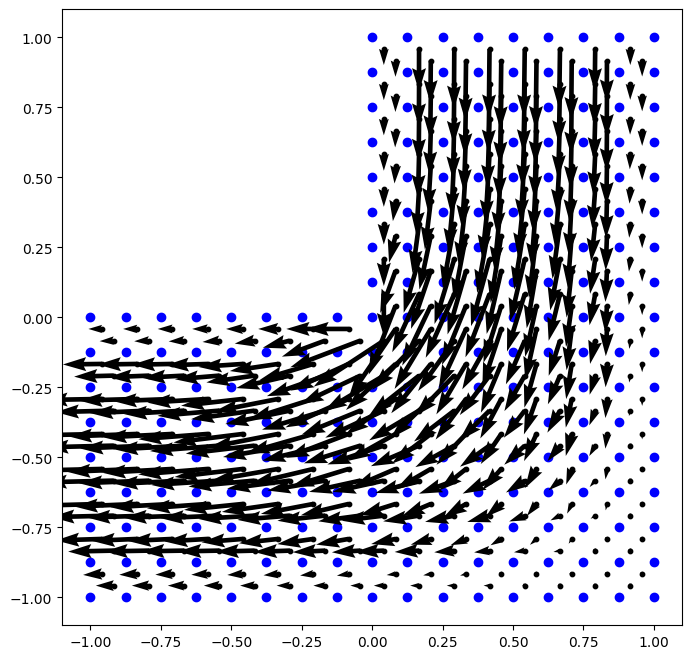

[0.14292843]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16344018e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14475108e-03
  1.80752300e-03  0.00000000e+00 -6.29639162e-04 -2.65067074e-04
  1.64755607e-03 -4.59237598e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08188936e-03  6.30483682e-03  0.00000000e+00  3.07160658e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48367705e-03 -2.61247313e-03
  0.00000000e+00 -8.41714219e-03  4.11986985e-03  6.98045954e-03
  6.87329717e-03  3.82558108e-03 -8.15676142e-03  7.63108589e-03
 -8.43742004e-03 -9.12529156e-04  7.39409972e-03 -9.09917648e-03
  2.88037666e-04  7.66026408e-03 -8.71661418e-03 -1.73857376e-04
  7.38643661e-03  3.78960184e-04 -8.85596356e-03  1.42091066e-03
 -8.85571960

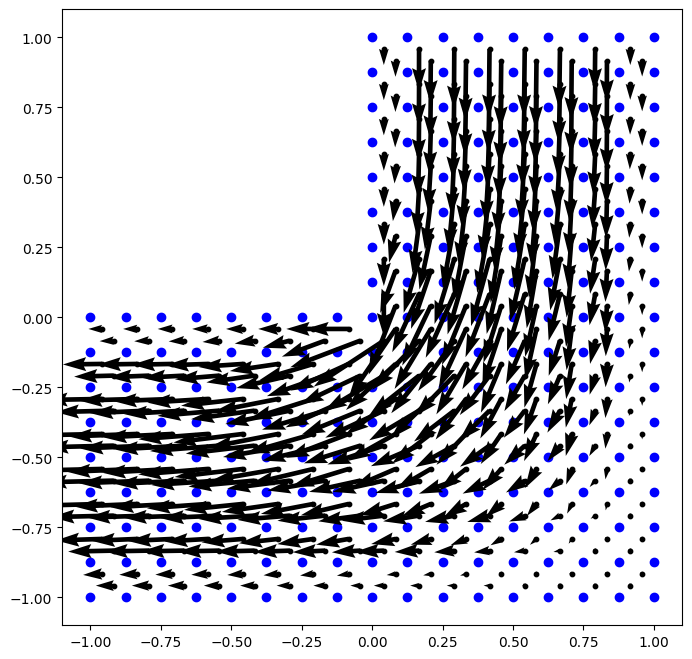

[0.16339268]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16081662e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14022980e-03
  1.80291697e-03  0.00000000e+00 -6.29701524e-04 -2.68353761e-04
  1.64494821e-03 -4.58979635e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08578619e-03  6.30129628e-03  0.00000000e+00  3.07328476e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47983950e-03 -2.61724577e-03
  0.00000000e+00 -8.41442982e-03  4.11686555e-03  6.97663301e-03
  6.87155328e-03  3.82238782e-03 -8.15805061e-03  7.63312530e-03
 -8.44090866e-03 -9.09784937e-04  7.39432799e-03 -9.09977375e-03
  2.85403905e-04  7.65895994e-03 -8.72038590e-03 -1.75453219e-04
  7.38371070e-03  3.74429266e-04 -8.85858042e-03  1.41978184e-03
 -8.90104790

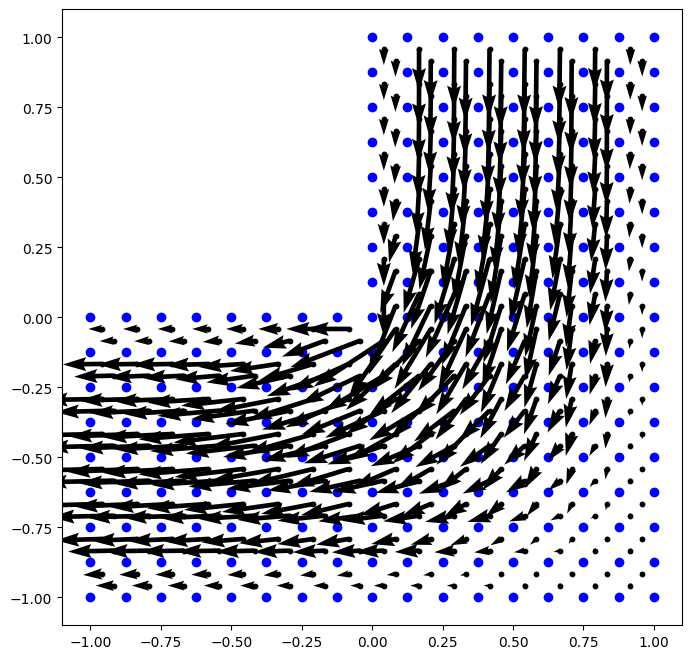

[0.12532048]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16343988e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14470991e-03
  1.80827073e-03  0.00000000e+00 -6.29749890e-04 -2.65443590e-04
  1.64844090e-03 -4.59218895e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08162349e-03  6.30424854e-03  0.00000000e+00  3.07165751e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48312385e-03 -2.61159061e-03
  0.00000000e+00 -8.41709166e-03  4.11940343e-03  6.98012183e-03
  6.87312953e-03  3.82532935e-03 -8.15687727e-03  7.63117281e-03
 -8.43771217e-03 -9.12681000e-04  7.39407304e-03 -9.09950514e-03
  2.88370664e-04  7.66014105e-03 -8.71706062e-03 -1.74062363e-04
  7.38620910e-03  3.78636196e-04 -8.85628194e-03  1.42072651e-03
 -8.84338091

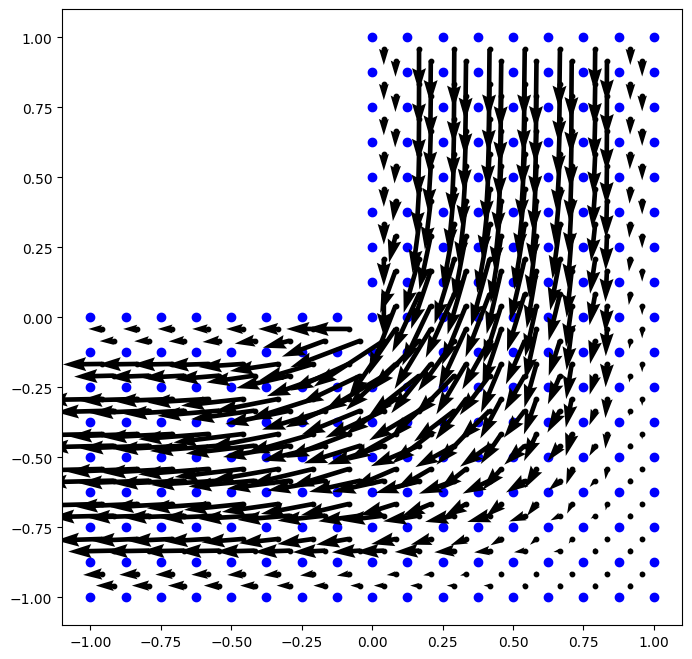

[0.13956437]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16114643e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14069452e-03
  1.80412617e-03  0.00000000e+00 -6.29794808e-04 -2.68338641e-04
  1.64599509e-03 -4.58995242e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08506889e-03  6.30111973e-03  0.00000000e+00  3.07311209e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47972920e-03 -2.61585684e-03
  0.00000000e+00 -8.41474129e-03  4.11673699e-03  6.97670740e-03
  6.87159816e-03  3.82245526e-03 -8.15799842e-03  7.63295347e-03
 -8.44079734e-03 -9.10260757e-04  7.39428937e-03 -9.10004916e-03
  2.86012702e-04  7.65898171e-03 -8.72035121e-03 -1.75458294e-04
  7.38377309e-03  3.74629437e-04 -8.85856627e-03  1.41969636e-03
 -8.88438586

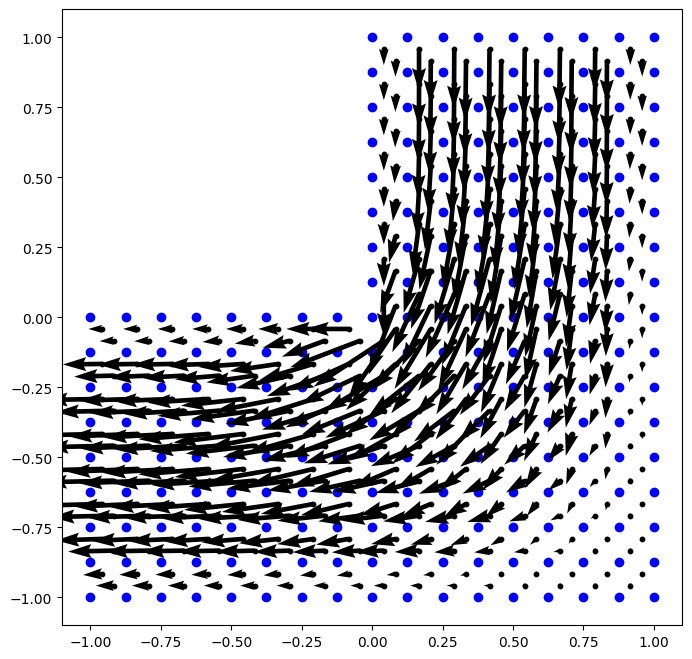

[0.10997018]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16341442e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14463442e-03
  1.80881157e-03  0.00000000e+00 -6.29812580e-04 -2.65747483e-04
  1.64906761e-03 -4.59203135e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08146203e-03  6.30377716e-03  0.00000000e+00  3.07170862e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48268066e-03 -2.61095675e-03
  0.00000000e+00 -8.41703675e-03  4.11903007e-03  6.97983612e-03
  6.87299299e-03  3.82511586e-03 -8.15697274e-03  7.63125346e-03
 -8.43795521e-03 -9.12760082e-04  7.39405825e-03 -9.09976021e-03
  2.88625089e-04  7.66003981e-03 -8.71742323e-03 -1.74224193e-04
  7.38601643e-03  3.78355809e-04 -8.85653888e-03  1.42057903e-03
 -8.83459869

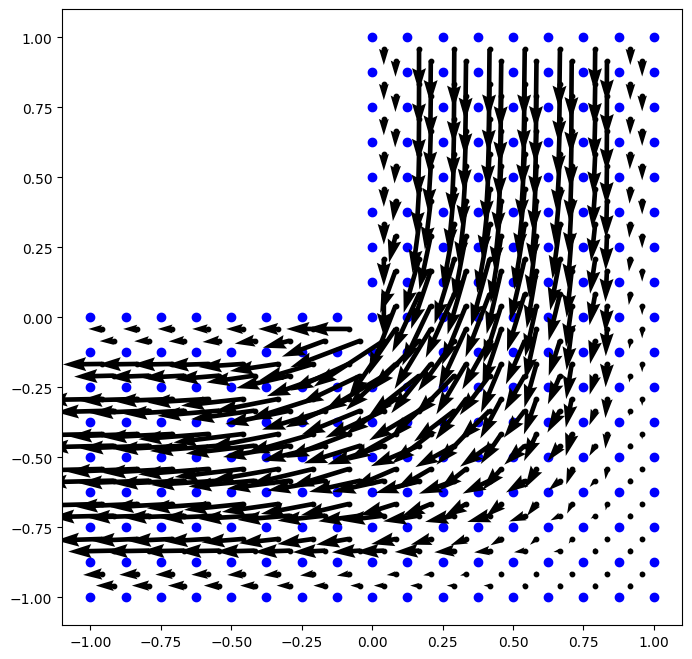

[0.12007868]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16141130e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14107185e-03
  1.80508888e-03  0.00000000e+00 -6.29850164e-04 -2.68299273e-04
  1.64679708e-03 -4.59009147e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08450688e-03  6.30100922e-03  0.00000000e+00  3.07297092e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47967561e-03 -2.61476602e-03
  0.00000000e+00 -8.41499984e-03  4.11666073e-03  6.97679331e-03
  6.87164383e-03  3.82253195e-03 -8.15795072e-03  7.63280816e-03
 -8.44068424e-03 -9.10631957e-04  7.39425754e-03 -9.10025462e-03
  2.86513080e-04  7.65900886e-03 -8.72029738e-03 -1.75448653e-04
  7.38384225e-03  3.74814457e-04 -8.85853573e-03  1.41963923e-03
 -8.87154931

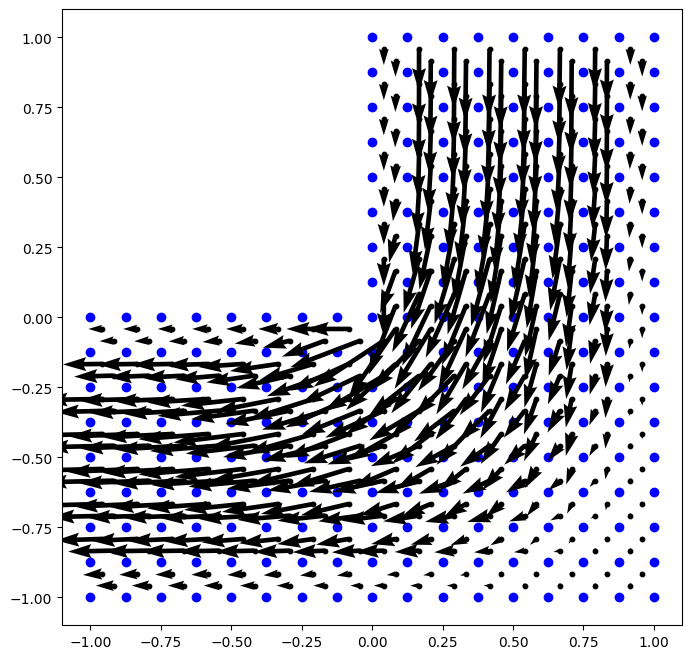

[0.09656983]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16337439e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14454002e-03
  1.80919404e-03  0.00000000e+00 -6.29845842e-04 -2.65995581e-04
  1.64950714e-03 -4.59189737e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08137324e-03  6.30339761e-03  0.00000000e+00  3.07175819e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48232275e-03 -2.61050995e-03
  0.00000000e+00 -8.41697971e-03  4.11872920e-03  6.97959320e-03
  6.87288055e-03  3.82493313e-03 -8.15705209e-03  7.63132797e-03
 -8.43815942e-03 -9.12791455e-04  7.39405156e-03 -9.09995794e-03
  2.88813501e-04  7.65995551e-03 -8.71771970e-03 -1.74353760e-04
  7.38585216e-03  3.78112545e-04 -8.85674786e-03  1.42046010e-03
 -8.82842176

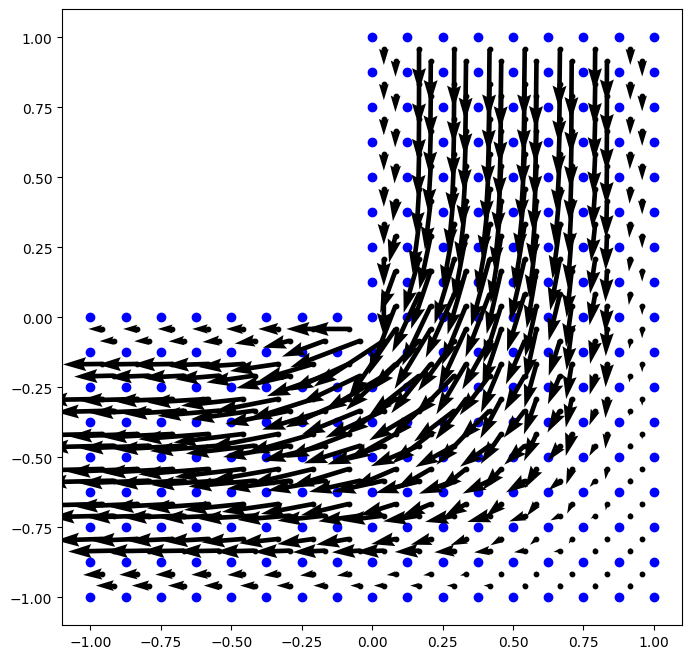

[0.10389715]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16162596e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14138159e-03
  1.80585580e-03  0.00000000e+00 -6.29882093e-04 -2.68245996e-04
  1.64741558e-03 -4.59021428e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08406313e-03  6.30094674e-03  0.00000000e+00  3.07285473e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47966132e-03 -2.61390740e-03
  0.00000000e+00 -8.41521452e-03  4.11662207e-03  6.97688455e-03
  6.87168871e-03  3.82261259e-03 -8.15790728e-03  7.63268507e-03
 -8.44057404e-03 -9.10924686e-04  7.39423116e-03 -9.10040685e-03
  2.86921745e-04  7.65903862e-03 -8.72023283e-03 -1.75430100e-04
  7.38391380e-03  3.74983717e-04 -8.85849558e-03  1.41960321e-03
 -8.86161480

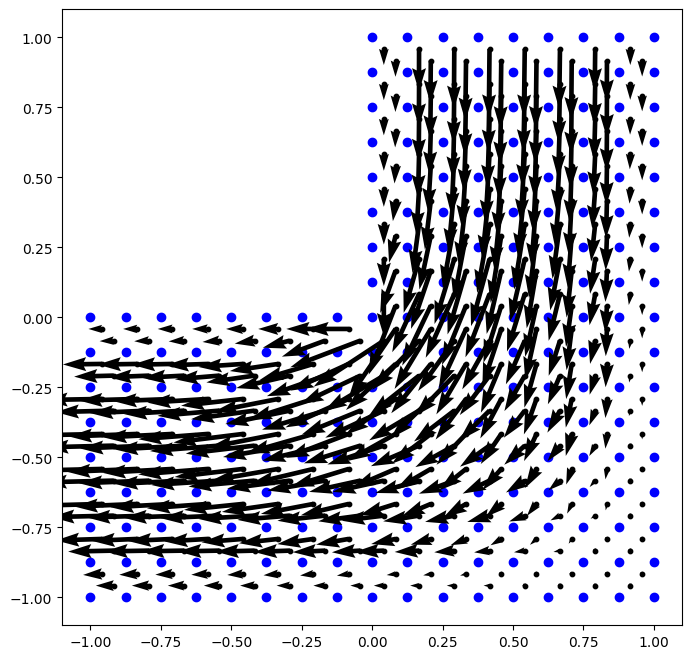

[0.08485757]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16332667e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14443689e-03
  1.80945691e-03  0.00000000e+00 -6.29861548e-04 -2.66200204e-04
  1.64981107e-03 -4.59178271e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08133432e-03  6.30309036e-03  0.00000000e+00  3.07180521e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48203142e-03 -2.61020244e-03
  0.00000000e+00 -8.41692241e-03  4.11848502e-03  6.97938570e-03
  6.87278701e-03  3.82477555e-03 -8.15711857e-03  7.63139637e-03
 -8.43833250e-03 -9.12792132e-04  7.39405020e-03 -9.10011122e-03
  2.88948373e-04  7.65988458e-03 -8.71796368e-03 -1.74458835e-04
  7.38571128e-03  3.77901061e-04 -8.85691911e-03  1.42036345e-03
 -8.82414547

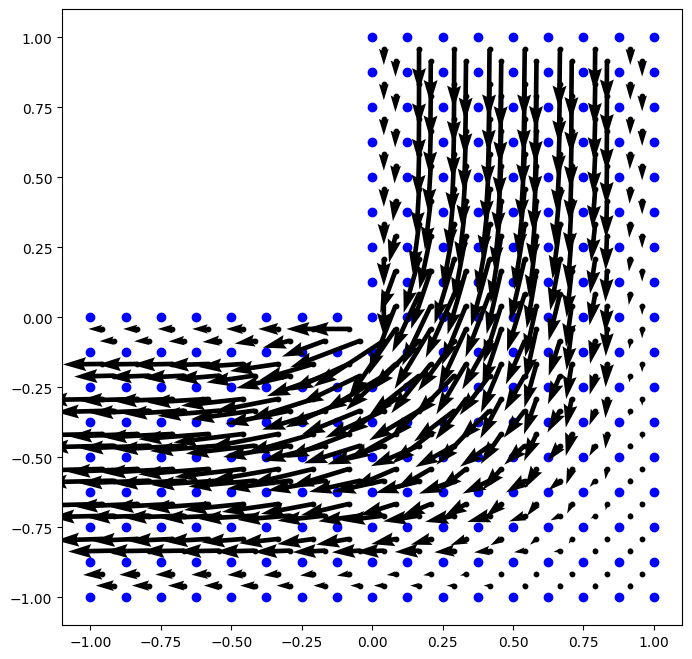

[0.09029546]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16180133e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14163838e-03
  1.80646788e-03  0.00000000e+00 -6.29899771e-04 -2.68185665e-04
  1.64789590e-03 -4.59032211e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08370997e-03  6.30091864e-03  0.00000000e+00  3.07275850e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47967357e-03 -2.61322943e-03
  0.00000000e+00 -8.41539298e-03  4.11661000e-03  6.97697677e-03
  6.87173180e-03  3.82269361e-03 -8.15786787e-03  7.63258056e-03
 -8.44046951e-03 -9.11157873e-04  7.39420914e-03 -9.10051881e-03
  2.87254302e-04  7.65906915e-03 -8.72016333e-03 -1.75406507e-04
  7.38398481e-03  3.75137412e-04 -8.85845047e-03  1.41958272e-03
 -8.85388727

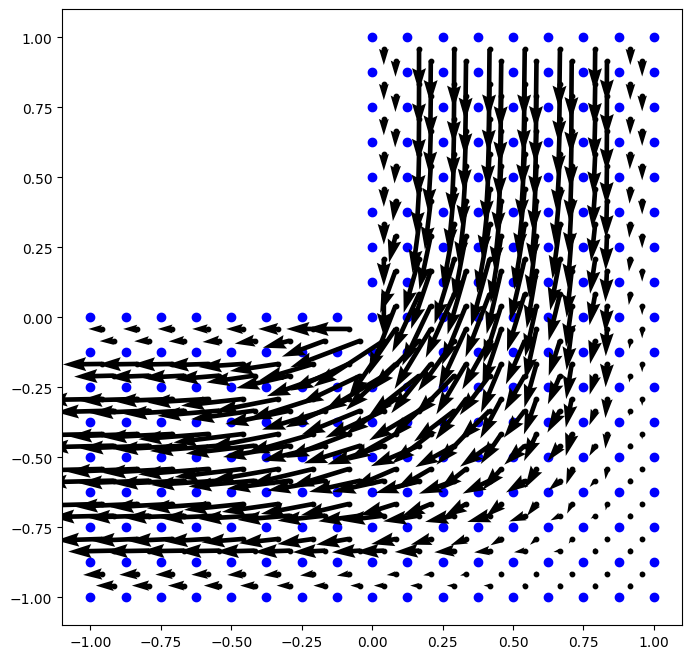

[0.07460967]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16327579e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14433170e-03
  1.80963062e-03  0.00000000e+00 -6.29867166e-04 -2.66370503e-04
  1.65001699e-03 -4.59168408e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08132894e-03  6.30284018e-03  0.00000000e+00  3.07184909e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48179242e-03 -2.60999762e-03
  0.00000000e+00 -8.41686631e-03  4.11828537e-03  6.97920769e-03
  6.87270847e-03  3.82463881e-03 -8.15717468e-03  7.63145873e-03
 -8.43848026e-03 -9.12773679e-04  7.39405219e-03 -9.10023018e-03
  2.89041007e-04  7.65982437e-03 -8.71816572e-03 -1.74545036e-04
  7.38558984e-03  3.77716891e-04 -8.85706048e-03  1.42028420e-03
 -8.82124888

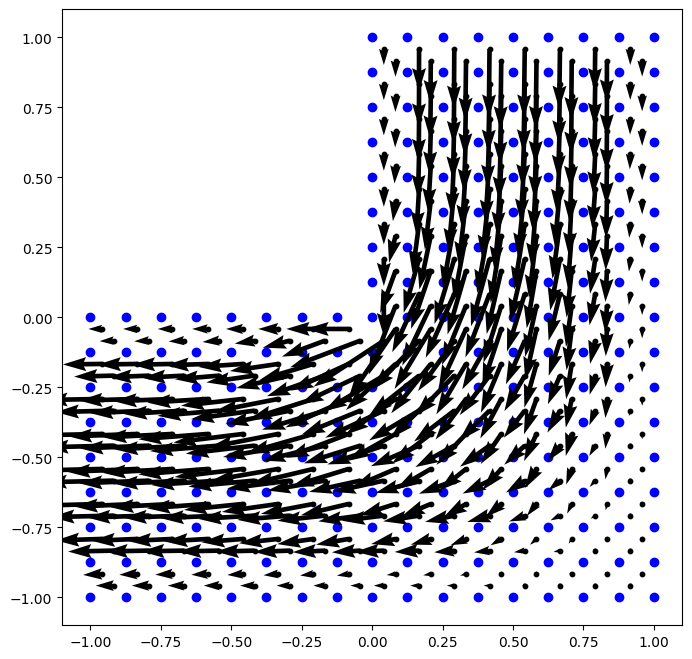

[0.07875144]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16194562e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14185317e-03
  1.80695780e-03  0.00000000e+00 -6.29908929e-04 -2.68122785e-04
  1.64827164e-03 -4.59041640e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08342667e-03  6.30091464e-03  0.00000000e+00  3.07267835e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47970312e-03 -2.61269200e-03
  0.00000000e+00 -8.41554157e-03  4.11661627e-03  6.97706704e-03
  6.87177252e-03  3.82277264e-03 -8.15783223e-03  7.63249162e-03
 -8.44037213e-03 -9.11345380e-04  7.39419068e-03 -9.10060045e-03
  2.87524535e-04  7.65909926e-03 -8.72009276e-03 -1.75380449e-04
  7.38405339e-03  3.75276209e-04 -8.85840358e-03  1.41957350e-03
 -8.84784311

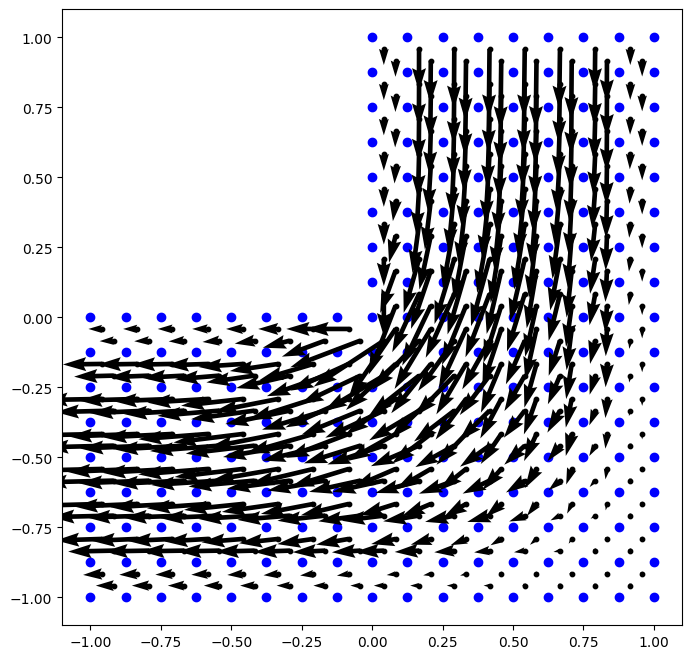

[0.06563427]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16322463e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14422866e-03
  1.80973877e-03  0.00000000e+00 -6.29867307e-04 -2.66513369e-04
  1.65015237e-03 -4.59159891e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08134549e-03  6.30263522e-03  0.00000000e+00  3.07188956e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48159486e-03 -2.60986767e-03
  0.00000000e+00 -8.41681252e-03  4.11812090e-03  6.97905440e-03
  6.87264196e-03  3.82451958e-03 -8.15722234e-03  7.63151524e-03
 -8.43860718e-03 -9.12743940e-04  7.39405613e-03 -9.10032271e-03
  2.89101098e-04  7.65977287e-03 -8.71833403e-03 -1.74616486e-04
  7.38548471e-03  3.77556275e-04 -8.85717798e-03  1.42021861e-03
 -8.81934777

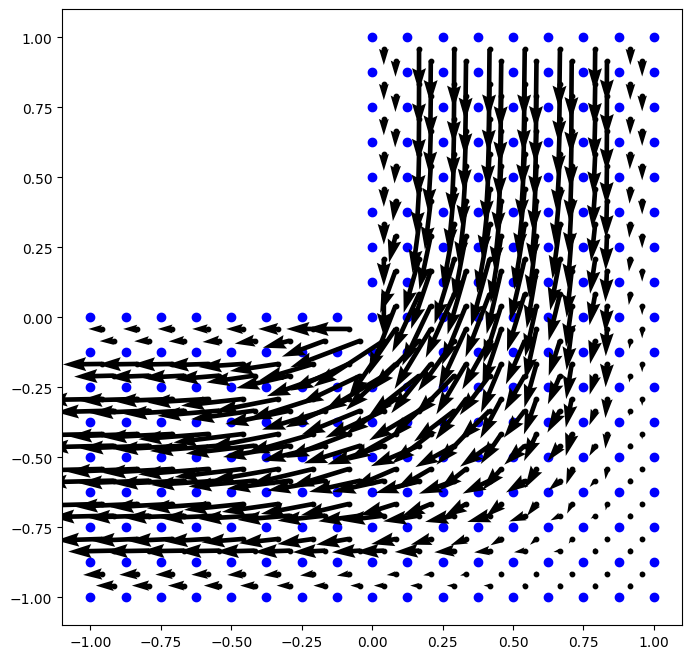

[0.06887775]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16206510e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14203426e-03
  1.80735145e-03  0.00000000e+00 -6.29913101e-04 -2.68060269e-04
  1.64856785e-03 -4.59049862e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08319759e-03  6.30092708e-03  0.00000000e+00  3.07261123e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47974332e-03 -2.61226403e-03
  0.00000000e+00 -8.41566556e-03  4.11663480e-03  6.97715343e-03
  6.87181054e-03  3.82284818e-03 -8.15780010e-03  7.63241571e-03
 -8.44028256e-03 -9.11497472e-04  7.39417514e-03 -9.10065936e-03
  2.87744195e-04  7.65912821e-03 -8.72002368e-03 -1.75353622e-04
  7.38411837e-03  3.75401031e-04 -8.85835699e-03  1.41957231e-03
 -8.84308728

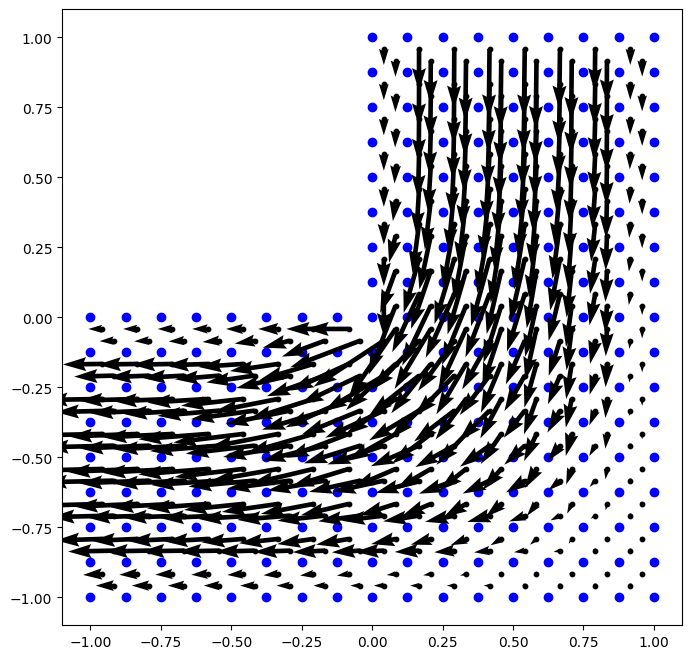

[0.05802809]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16317504e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14413037e-03
  1.80979940e-03  0.00000000e+00 -6.29864762e-04 -2.66634065e-04
  1.65023726e-03 -4.59152517e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08137579e-03  6.30246625e-03  0.00000000e+00  3.07192653e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48143035e-03 -2.60979164e-03
  0.00000000e+00 -8.41676178e-03  4.11798441e-03  6.97892191e-03
  6.87258523e-03  3.82441517e-03 -8.15726304e-03  7.63156616e-03
 -8.43871678e-03 -9.12708193e-04  7.39406109e-03 -9.10039493e-03
  2.89136653e-04  7.65972854e-03 -8.71847506e-03 -1.74676253e-04
  7.38539337e-03  3.77416022e-04 -8.85727628e-03  1.42016381e-03
 -8.81815938

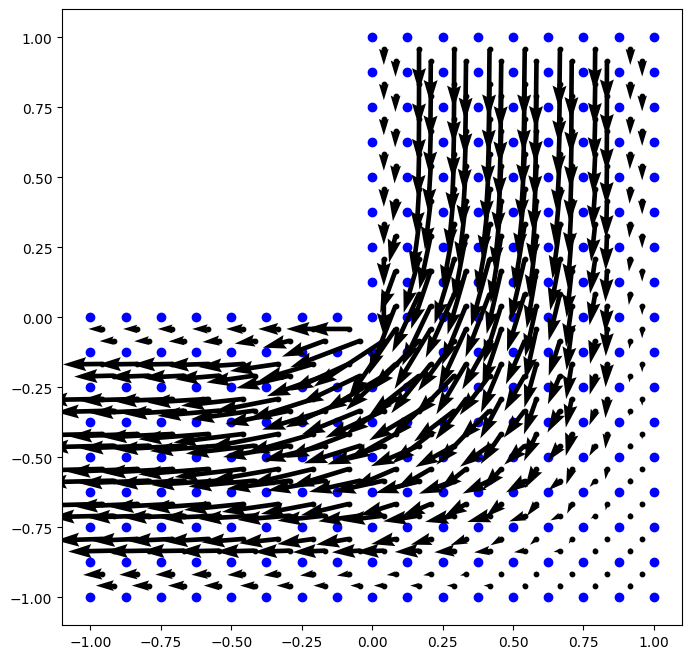

[0.06037992]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16216462e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14218801e-03
  1.80766918e-03  0.00000000e+00 -6.29914429e-04 -2.67999947e-04
  1.64880324e-03 -4.59057019e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08301091e-03  6.30095029e-03  0.00000000e+00  3.07255476e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47978944e-03 -2.61192144e-03
  0.00000000e+00 -8.41576925e-03  4.11666113e-03  6.97723477e-03
  6.87184574e-03  3.82291931e-03 -8.15777123e-03  7.63235077e-03
 -8.44020092e-03 -9.11621826e-04  7.39416202e-03 -9.10070132e-03
  2.87923060e-04  7.65915555e-03 -8.71995771e-03 -1.75327125e-04
  7.38417909e-03  3.75512924e-04 -8.85831203e-03  1.41957671e-03
 -8.83932126

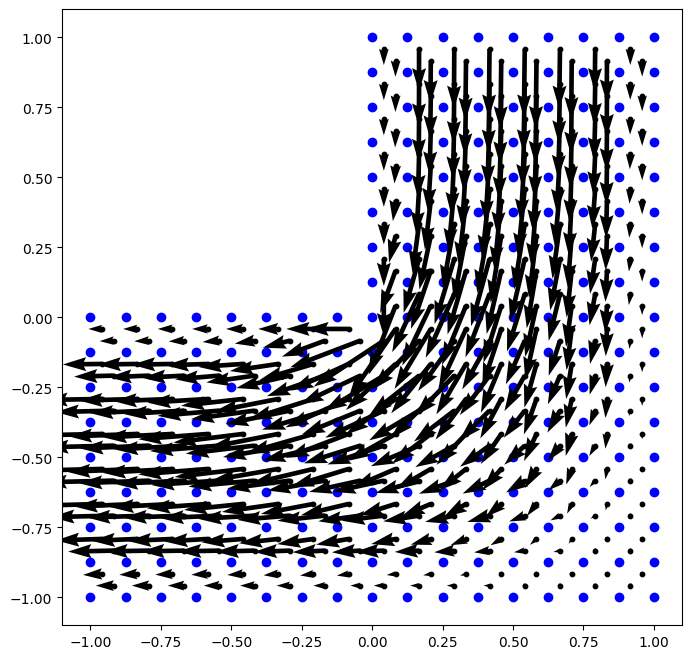

[0.05163277]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16312812e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14403829e-03
  1.80982618e-03  0.00000000e+00 -6.29861167e-04 -2.66736659e-04
  1.65028632e-03 -4.59146120e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08141408e-03  6.30232604e-03  0.00000000e+00  3.07196006e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48129242e-03 -2.60975389e-03
  0.00000000e+00 -8.41671456e-03  4.11787030e-03  6.97880704e-03
  6.87253650e-03  3.82432344e-03 -8.15729798e-03  7.63161180e-03
 -8.43881182e-03 -9.12669948e-04  7.39406645e-03 -9.10045155e-03
  2.89154109e-04  7.65969018e-03 -8.71859385e-03 -1.74726650e-04
  7.38531375e-03  3.77293407e-04 -8.85735902e-03  1.42011760e-03
 -8.81747624

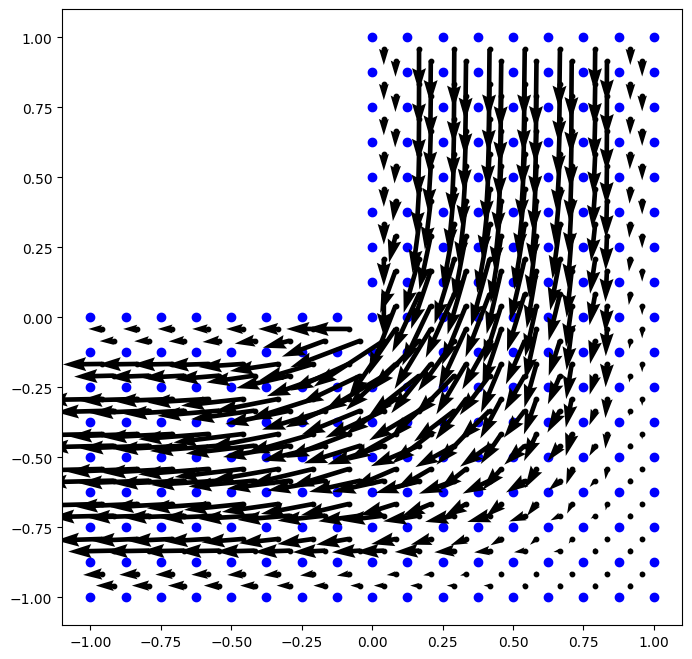

[0.0530292]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16224794e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14231935e-03
  1.80792697e-03  0.00000000e+00 -6.29914187e-04 -2.67942916e-04
  1.64899184e-03 -4.59063240e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08285761e-03  6.30098014e-03  0.00000000e+00  3.07250703e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47983817e-03 -2.61164567e-03
  0.00000000e+00 -8.41585619e-03  4.11669201e-03  6.97731043e-03
  6.87187811e-03  3.82298557e-03 -8.15774535e-03  7.63229509e-03
 -8.44012700e-03 -9.11724241e-04  7.39415094e-03 -9.10073068e-03
  2.88069137e-04  7.65918104e-03 -8.71989579e-03 -1.75301650e-04
  7.38423523e-03  3.75612973e-04 -8.85826954e-03  1.41958489e-03
 -8.83631898e

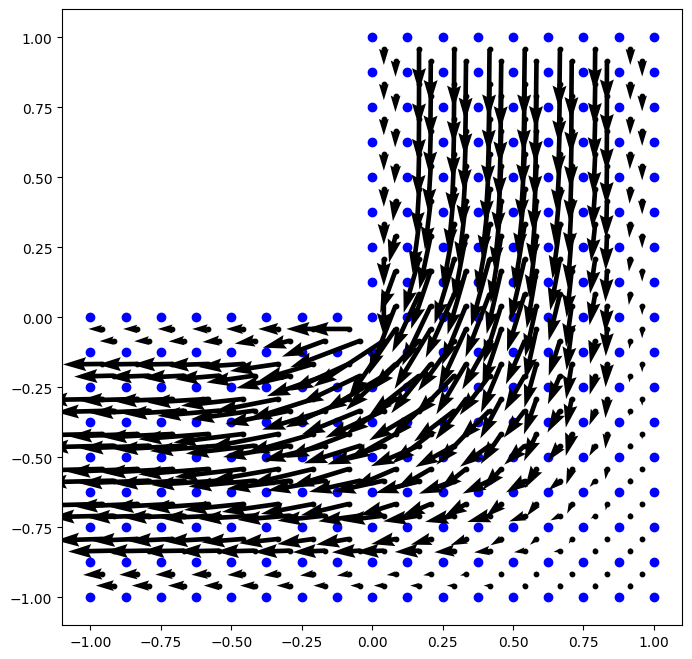

[0.04593208]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16308450e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14395315e-03
  1.80982938e-03  0.00000000e+00 -6.29857442e-04 -2.66824336e-04
  1.65031024e-03 -4.59140563e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08145639e-03  6.30220894e-03  0.00000000e+00  3.07199027e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48117603e-03 -2.60974278e-03
  0.00000000e+00 -8.41667112e-03  4.11777425e-03  6.97870718e-03
  6.87249441e-03  3.82424262e-03 -8.15732811e-03  7.63165255e-03
 -8.43889454e-03 -9.12631495e-04  7.39407180e-03 -9.10049618e-03
  2.89158529e-04  7.65965684e-03 -8.71869442e-03 -1.74769445e-04
  7.38524417e-03  3.77186101e-04 -8.85742904e-03  1.42007828e-03
 -8.81714665

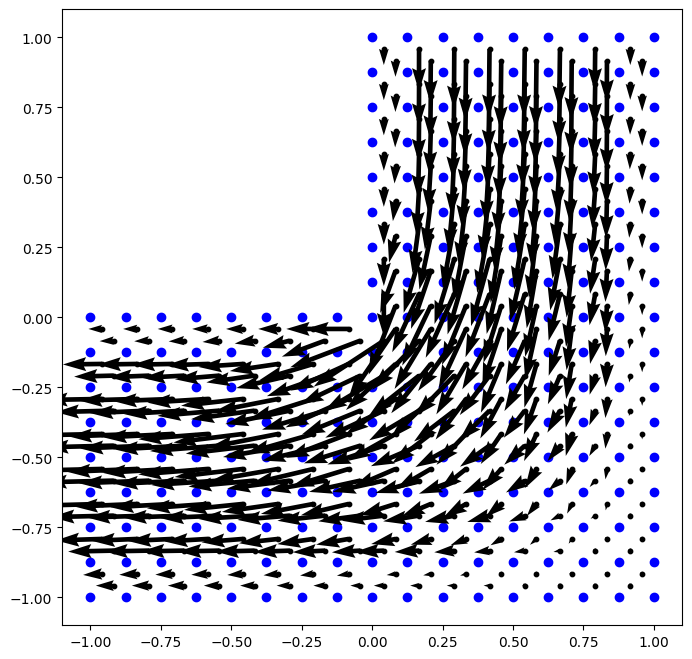

[0.04664457]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16231804e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14243213e-03
  1.80813732e-03  0.00000000e+00 -6.29913119e-04 -2.67889774e-04
  1.64914423e-03 -4.59068643e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08273082e-03  6.30101365e-03  0.00000000e+00  3.07246653e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47988723e-03 -2.61142233e-03
  0.00000000e+00 -8.41592927e-03  4.11672513e-03  6.97738013e-03
  6.87190772e-03  3.82304677e-03 -8.15772219e-03  7.63224725e-03
 -8.44006039e-03 -9.11809142e-04  7.39414158e-03 -9.10075075e-03
  2.88188900e-04  7.65920458e-03 -8.71983843e-03 -1.75277609e-04
  7.38428672e-03  3.75702249e-04 -8.85822996e-03  1.41959547e-03
 -8.83390880

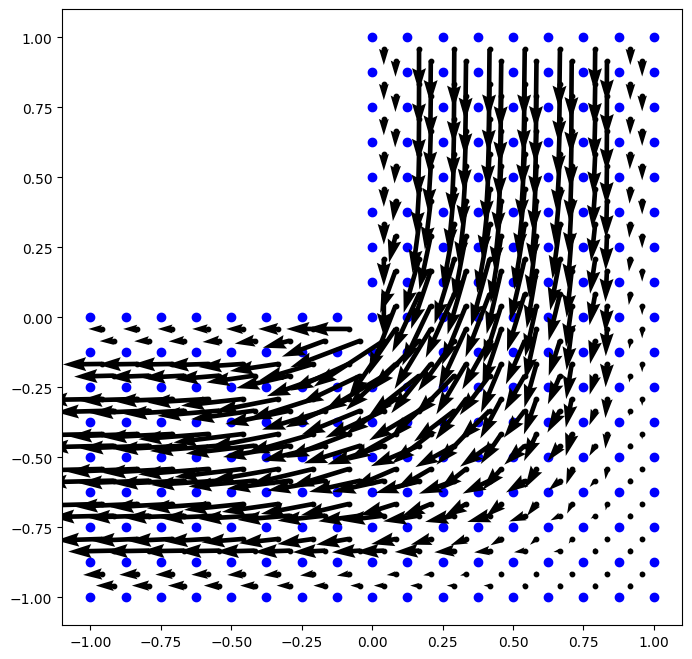

[0.04085069]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16304445e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14387517e-03
  1.80981660e-03  0.00000000e+00 -6.29854066e-04 -2.66899616e-04
  1.65031679e-03 -4.59135730e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08150001e-03  6.30211054e-03  0.00000000e+00  3.07201735e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48107724e-03 -2.60974977e-03
  0.00000000e+00 -8.41663151e-03  4.11769286e-03  6.97862014e-03
  6.87245786e-03  3.82417127e-03 -8.15735417e-03  7.63168880e-03
 -8.43896675e-03 -9.12594280e-04  7.39407690e-03 -9.10053161e-03
  2.89153821e-04  7.65962775e-03 -8.71877996e-03 -1.74806007e-04
  7.38518324e-03  3.77092102e-04 -8.85748861e-03  1.42004455e-03
 -8.81706010

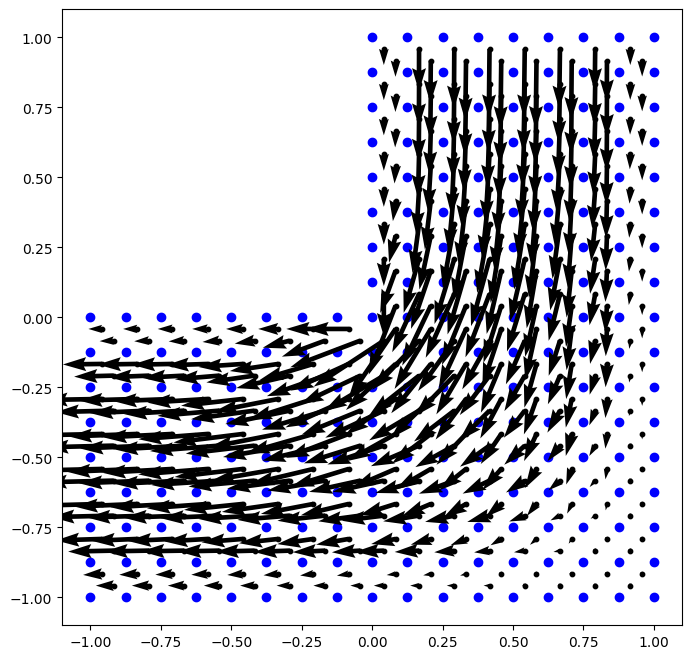

[0.04108039]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16237727e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14252941e-03
  1.80830997e-03  0.00000000e+00 -6.29911646e-04 -2.67840785e-04
  1.64926841e-03 -4.59073334e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08262521e-03  6.30104872e-03  0.00000000e+00  3.07243205e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47993511e-03 -2.61124033e-03
  0.00000000e+00 -8.41599086e-03  4.11675887e-03  6.97744388e-03
  6.87193470e-03  3.82310292e-03 -8.15770152e-03  7.63220608e-03
 -8.44000060e-03 -9.11879936e-04  7.39413369e-03 -9.10076398e-03
  2.88287545e-04  7.65922615e-03 -8.71978580e-03 -1.75255226e-04
  7.38433365e-03  3.75781780e-04 -8.85819349e-03  1.41960748e-03
 -8.83196008

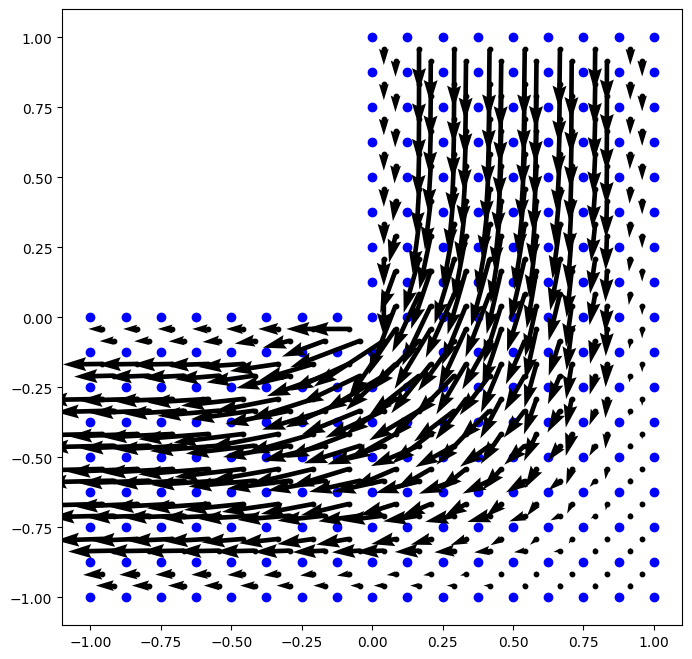

[0.03632218]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16300805e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14380427e-03
  1.80979343e-03  0.00000000e+00 -6.29851258e-04 -2.66964515e-04
  1.65031161e-03 -4.59131526e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08154316e-03  6.30202735e-03  0.00000000e+00  3.07204154e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48099292e-03 -2.60976862e-03
  0.00000000e+00 -8.41659569e-03  4.11762348e-03  6.97854413e-03
  6.87242598e-03  3.82410816e-03 -8.15737680e-03  7.63172093e-03
 -8.43902994e-03 -9.12559170e-04  7.39408161e-03 -9.10055993e-03
  2.89142959e-04  7.65960230e-03 -8.71885304e-03 -1.74837408e-04
  7.38512977e-03  3.77009684e-04 -8.85753952e-03  1.42001539e-03
 -8.81713658

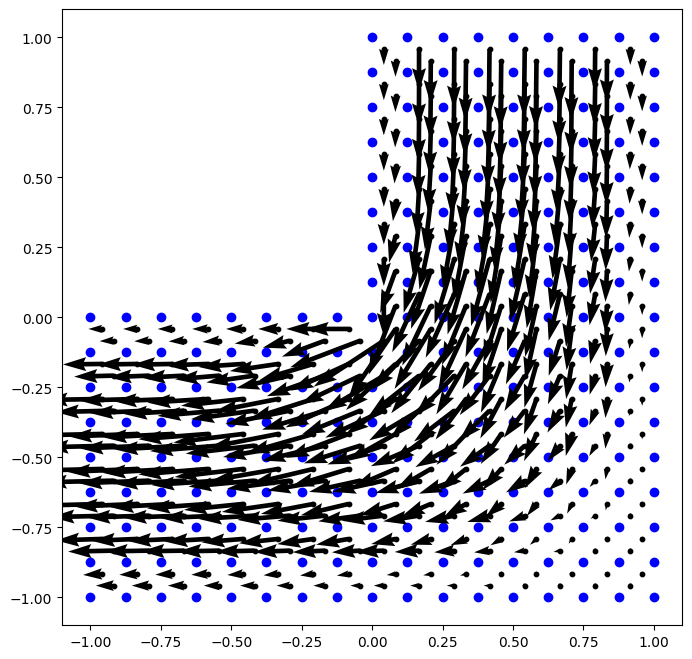

[0.03621782]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16242751e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14261365e-03
  1.80845257e-03  0.00000000e+00 -6.29909996e-04 -2.67795991e-04
  1.64937045e-03 -4.59077406e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08253668e-03  6.30108387e-03  0.00000000e+00  3.07240259e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.47998083e-03 -2.61109105e-03
  0.00000000e+00 -8.41604290e-03  4.11679212e-03  6.97750183e-03
  6.87195919e-03  3.82315418e-03 -8.15768308e-03  7.63217059e-03
 -8.43994706e-03 -9.11939272e-04  7.39412704e-03 -9.10077222e-03
  2.88369216e-04  7.65924580e-03 -8.71973787e-03 -1.75234596e-04
  7.38437620e-03  3.75852535e-04 -8.85816017e-03  1.41962018e-03
 -8.83037303

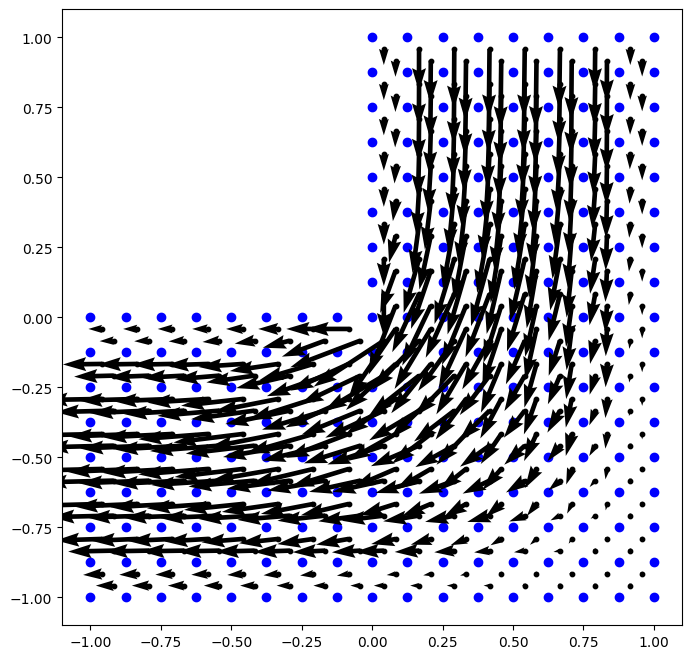

[0.0322876]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16297520e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14374017e-03
  1.80976393e-03  0.00000000e+00 -6.29849085e-04 -2.67020663e-04
  1.65029878e-03 -4.59127867e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08158467e-03  6.30195661e-03  0.00000000e+00  3.07206307e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48092060e-03 -2.60979483e-03
  0.00000000e+00 -8.41656350e-03  4.11756400e-03  6.97847761e-03
  6.87239808e-03  3.82405226e-03 -8.15739649e-03  7.63174933e-03
 -8.43908537e-03 -9.12526640e-04  7.39408585e-03 -9.10058278e-03
  2.89128162e-04  7.65957998e-03 -8.71891570e-03 -1.74864498e-04
  7.38508280e-03  3.76937363e-04 -8.85758321e-03  1.41999002e-03
 -8.81731847e

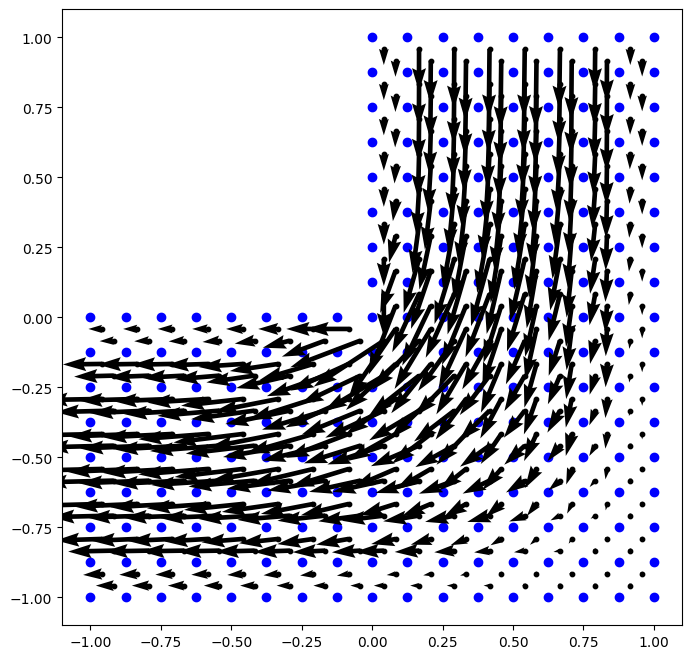

[0.03195871]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16247026e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14268684e-03
  1.80857108e-03  0.00000000e+00 -6.29908291e-04 -2.67755292e-04
  1.64945499e-03 -4.59080939e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08246201e-03  6.30111813e-03  0.00000000e+00  3.07237736e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48002379e-03 -2.61096782e-03
  0.00000000e+00 -8.41608695e-03  4.11682414e-03  6.97755427e-03
  6.87198137e-03  3.82320076e-03 -8.15766667e-03  7.63213997e-03
 -8.43989923e-03 -9.11989230e-04  7.39412147e-03 -9.10077685e-03
  2.88437207e-04  7.65926361e-03 -8.71969448e-03 -1.75215727e-04
  7.38441463e-03  3.75915411e-04 -8.85812993e-03  1.41963306e-03
 -8.82907119

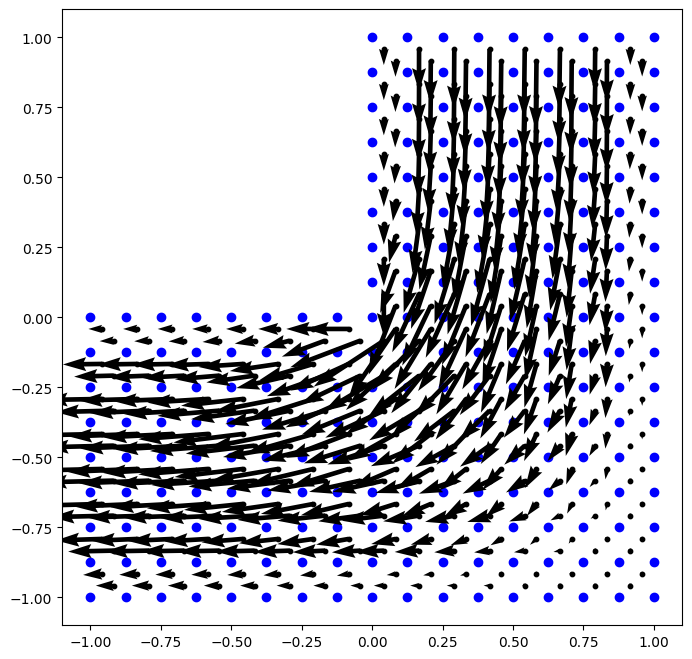

[0.02869431]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16294576e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14368245e-03
  1.80973102e-03  0.00000000e+00 -6.29847531e-04 -2.67069389e-04
  1.65028120e-03 -4.59124681e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08162386e-03  6.30189614e-03  0.00000000e+00  3.07208216e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48085831e-03 -2.60982518e-03
  0.00000000e+00 -8.41653475e-03  4.11751276e-03  6.97841931e-03
  6.87237357e-03  3.82400269e-03 -8.15741368e-03  7.63177438e-03
 -8.43913407e-03 -9.12496900e-04  7.39408960e-03 -9.10060138e-03
  2.89111068e-04  7.65956036e-03 -8.71896963e-03 -1.74887960e-04
  7.38504147e-03  3.76873853e-04 -8.85762084e-03  1.41996782e-03
 -8.81756468

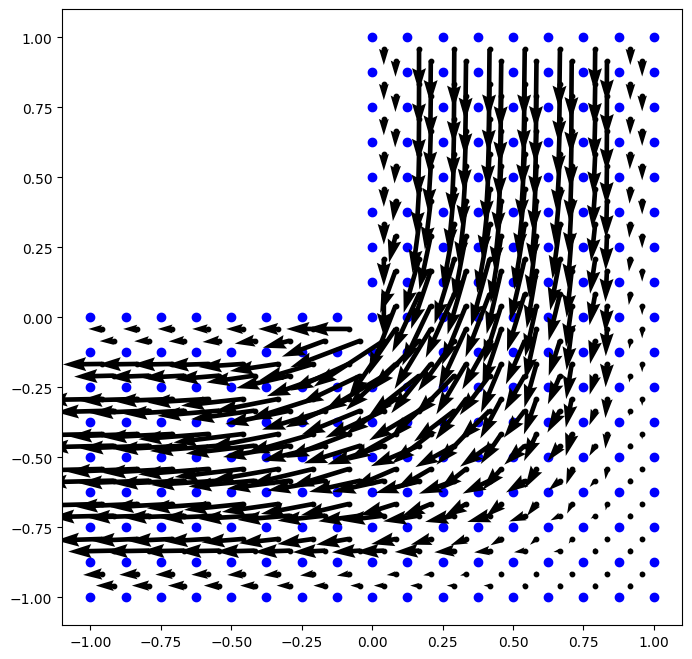

[0.02822113]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16250674e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14275061e-03
  1.80867018e-03  0.00000000e+00 -6.29906588e-04 -2.67718495e-04
  1.64952557e-03 -4.59084006e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08239869e-03  6.30115084e-03  0.00000000e+00  3.07235569e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48006370e-03 -2.61086544e-03
  0.00000000e+00 -8.41612433e-03  4.11685446e-03  6.97760154e-03
  6.87200142e-03  3.82324296e-03 -8.15765208e-03  7.63211351e-03
 -8.43985656e-03 -9.12031458e-04  7.39411681e-03 -9.10077890e-03
  2.88494137e-04  7.65927970e-03 -8.71965538e-03 -1.75198573e-04
  7.38444921e-03  3.75971235e-04 -8.85810261e-03  1.41964576e-03
 -8.82799571

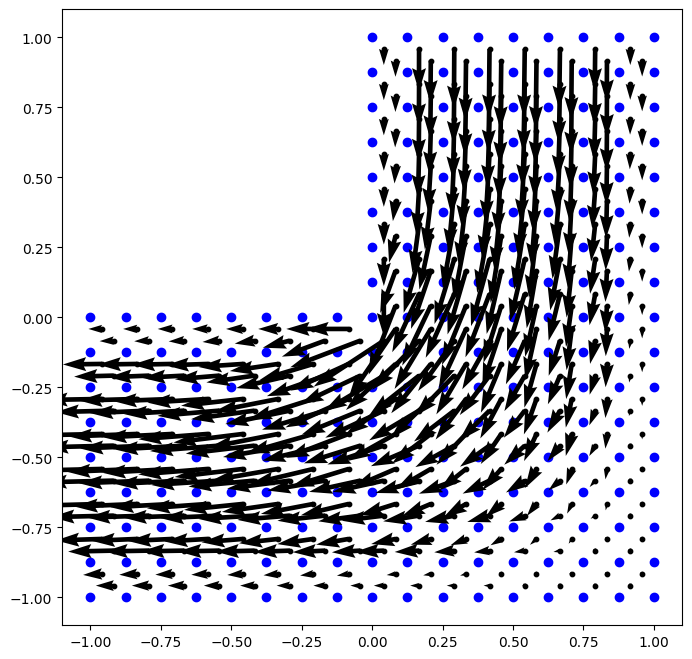

[0.02549524]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16291948e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14363067e-03
  1.80969674e-03  0.00000000e+00 -6.29846537e-04 -2.67111785e-04
  1.65026096e-03 -4.59121909e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08166033e-03  6.30184419e-03  0.00000000e+00  3.07209906e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48080444e-03 -2.60985740e-03
  0.00000000e+00 -8.41650919e-03  4.11746843e-03  6.97836815e-03
  6.87235198e-03  3.82395869e-03 -8.15742870e-03  7.63179643e-03
 -8.43917694e-03 -9.12469986e-04  7.39409286e-03 -9.10061667e-03
  2.89092859e-04  7.65954310e-03 -8.71901620e-03 -1.74908345e-04
  7.38500507e-03  3.76818042e-04 -8.85765337e-03  1.41994831e-03
 -8.81784620

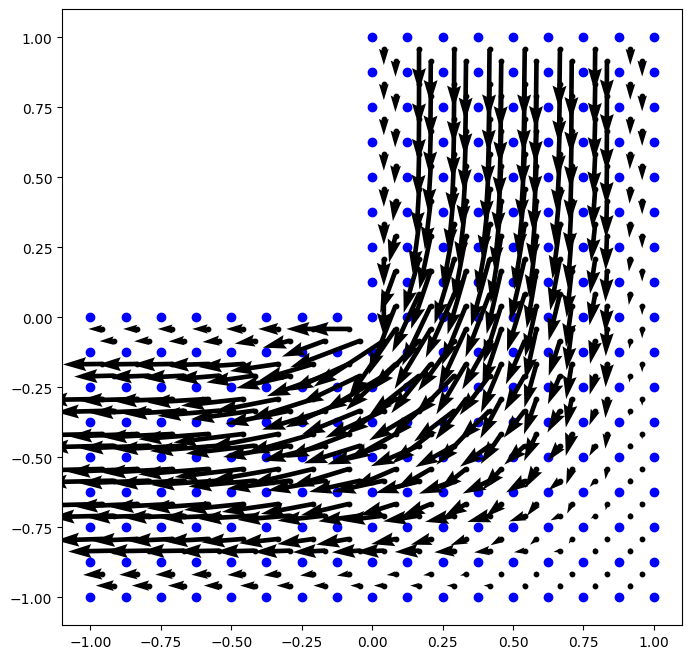

[0.02493606]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16253797e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14280630e-03
  1.80875354e-03  0.00000000e+00 -6.29904912e-04 -2.67685360e-04
  1.64958494e-03 -4.59086666e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08234471e-03  6.30118162e-03  0.00000000e+00  3.07233704e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48010044e-03 -2.61077985e-03
  0.00000000e+00 -8.41615611e-03  4.11688281e-03  6.97764400e-03
  6.87201950e-03  3.82328108e-03 -8.15763912e-03  7.63209064e-03
 -8.43981853e-03 -9.12067271e-04  7.39411293e-03 -9.10077912e-03
  2.88542078e-04  7.65929419e-03 -8.71962028e-03 -1.75183054e-04
  7.38448025e-03  3.76020759e-04 -8.85807805e-03  1.41965803e-03
 -8.82710110

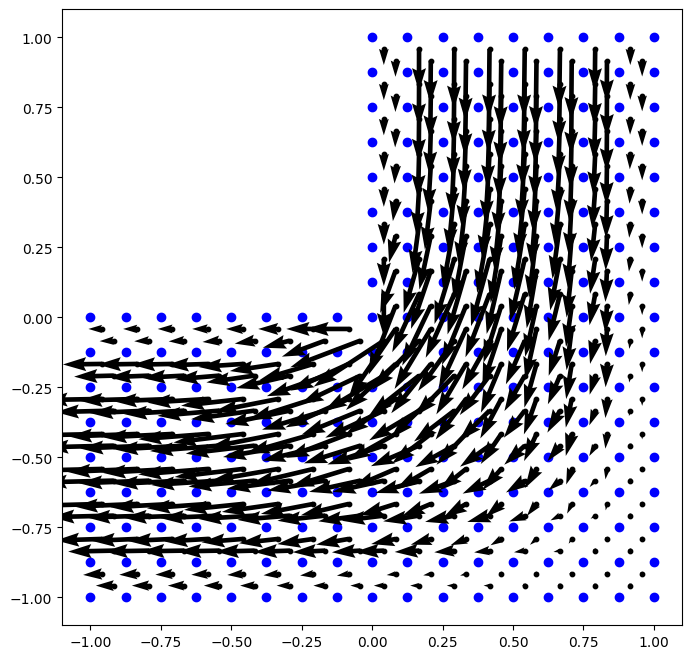

[0.02264821]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16289614e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14358432e-03
  1.80966251e-03  0.00000000e+00 -6.29846027e-04 -2.67148757e-04
  1.65023950e-03 -4.59119495e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08169391e-03  6.30179936e-03  0.00000000e+00  3.07211398e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48075771e-03 -2.60988994e-03
  0.00000000e+00 -8.41648657e-03  4.11742992e-03  6.97832320e-03
  6.87233291e-03  3.82391960e-03 -8.15744186e-03  7.63181579e-03
 -8.43921472e-03 -9.12445823e-04  7.39409567e-03 -9.10062937e-03
  2.89074374e-04  7.65952788e-03 -8.71905651e-03 -1.74926107e-04
  7.38497298e-03  3.76768965e-04 -8.85768156e-03  1.41993107e-03
 -8.81814282

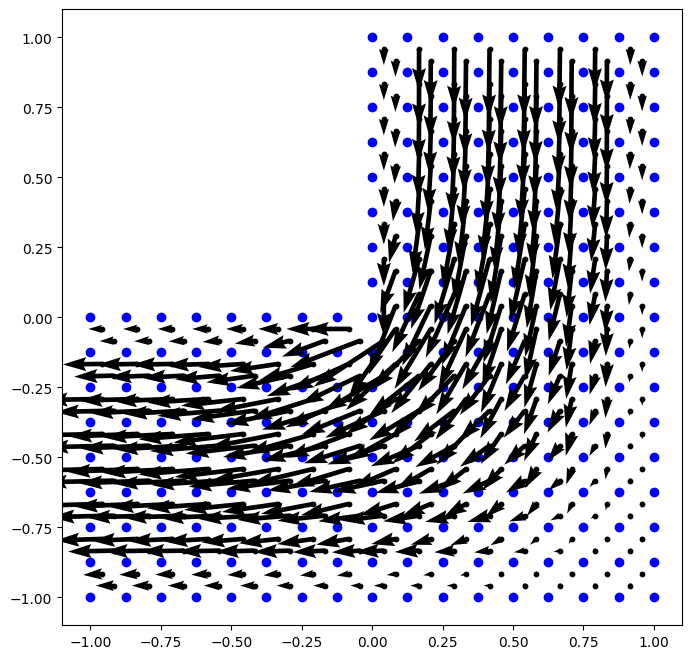

[0.02204493]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16256475e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14285504e-03
  1.80882407e-03  0.00000000e+00 -6.29903274e-04 -2.67655618e-04
  1.64963523e-03 -4.59088975e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08229848e-03  6.30121026e-03  0.00000000e+00  3.07232097e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48013401e-03 -2.61070787e-03
  0.00000000e+00 -8.41618316e-03  4.11690907e-03  6.97768206e-03
  6.87203578e-03  3.82331543e-03 -8.15762761e-03  7.63207086e-03
 -8.43978467e-03 -9.12097730e-04  7.39410972e-03 -9.10077809e-03
  2.88582682e-04  7.65930720e-03 -8.71958886e-03 -1.75169067e-04
  7.38450804e-03  3.76064666e-04 -8.85805603e-03  1.41966971e-03
 -8.82635206

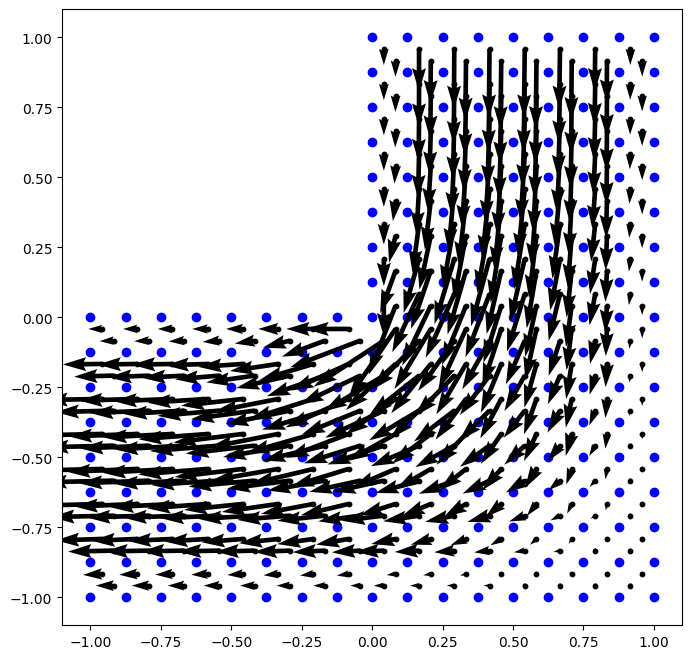

[0.02011541]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16287546e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14354295e-03
  1.80962926e-03  0.00000000e+00 -6.29845921e-04 -2.67181063e-04
  1.65021782e-03 -4.59117395e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08172460e-03  6.30176053e-03  0.00000000e+00  3.07212712e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48071704e-03 -2.60992176e-03
  0.00000000e+00 -8.41646661e-03  4.11739635e-03  6.97828366e-03
  6.87231605e-03  3.82388486e-03 -8.15745340e-03  7.63183277e-03
 -8.43924805e-03 -9.12424267e-04  7.39409805e-03 -9.10064003e-03
  2.89056189e-04  7.65951447e-03 -8.71909151e-03 -1.74941620e-04
  7.38494468e-03  3.76725784e-04 -8.85770605e-03  1.41991581e-03
 -8.81844080

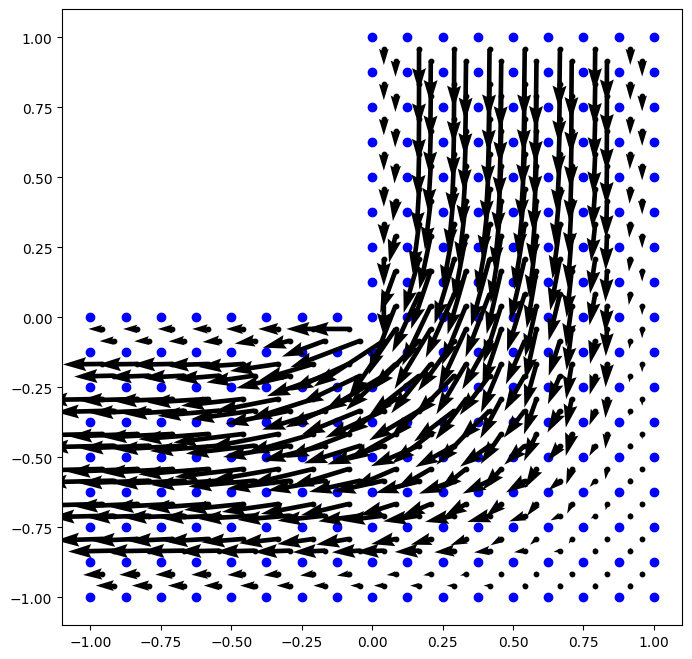

[0.0194977]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16258776e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14289776e-03
  1.80888406e-03  0.00000000e+00 -6.29901675e-04 -2.67628991e-04
  1.64967809e-03 -4.59090978e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08225874e-03  6.30123669e-03  0.00000000e+00  3.07230710e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48016452e-03 -2.61064699e-03
  0.00000000e+00 -8.41620623e-03  4.11693321e-03  6.97771610e-03
  6.87205043e-03  3.82334633e-03 -8.15761741e-03  7.63205373e-03
 -8.43975454e-03 -9.12123699e-04  7.39410707e-03 -9.10077620e-03
  2.88617261e-04  7.65931885e-03 -8.71956080e-03 -1.75156502e-04
  7.38453288e-03  3.76103573e-04 -8.85803634e-03  1.41968070e-03
 -8.82572098e

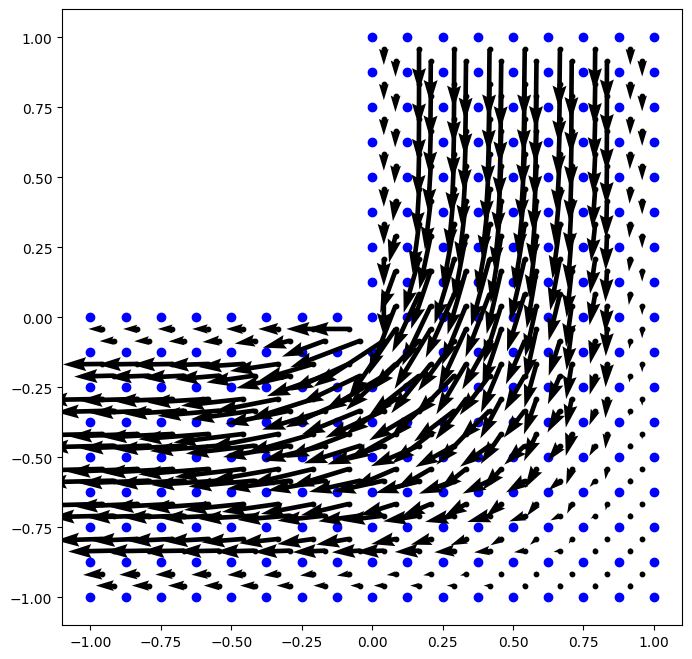

[0.01786292]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16285721e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14350606e-03
  1.80959761e-03  0.00000000e+00 -6.29846145e-04 -2.67209340e-04
  1.65019659e-03 -4.59115568e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08175246e-03  6.30172676e-03  0.00000000e+00  3.07213869e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48068156e-03 -2.60995219e-03
  0.00000000e+00 -8.41644908e-03  4.11736701e-03  6.97824885e-03
  6.87230110e-03  3.82385397e-03 -8.15746353e-03  7.63184764e-03
 -8.43927750e-03 -9.12405137e-04  7.39410005e-03 -9.10064907e-03
  2.89038689e-04  7.65950262e-03 -8.71912195e-03 -1.74955195e-04
  7.38491971e-03  3.76687771e-04 -8.85772739e-03  1.41990226e-03
 -8.81873100

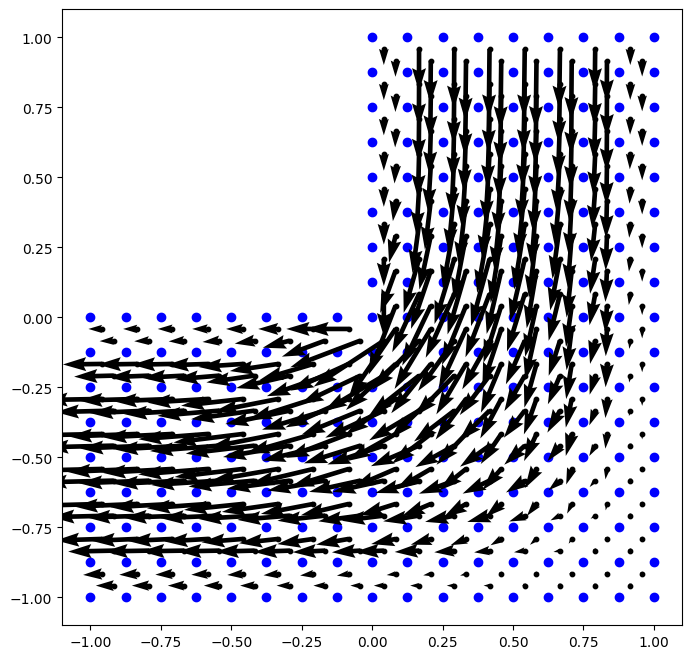

[0.01725139]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16260757e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14293526e-03
  1.80893535e-03  0.00000000e+00 -6.29900114e-04 -2.67605203e-04
  1.64971483e-03 -4.59092715e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08222443e-03  6.30126091e-03  0.00000000e+00  3.07229511e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48019212e-03 -2.61059522e-03
  0.00000000e+00 -8.41622591e-03  4.11695527e-03  6.97774648e-03
  6.87206361e-03  3.82337407e-03 -8.15760836e-03  7.63203891e-03
 -8.43972773e-03 -9.12145883e-04  7.39410492e-03 -9.10077377e-03
  2.88646862e-04  7.65932927e-03 -8.71953580e-03 -1.75145243e-04
  7.38455504e-03  3.76138034e-04 -8.85801877e-03  1.41969096e-03
 -8.82518622

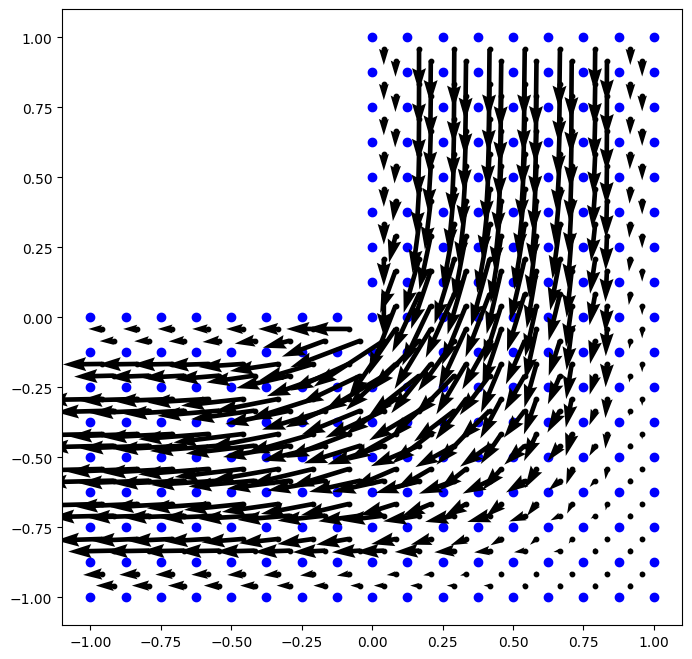

[0.01586036]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16284112e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14347322e-03
  1.80956790e-03  0.00000000e+00 -6.29846629e-04 -2.67234125e-04
  1.65017625e-03 -4.59113980e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08177763e-03  6.30169730e-03  0.00000000e+00  3.07214885e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48065053e-03 -2.60998081e-03
  0.00000000e+00 -8.41643371e-03  4.11734129e-03  6.97821818e-03
  6.87228783e-03  3.82382650e-03 -8.15747243e-03  7.63186064e-03
 -8.43930354e-03 -9.12388232e-04  7.39410170e-03 -9.10065681e-03
  2.89022115e-04  7.65949216e-03 -8.71914850e-03 -1.74967095e-04
  7.38489766e-03  3.76654291e-04 -8.85774600e-03  1.41989019e-03
 -8.81900762

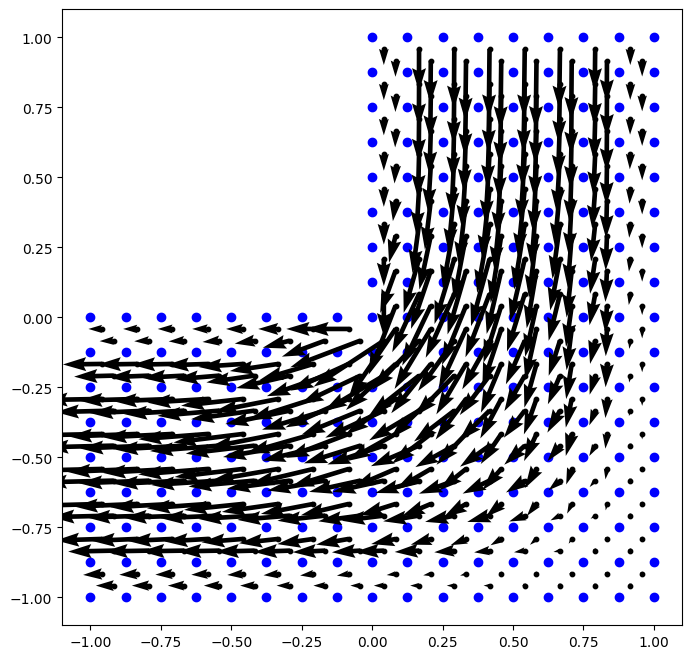

[0.0152689]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16262464e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14296822e-03
  1.80897941e-03  0.00000000e+00 -6.29898590e-04 -2.67583989e-04
  1.64974649e-03 -4.59094223e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08219473e-03  6.30128299e-03  0.00000000e+00  3.07228473e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48021700e-03 -2.61055099e-03
  0.00000000e+00 -8.41624273e-03  4.11697533e-03  6.97777357e-03
  6.87207544e-03  3.82339896e-03 -8.15760035e-03  7.63202607e-03
 -8.43970389e-03 -9.12164863e-04  7.39410317e-03 -9.10077101e-03
  2.88672328e-04  7.65933858e-03 -8.71951355e-03 -1.75135176e-04
  7.38457479e-03  3.76168545e-04 -8.85800313e-03  1.41970045e-03
 -8.82473063e

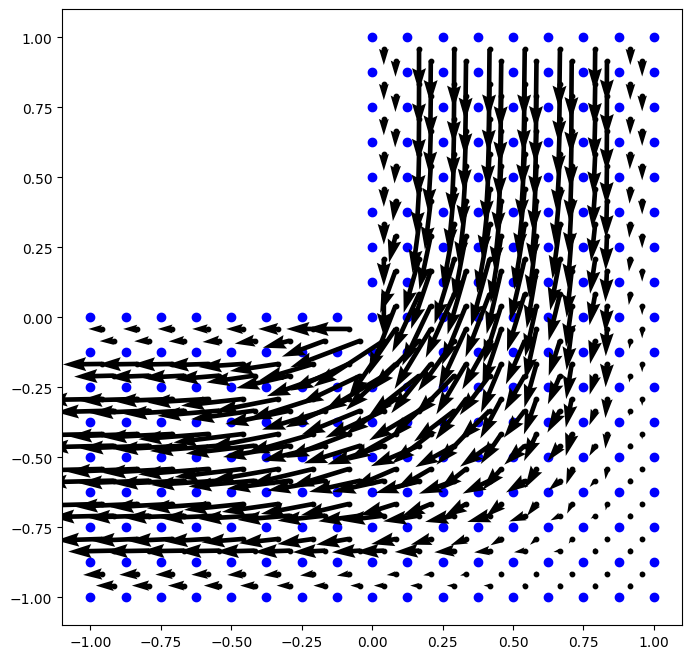

[0.01408053]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16282699e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14344402e-03
  1.80954033e-03  0.00000000e+00 -6.29847315e-04 -2.67255876e-04
  1.65015706e-03 -4.59112599e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08180028e-03  6.30167153e-03  0.00000000e+00  3.07215776e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48062335e-03 -2.61000742e-03
  0.00000000e+00 -8.41642028e-03  4.11731871e-03  6.97819115e-03
  6.87227603e-03  3.82380206e-03 -8.15748026e-03  7.63187199e-03
 -8.43932658e-03 -9.12373349e-04  7.39410305e-03 -9.10066350e-03
  2.89006607e-04  7.65948291e-03 -8.71917168e-03 -1.74977540e-04
  7.38487819e-03  3.76624790e-04 -8.85776228e-03  1.41987944e-03
 -8.81926723

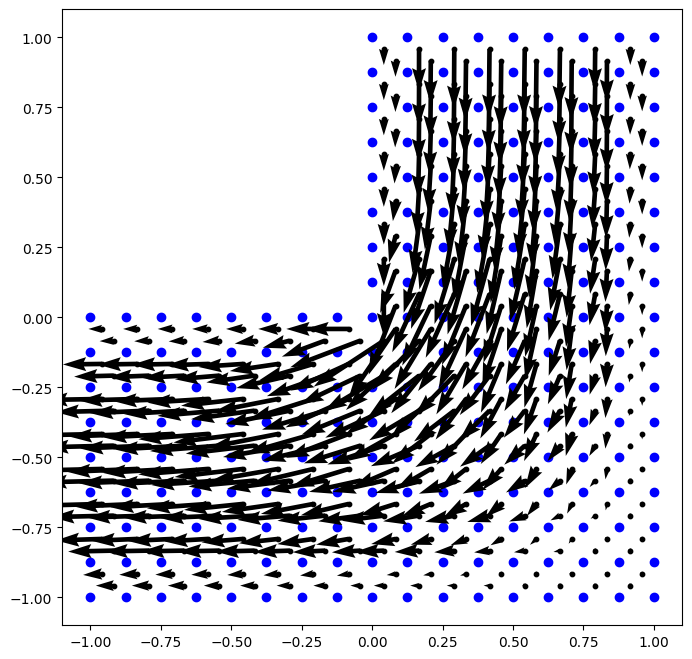

[0.01351808]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16263936e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14299722e-03
  1.80901741e-03  0.00000000e+00 -6.29897104e-04 -2.67565098e-04
  1.64977389e-03 -4.59095530e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08216894e-03  6.30130303e-03  0.00000000e+00  3.07227575e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48023936e-03 -2.61051302e-03
  0.00000000e+00 -8.41625711e-03  4.11699349e-03  6.97779768e-03
  6.87208605e-03  3.82342125e-03 -8.15759325e-03  7.63201495e-03
 -8.43968269e-03 -9.12181124e-04  7.39410177e-03 -9.10076808e-03
  2.88694334e-04  7.65934687e-03 -8.71949378e-03 -1.75126190e-04
  7.38459236e-03  3.76195552e-04 -8.85798921e-03  1.41970919e-03
 -8.82434061

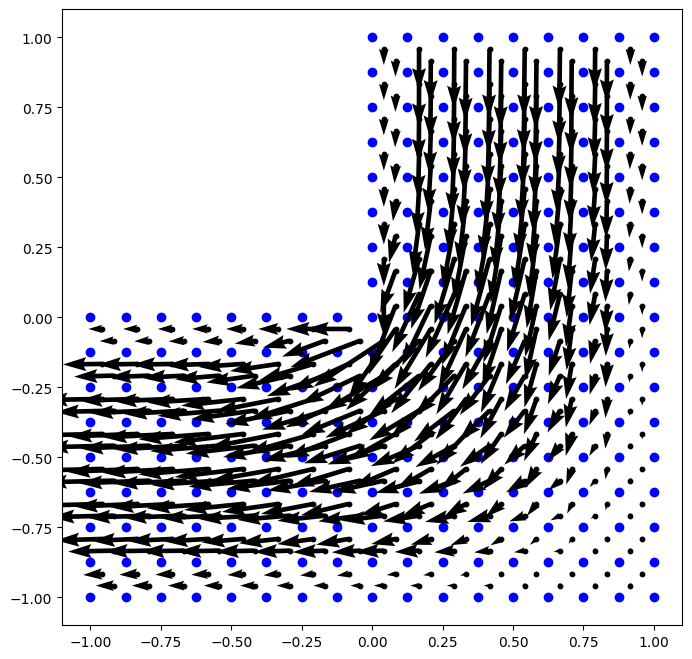

[0.01249905]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16281458e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14341808e-03
  1.80951495e-03  0.00000000e+00 -6.29848151e-04 -2.67274986e-04
  1.65013918e-03 -4.59111398e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08182060e-03  6.30164893e-03  0.00000000e+00  3.07216556e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48059950e-03 -2.61003193e-03
  0.00000000e+00 -8.41640857e-03  4.11729884e-03  6.97816731e-03
  6.87226553e-03  3.82378031e-03 -8.15748715e-03  7.63188189e-03
 -8.43934698e-03 -9.12360286e-04  7.39410414e-03 -9.10066932e-03
  2.88992228e-04  7.65947474e-03 -8.71919195e-03 -1.74986719e-04
  7.38486099e-03  3.76598787e-04 -8.85777653e-03  1.41986985e-03
 -8.81950805

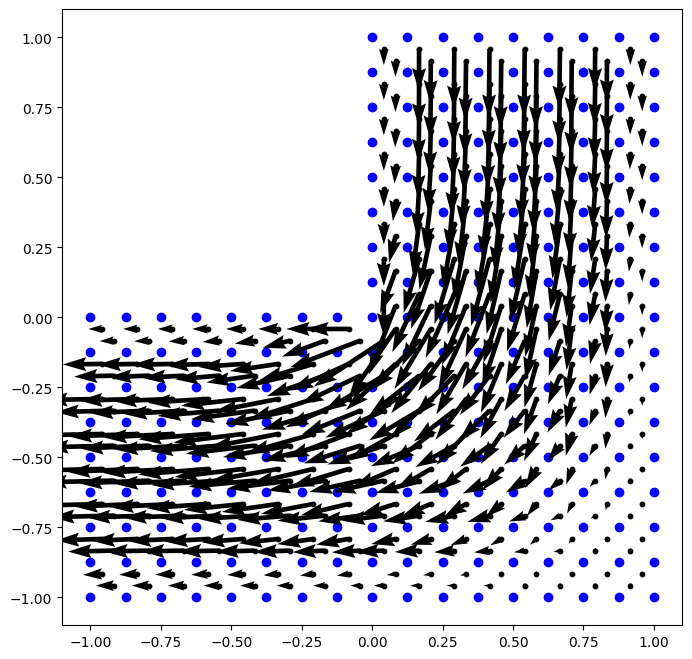

[0.01197098]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16265208e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14302275e-03
  1.80905031e-03  0.00000000e+00 -6.29895656e-04 -2.67548296e-04
  1.64979770e-03 -4.59096664e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08214649e-03  6.30132116e-03  0.00000000e+00  3.07226797e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48025940e-03 -2.61048029e-03
  0.00000000e+00 -8.41626941e-03  4.11700988e-03  6.97781912e-03
  6.87209558e-03  3.82344119e-03 -8.15758697e-03  7.63200533e-03
 -8.43966384e-03 -9.12195068e-04  7.39410067e-03 -9.10076510e-03
  2.88713431e-04  7.65935426e-03 -8.71947623e-03 -1.75118182e-04
  7.38460799e-03  3.76219451e-04 -8.85797685e-03  1.41971721e-03
 -8.82400524

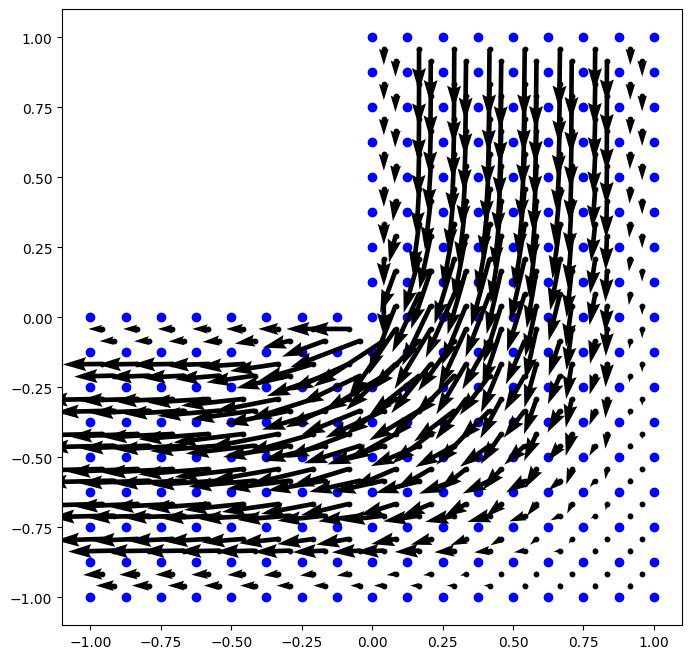

[0.01109416]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16280372e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14339506e-03
  1.80949174e-03  0.00000000e+00 -6.29849095e-04 -2.67291790e-04
  1.65012266e-03 -4.59110356e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08183879e-03  6.30162908e-03  0.00000000e+00  3.07217240e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48057854e-03 -2.61005434e-03
  0.00000000e+00 -8.41639838e-03  4.11728133e-03  6.97814627e-03
  6.87225619e-03  3.82376095e-03 -8.15749322e-03  7.63189052e-03
 -8.43936507e-03 -9.12348851e-04  7.39410500e-03 -9.10067444e-03
  2.88978993e-04  7.65946752e-03 -8.71920971e-03 -1.74994794e-04
  7.38484579e-03  3.76575857e-04 -8.85778901e-03  1.41986128e-03
 -8.81972948

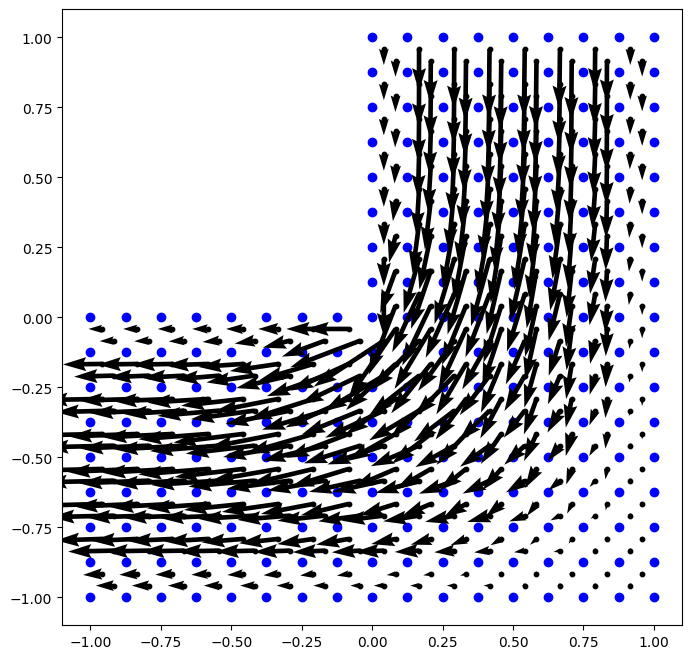

[0.01060323]
[ 0.00000000e+00  1.67168171e-01  0.00000000e+00  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -1.16266306e-03  8.35840856e-02  1.67168171e-01  1.67168171e-01
  1.67168171e-01  1.67168171e-01  0.00000000e+00  2.14304525e-03
  1.80907889e-03  0.00000000e+00 -6.29894248e-04 -2.67533368e-04
  1.64981847e-03 -4.59097646e-03  2.61200267e-02  1.67168171e-01
  1.67168171e-01  1.67168171e-01  1.67168171e-01  0.00000000e+00
 -3.08212690e-03  6.30133751e-03  0.00000000e+00  3.07226122e-03
  1.41048144e-01  1.67168171e-01  1.67168171e-01  1.67168171e-01
  1.67168171e-01  0.00000000e+00  6.48027733e-03 -2.61045198e-03
  0.00000000e+00 -8.41627993e-03  4.11702464e-03  6.97783817e-03
  6.87210412e-03  3.82345902e-03 -8.15758140e-03  7.63199699e-03
 -8.43964707e-03 -9.12207035e-04  7.39409981e-03 -9.10076213e-03
  2.88730064e-04  7.65936084e-03 -8.71946066e-03 -1.75111054e-04
  7.38462188e-03  3.76240596e-04 -8.85796588e-03  1.41972452e-03
 -8.82371573

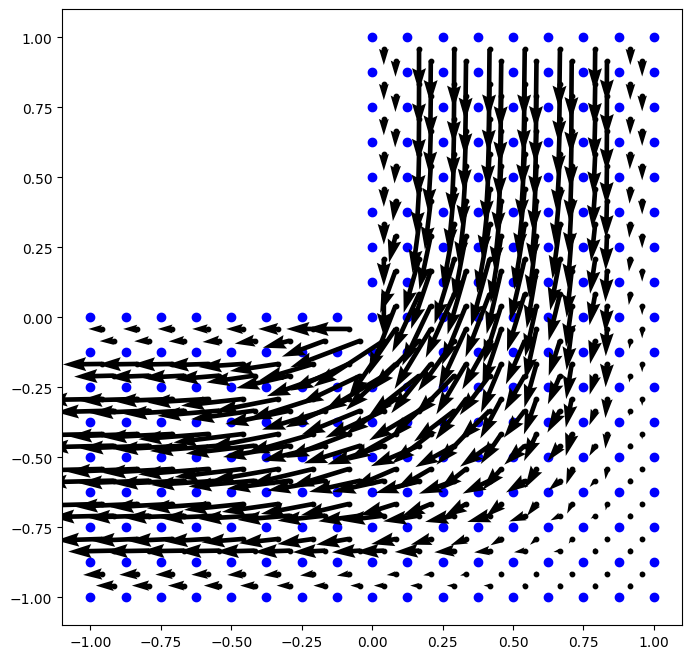

[0.0098464]


In [ ]:
omega = np.array([omega_init  for i in range(len(xy))]).reshape(-1,1)
#omega = np.array([omega_init if xy[i][0]!=0 else omega_ab(xy[i][1]/100)  for i in range(len(xy))]).reshape(-1,1)

iter_nums = 100
for iter_num in range(iter_nums):
  D_e_list = []
  M_e_list = []
  #F_e_list = []
  for pos in range(len(node_label)):
    ## d matrix of element pos
    #print(pos)
    area_t, b1,b2,b3,c1,c2,c3 = compfunc(xy,node_label,pos)
    D_e_list.append(D_e(area_t, b1,b2,b3,c1,c2,c3))

    ## m matrix of element pos
    M_e_list.append(M_e(area_t))

    ## f vector of element pos
    #F_e_list.append(np.array([0,0,0]))

  ## construct full matrix
  D_mat = np.zeros((len(xy),len(xy))); F_vec = np.zeros((len(xy),1)); M_mat = np.zeros((len(xy),len(xy)))
  for i in range(len(node_label)):
    for ith ,jth in itertools.product(np.arange(3), np.arange(3)):
      D_mat[node_label[i][ith]-1][node_label[i][jth]-1] += D_e_list[i][ith][jth]
      M_mat[node_label[i][ith]-1][node_label[i][jth]-1] += M_e_list[i][ith][jth]
    # note that we ignore F for this case
  '''
  print('print D matrix')
  plt.matshow(D_mat)
  plt.colorbar()
  plt.show()
  print('F vector')
  print(F_vec)
  '''
  ## add vorticity related
  MOmega = np.dot(M_mat,omega)
  F_vec += MOmega
  ## take into account the normal conditions
  for i in range(len(xy)):
    if xy[i][1] == 1.0:
      F_vec[i] = psi_in(xy[i][0])
      D_mat[i,:] = 0
      D_mat[i,i] = 1
    elif i+1 in bound_up_label:
      F_vec[i] = psi_b_up
      D_mat[i,:] = 0
      D_mat[i,i] = 1
    elif i+1 in bound_down_label:
      F_vec[i] = psi_b_down
      D_mat[i,:] = 0
      D_mat[i,i] = 1
    else:
      pass

  #print(F_vec.reshape(-1,))

  for i in range(len(xy)):
    if xy[i][1] == 1.0:
      temp_f = deepcopy(D_mat[:,i])
      temp_f[i] = 0
      F_prime = -psi_in(xy[i][0])*temp_f
      D_mat[:,i] = 0
      D_mat[i,i] = 1
    elif i+1 in bound_up_label:
      temp_f = deepcopy(D_mat[:,i])
      temp_f[i] = 0
      F_prime = -psi_b_up*temp_f
      D_mat[:,i] = 0
      D_mat[i,i] = 1
    elif i+1 in bound_down_label:
      temp_f = deepcopy(D_mat[:,i])
      temp_f[i] = 0
      F_prime = -psi_b_down*temp_f
      D_mat[:,i] = 0
      D_mat[i,i] = 1
    else:
      pass

    F_vec = F_vec + F_prime.reshape(-1,1)
    F_prime = np.zeros(F_vec.shape)



  ## calculation of psi
  psi = np.dot(np.linalg.pinv(D_mat),F_vec)
  print('--- {}th iteration, calculated error:{} ---'.format(iter_num,np.mean((np.dot(D_mat,psi)-F_vec)**2)))
  ## calculation of flow
  Flow_list = []
  for pos in range(len(node_label)):
    area_t, b1,b2,b3,c1,c2,c3 = compfunc(xy,node_label,pos)
    u = 1/2/area_t * (c1* psi[node_label[pos][0]-1]+ c2*psi[node_label[pos][1]-1] + c3*psi[node_label[pos][2]-1] )
    v = -1/2/area_t * (b1* psi[node_label[pos][0]-1]+ b2*psi[node_label[pos][1]-1] + b3*psi[node_label[pos][2]-1] )
    Flow_list.append([u,v])
  centr_list = []
  for pos in range(len(node_label)):
    centr_list.append(centroid(xy,node_label,pos))


  if iter_num%1==0:
    print('--- {}th iteration ---'.format(iter_num))
    plt.figure(figsize=(8,8))
    for i in range(len(xy)):
      plt.scatter(xy[i][0],xy[i][1],color='blue')
    for i in range(len(node_label)):
      plt.scatter(centr_list[i][0],centr_list[i][1],color='black',s=10)
      #plt.quiver(centr_list[i][0], centr_list[i][1], Flow_list[i][0], Flow_list[i][1], width=0.003, headwidth=1,headlength=1, color='black',angles='xy', scale_units='xy', scale=1/3)
      plt.quiver(centr_list[i][0], centr_list[i][1], Flow_list[i][0], Flow_list[i][1],angles='xy', scale_units='xy', scale=0.01*p_alpha)
    plt.show()
  else:
    pass

  # omega calculation
  ## kinematic viscosity
  nu_xs = nu0 + 1/2*dt*np.array([t[0]**2 for t in Flow_list]).reshape(-1,1)
  nu_ys = nu0 + 1/2*dt*np.array([t[1]**2 for t in Flow_list]).reshape(-1,1)

  Dnu_e_list = []
  M_e_list = []
  tildeM_e_list = []
  A_e_list = []
  #F_e_list = []
  for pos in range(len(node_label)):
    ## d matrix of element pos
    #print(pos)
    area_t, b1,b2,b3,c1,c2,c3 = compfunc(xy,node_label,pos)
    Dnu_e_list.append(Dnu_e(area_t, b1,b2,b3,c1,c2,c3,nu_xs[pos],nu_ys[pos]))

    ## m matrix of element pos
    M_e_list.append(M_e(area_t))
    tildeM_e_list.append(tildeM_e(area_t))

    ## a matrix of element pos
    t_p_list = [psi[t-1][0]  for t in node_label[pos]]
    A_e_list.append(A_e(t_p_list))


  ## construct full matrix
  Dnu_mat = np.zeros((len(xy),len(xy))); F_vec = np.zeros((len(xy),1))
  M_mat = np.zeros((len(xy),len(xy))); tildeM_mat = np.zeros((len(xy),len(xy)))
  A_mat = np.zeros((len(xy),len(xy)))
  for i in range(len(node_label)):
    for ith ,jth in itertools.product(np.arange(3), np.arange(3)):
      Dnu_mat[node_label[i][ith]-1][node_label[i][jth]-1] += Dnu_e_list[i][ith][jth]
      M_mat[node_label[i][ith]-1][node_label[i][jth]-1] += M_e_list[i][ith][jth]
      tildeM_mat[node_label[i][ith]-1][node_label[i][jth]-1] += tildeM_e_list[i][ith][jth]
      A_mat[node_label[i][ith]-1][node_label[i][jth]-1] += A_e_list[i][ith][jth]

  RHS_vec = np.dot(M_mat, omega)/dt - np.dot(A_mat, omega) - np.dot(Dnu_mat,omega) + F_vec
  LHS_mat = tildeM_mat/dt

  ## take into account the normal conditions
  for i in range(len(xy)):
    if xy[i][1] == 1.0:
      RHS_vec[i] = omega_in(xy[i][0])
      LHS_mat[i,i] = 1
    elif i+1 in bound_label_corner:
      RHS_vec[i] = omega_corner
      LHS_mat[i,i] = 1
    elif i+1 in omega_n_dict.keys():
      [t_pos,t_length] = omega_n_dict[i+1]
      RHS_vec[i] = -3/(t_length**2)*(psi[t_pos-1]-psi[i])-1/2*omega[t_pos-1]
      LHS_mat[i,i] = 1
    else:
      pass

  omega_new = np.dot(np.linalg.inv(LHS_mat),RHS_vec)
  #print(omega)
  conv_cond = max([ abs((o_new-o_pre)/(o_pre+1e-10)) for o_pre, o_new in zip(omega,omega_new)])
  omega = omega_new
  #print(omega_new)
  print(conv_cond)
  if conv_cond < epsilon:
    break
  else:
    pass


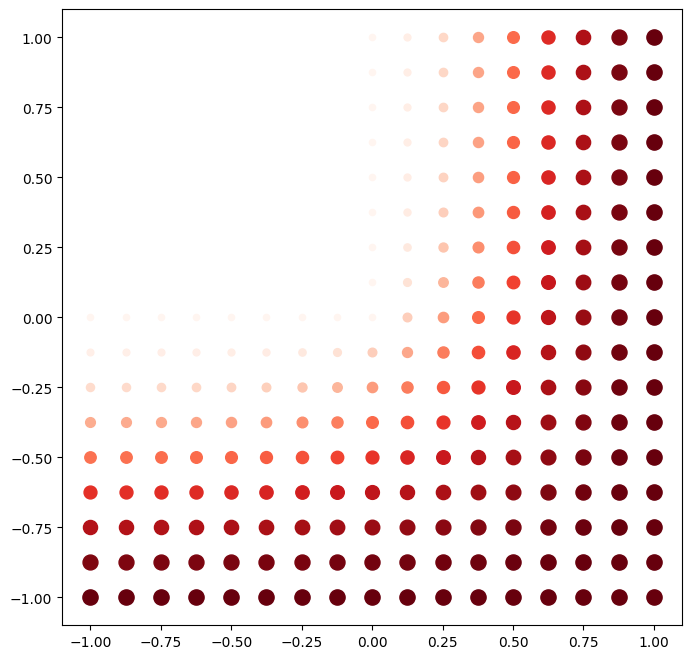

In [ ]:
cm = plt.get_cmap("Reds")
max_psi = max(psi)
min_psi = min(psi)
plt.figure(figsize=(8,8))
for i in range(len(xy)):
  c_ind = (psi[i]-min_psi)/(max_psi-min_psi)
  plt.scatter(xy[i][0],xy[i][1],s=100*c_ind+20,color = cm(c_ind))
plt.show()

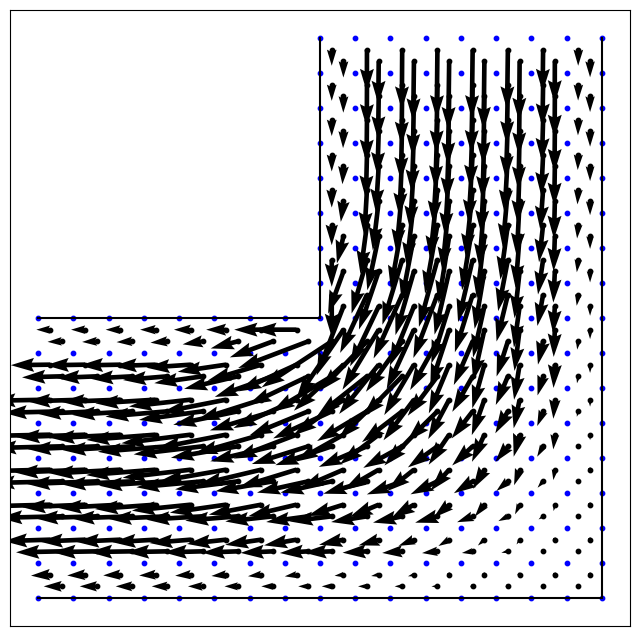

In [ ]:
plt.figure(figsize=(8,8))
for i in range(len(xy)):
  plt.scatter(xy[i][0],xy[i][1],color='blue',s=10)
for i in range(len(node_label)):
  plt.scatter(centr_list[i][0],centr_list[i][1],color='black',s=10)
  #plt.quiver(centr_list[i][0], centr_list[i][1], Flow_list[i][0], Flow_list[i][1], width=0.003, headwidth=1,headlength=1, color='black',angles='xy', scale_units='xy', scale=1/3)
  plt.quiver(centr_list[i][0], centr_list[i][1], Flow_list[i][0], Flow_list[i][1],angles='xy', scale_units='xy', scale=0.01*p_alpha)
plt.tick_params(bottom=False, left=False, right=False, top=False,labelbottom=False, labelleft=False, labelright=False, labeltop=False)
### boundary up (red)
for temp_e in boundary_up:
  plt.plot([p_mat[0,int(temp_e[0]-1)],p_mat[0,int(temp_e[1]-1)]],[p_mat[1,int(temp_e[0]-1)],p_mat[1,int(temp_e[1]-1)]],color='black')
### boundary down (yellow)
for temp_e in boundary_down:
  plt.plot([p_mat[0,int(temp_e[0]-1)],p_mat[0,int(temp_e[1]-1)]],[p_mat[1,int(temp_e[0]-1)],p_mat[1,int(temp_e[1]-1)]],color='black')
plt.savefig('classical_vic_flow.pdf', bbox_inches="tight")
plt.show()

## 量子アニーリングによる計算

In [ ]:
area_list = []
for pos in range(len(node_label)):
  area_t, _,_,_,_,_,_ = compfunc(xy,node_label,pos)
  area_list.append(area_t)
print(area_list)

[0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125, 0.0078125

In [ ]:
in_bound_element = []
for t_nl,t in enumerate(node_label):
  if sum([ 1 for t_e in t if t_e in in_bound_label])>=2:
    #print(t_nl)
    in_bound_element.append(t_nl)
  else:
    pass

out_bound_element = []
for t_nl,t in enumerate(node_label):
  if sum([ 1 for t_e in t if t_e in out_bound_label])>=2:
    #print(t_nl)
    out_bound_element.append(t_nl)
  else:
    pass

bound_up_element = []
for t_nl,t in enumerate(node_label):
  if sum([ 1 for t_e in t if t_e in bound_up_label])>=2:
    #print(t_nl)
    bound_up_element.append(t_nl)
  else:
    pass

bound_down_element = []
for t_nl,t in enumerate(node_label):
  if sum([ 1 for t_e in t if t_e in bound_down_label])>=2:
    #print(t_nl)
    bound_down_element.append(t_nl)
  else:
    pass

In [ ]:
## get adjacent element
adj_node_list = []
for t_nl, t in enumerate(node_label):
  t_adj = [ t_id+t_nl+1 for t_id, t_node in enumerate(node_label[t_nl+1:]) if sum([ 1 if t_e in t_node else 0 for t_e in t])>=2]
  #print(t_adj)
  adj_node_list.append(t_adj)

In [ ]:
#adj_node_list

In [ ]:
## bit string
num_element = len(node_label)
num_bit_per = 9
v_limited = 200

## coef for porous resistivity
coef_pr = 10**4
coef_pr_pres = [0 for _ in range(num_element)]

## coef for energy loss, eqn constraint, gradient energy, heviside function, boundary constraint, domain constraints
alpha_el = 5
alpha_eqn_c = 1
alpha_ge = 1.0*10
alpha_hev = 10.0
alpha_bc = 1.0
alpha_dc = 1.0

## qubit
q = gen_symbols(BinaryPoly,num_element,num_bit_per+1)

## objective function
obj_func = BinaryPoly()

### energy loss
for t_id in range(num_element):
  coef_pr_e = (1-q[t_id][-1])*coef_pr
  t_uvec = Flow_list[t_id][0]
  t_vvec = Flow_list[t_id][1]
  obj_func += alpha_el*(coef_pr_e*(t_uvec*t_uvec+t_vvec*t_vvec) )


### eqn constraint
# for t_id in range(num_element):
#   coef_pr_e = (1-q[t_id][-1])*coef_pr
#   coef_pr_pre_e = coef_pr_pres[t_id]
#   t_uvec = Flow_list[t_id][0]
#   t_vvec = Flow_list[t_id][1]
#   obj_func += alpha_eqn_c*(((coef_pr_e-coef_pr_pre_e)*t_uvec )**2 + ((coef_pr_e-coef_pr_pre_e)*t_vvec )**2)


### gradient energy
for t_id,t_q in enumerate(q):
  for tt_id in adj_node_list[t_id]:
    phi_i = (sum_poly(t_q[:-1])/num_bit_per*2)-1
    phi_j = (sum_poly(q[tt_id][:-1])/num_bit_per*2)-1
    obj_func += alpha_ge/2*(phi_i-phi_j)**2

### boundary constraint
for t_id, t_q in enumerate(q):
  if t_id in in_bound_element+out_bound_element:
    obj_func += alpha_bc*((sum_poly(t_q[:-1])/num_bit_per*2)-1 -1)**2
  else:
    pass

### heviside function
for t_id, t_q in enumerate(q):
  obj_func += alpha_hev*(sum_poly(t_q[:-1])/num_bit_per - t_q[-1])**2

### domaint constraints
obj_func += alpha_dc*(sum_poly([t[-1] for t in q]) - v_limited)**2




client = FixstarsClient()
client.parameters.timeout = 10000   # タイムアウト X m秒
client.token = "508Y0K8y4qs1hGijjBurkhThu0uhiwiX"  # ローカル環境で使用する場合は、Amplify AEのアクセストークンを入力してください
client.parameters.outputs.duplicate = True  # 同じエネルギー値の解を列挙するオプション（解が複数個あるため）

solver = Solver(client)
result = solver.solve(obj_func)

In [ ]:
print(len(result))
solution = decode_solution(q, result[0].values)
print(solution)


2660
[[0. 1. 1. ... 1. 1. 1.]
 [0. 1. 1. ... 1. 1. 1.]
 [1. 1. 1. ... 0. 0. 0.]
 ...
 [1. 1. 1. ... 1. 1. 1.]
 [0. 1. 1. ... 1. 1. 1.]
 [0. 1. 1. ... 1. 0. 1.]]


In [ ]:
num_sol = 0 #14 #len(result)-1
solution = decode_solution(q, result[0].values)
pred_phi = []
pred_heviside = []
for t in solution:
  pred_t_d = np.sum(t[:-1])/num_bit_per*2 -1
  pred_t_h = t[-1]
  pred_phi.append(pred_t_d)
  pred_heviside.append(pred_t_h)
print(pred_phi)
print(pred_heviside)
print(sum([ 1 if t>0 else 0 for t in pred_phi]))
print(sum(pred_heviside))

[0.7777777777777777, 0.7777777777777777, -0.33333333333333337, 0.7777777777777777, -0.7777777777777778, 0.7777777777777777, 0.7777777777777777, 0.7777777777777777, 0.7777777777777777, 0.7777777777777777, 0.7777777777777777, 0.33333333333333326, 0.7777777777777777, -0.11111111111111116, -0.5555555555555556, 0.7777777777777777, -0.7777777777777778, 0.7777777777777777, 0.5555555555555556, 0.7777777777777777, 0.7777777777777777, -0.33333333333333337, 0.7777777777777777, -0.7777777777777778, 0.7777777777777777, 0.7777777777777777, 0.7777777777777777, 0.7777777777777777, -0.5555555555555556, 0.7777777777777777, 0.7777777777777777, 0.5555555555555556, 0.7777777777777777, 0.7777777777777777, 0.7777777777777777, -0.7777777777777778, 0.5555555555555556, 0.7777777777777777, 0.7777777777777777, 0.33333333333333326, 0.7777777777777777, 0.11111111111111116, 0.7777777777777777, 0.7777777777777777, 0.5555555555555556, 0.7777777777777777, -0.11111111111111116, 0.7777777777777777, 0.7777777777777777, 0.

[  4 166 101]
[  6 196  99]
[ 18 133  85]
[ 14 120  91]
[ 12 128  89]
[ 11 124 149]
[ 13 116 209]
[ 60 197 208]
[ 60 196 198]
[ 46 128 207]
[ 37 181  81]
[ 35 206  79]
[ 63 211 209]
[ 41 111 105]
[ 27 109  71]
[ 25 107  69]
[ 62 206 208]
[ 26 211 198]
[ 28 106 115]
[ 34 108 127]
[ 36 110 118]
[ 60 199 196]
[ 60 213 197]
[ 43 212 116]
[  4  97 166]
[  6  70 196]
[ 15  92 113]
[ 11  78 124]
[ 13  80 116]
[ 14 179 120]
[ 12 204 128]
[ 62 204 206]
[ 24  88 151]
[ 26  90 211]
[ 28  72 106]
[ 34  98 108]
[ 36 100 110]
[ 37 169 181]
[ 35 199 206]
[ 63 213 211]
[ 41 135 111]
[ 27 122 109]
[ 25 130 107]
[ 37 101 169]
[ 35  99 199]
[ 63 210 213]
[ 41  85 135]
[ 27  91 122]
[ 25  89 130]
[ 63 209 212]
[ 62 208 205]
[ 26 198  70]
[ 28 115  92]
[ 34 127  78]
[ 36 118  80]
[ 62 207 204]
[ 14  81 179]
[ 12  79 204]
[ 11 149  88]
[ 13 209  90]
[ 1 66 72]
[  3 105  67]
[  7  71 103]
[ 5 74 98]
[ 5 69 74]
[  7 103 100]
[ 60 208 199]
[ 60 198 213]
[169 101 166]
[199  99 196]
[213 210 197]
[135  85 133]
[

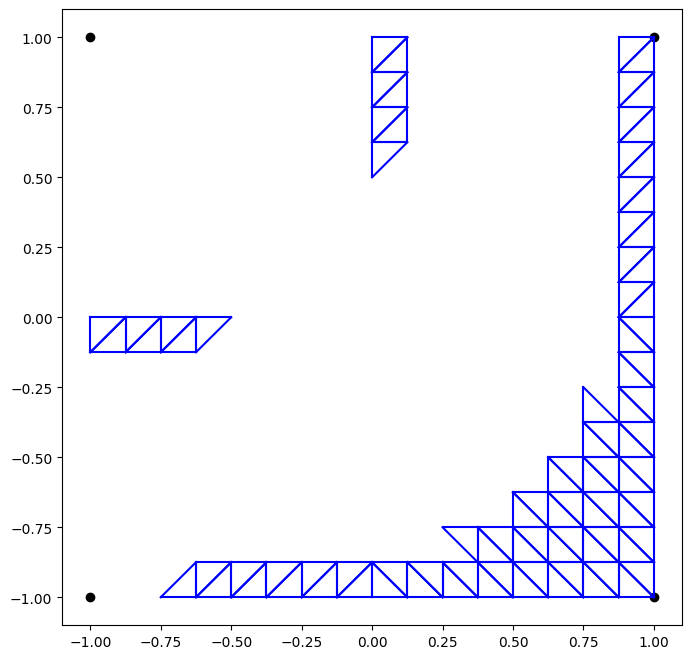

In [ ]:
cut_element_ids = [ t_id for t_id, t in enumerate(pred_phi) if t < 0]

plt.figure(figsize=(8,8))
plt.scatter([1],[1],color='black')
plt.scatter([-1],[1],color='black')
plt.scatter([1],[-1],color='black')
plt.scatter([-1],[-1],color='black')

for t_id in cut_element_ids:
  print(node_label[t_id])
  e_ids = node_label[t_id]
  plt.plot([xy[e_ids[0]-1][0],xy[e_ids[1]-1][0]],[xy[e_ids[0]-1][1],xy[e_ids[1]-1][1]],color='blue')
  plt.plot([xy[e_ids[0]-1][0],xy[e_ids[2]-1][0]],[xy[e_ids[0]-1][1],xy[e_ids[2]-1][1]],color='blue')
  plt.plot([xy[e_ids[1]-1][0],xy[e_ids[2]-1][0]],[xy[e_ids[1]-1][1],xy[e_ids[2]-1][1]],color='blue')

plt.show()


[  4 166 101]
[  6 196  99]
[ 18 133  85]
[ 14 120  91]
[ 12 128  89]
[ 11 124 149]
[ 13 116 209]
[ 60 197 208]
[ 60 196 198]
[ 46 128 207]
[ 37 181  81]
[ 35 206  79]
[ 63 211 209]
[ 41 111 105]
[ 27 109  71]
[ 25 107  69]
[ 62 206 208]
[ 26 211 198]
[ 28 106 115]
[ 34 108 127]
[ 36 110 118]
[ 60 199 196]
[ 60 213 197]
[ 43 212 116]
[  4  97 166]
[  6  70 196]
[ 15  92 113]
[ 11  78 124]
[ 13  80 116]
[ 14 179 120]
[ 12 204 128]
[ 62 204 206]
[ 24  88 151]
[ 26  90 211]
[ 28  72 106]
[ 34  98 108]
[ 36 100 110]
[ 37 169 181]
[ 35 199 206]
[ 63 213 211]
[ 41 135 111]
[ 27 122 109]
[ 25 130 107]
[ 37 101 169]
[ 35  99 199]
[ 63 210 213]
[ 41  85 135]
[ 27  91 122]
[ 25  89 130]
[ 63 209 212]
[ 62 208 205]
[ 26 198  70]
[ 28 115  92]
[ 34 127  78]
[ 36 118  80]
[ 62 207 204]
[ 14  81 179]
[ 12  79 204]
[ 11 149  88]
[ 13 209  90]
[ 1 66 72]
[  3 105  67]
[  7  71 103]
[ 5 74 98]
[ 5 69 74]
[  7 103 100]
[ 60 208 199]
[ 60 198 213]
[169 101 166]
[199  99 196]
[213 210 197]
[135  85 133]
[

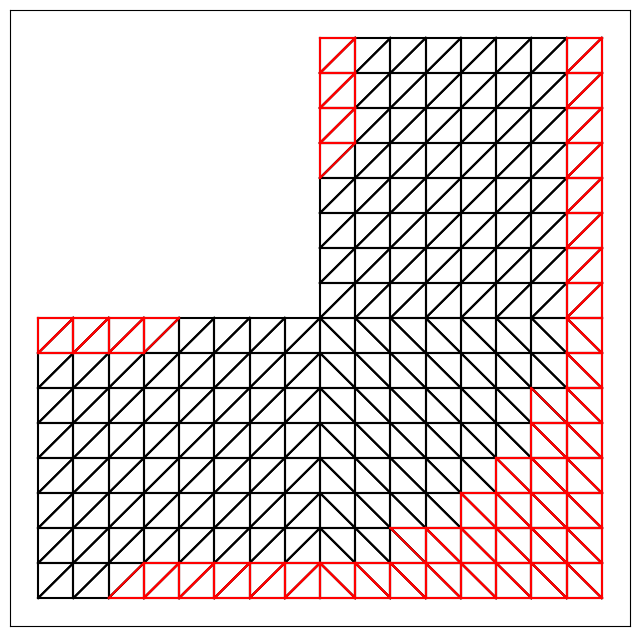

In [ ]:
cut_element_ids = [ t_id for t_id, t in enumerate(pred_phi) if t < 0]

plt.figure(figsize=(8,8))
plt.scatter([1],[1],color='white')
plt.scatter([-1],[1],color='white')
plt.scatter([1],[-1],color='white')
plt.scatter([-1],[-1],color='white')

for t_id in range(len(node_label)):
  e_ids = node_label[t_id]
  plt.plot([xy[e_ids[0]-1][0],xy[e_ids[1]-1][0]],[xy[e_ids[0]-1][1],xy[e_ids[1]-1][1]],color='black')
  plt.plot([xy[e_ids[0]-1][0],xy[e_ids[2]-1][0]],[xy[e_ids[0]-1][1],xy[e_ids[2]-1][1]],color='black')
  plt.plot([xy[e_ids[1]-1][0],xy[e_ids[2]-1][0]],[xy[e_ids[1]-1][1],xy[e_ids[2]-1][1]],color='black')

for t_id in cut_element_ids:
  print(node_label[t_id])
  e_ids = node_label[t_id]
  plt.plot([xy[e_ids[0]-1][0],xy[e_ids[1]-1][0]],[xy[e_ids[0]-1][1],xy[e_ids[1]-1][1]],color='red')
  plt.plot([xy[e_ids[0]-1][0],xy[e_ids[2]-1][0]],[xy[e_ids[0]-1][1],xy[e_ids[2]-1][1]],color='red')
  plt.plot([xy[e_ids[1]-1][0],xy[e_ids[2]-1][0]],[xy[e_ids[1]-1][1],xy[e_ids[2]-1][1]],color='red')
plt.tick_params(bottom=False, left=False, right=False, top=False,labelbottom=False, labelleft=False, labelright=False, labeltop=False)
plt.savefig('QA_optimized.pdf', bbox_inches="tight")
plt.show()


[  4 166 101]
[  6 196  99]
[ 18 133  85]
[ 14 120  91]
[ 12 128  89]
[ 11 124 149]
[ 13 116 209]
[ 60 197 208]
[ 60 196 198]
[ 46 128 207]
[ 37 181  81]
[ 35 206  79]
[ 63 211 209]
[ 41 111 105]
[ 27 109  71]
[ 25 107  69]
[ 62 206 208]
[ 26 211 198]
[ 28 106 115]
[ 34 108 127]
[ 36 110 118]
[ 60 199 196]
[ 60 213 197]
[ 43 212 116]
[  4  97 166]
[  6  70 196]
[ 15  92 113]
[ 11  78 124]
[ 13  80 116]
[ 14 179 120]
[ 12 204 128]
[ 62 204 206]
[ 24  88 151]
[ 26  90 211]
[ 28  72 106]
[ 34  98 108]
[ 36 100 110]
[ 37 169 181]
[ 35 199 206]
[ 63 213 211]
[ 41 135 111]
[ 27 122 109]
[ 25 130 107]
[ 37 101 169]
[ 35  99 199]
[ 63 210 213]
[ 41  85 135]
[ 27  91 122]
[ 25  89 130]
[ 63 209 212]
[ 62 208 205]
[ 26 198  70]
[ 28 115  92]
[ 34 127  78]
[ 36 118  80]
[ 62 207 204]
[ 14  81 179]
[ 12  79 204]
[ 11 149  88]
[ 13 209  90]
[ 1 66 72]
[  3 105  67]
[  7  71 103]
[ 5 74 98]
[ 5 69 74]
[  7 103 100]
[ 60 208 199]
[ 60 198 213]
[169 101 166]
[199  99 196]
[213 210 197]
[135  85 133]
[

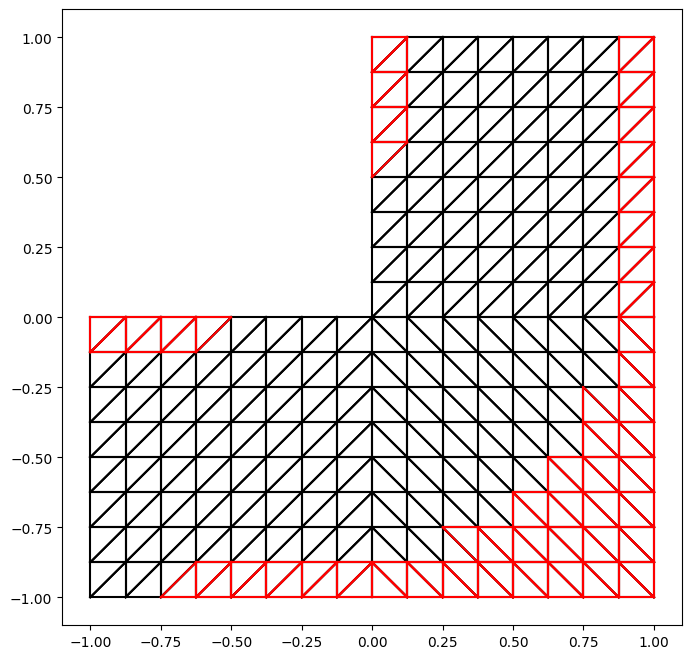

In [ ]:
cut_element_ids = [ t_id for t_id, t in enumerate(pred_phi) if t < 0]

plt.figure(figsize=(8,8))
plt.scatter([1],[1],color='white')
plt.scatter([-1],[1],color='white')
plt.scatter([1],[-1],color='white')
plt.scatter([-1],[-1],color='white')

for t_id in range(len(node_label)):
  e_ids = node_label[t_id]
  plt.plot([xy[e_ids[0]-1][0],xy[e_ids[1]-1][0]],[xy[e_ids[0]-1][1],xy[e_ids[1]-1][1]],color='black')
  plt.plot([xy[e_ids[0]-1][0],xy[e_ids[2]-1][0]],[xy[e_ids[0]-1][1],xy[e_ids[2]-1][1]],color='black')
  plt.plot([xy[e_ids[1]-1][0],xy[e_ids[2]-1][0]],[xy[e_ids[1]-1][1],xy[e_ids[2]-1][1]],color='black')

for t_id in cut_element_ids:
  print(node_label[t_id])
  e_ids = node_label[t_id]
  plt.plot([xy[e_ids[0]-1][0],xy[e_ids[1]-1][0]],[xy[e_ids[0]-1][1],xy[e_ids[1]-1][1]],color='red')
  plt.plot([xy[e_ids[0]-1][0],xy[e_ids[2]-1][0]],[xy[e_ids[0]-1][1],xy[e_ids[2]-1][1]],color='red')
  plt.plot([xy[e_ids[1]-1][0],xy[e_ids[2]-1][0]],[xy[e_ids[1]-1][1],xy[e_ids[2]-1][1]],color='red')

plt.show()
